In [9]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import os
import geopandas as gpd
import seaborn as sns

import statsmodels.api as sm
from shapely.geometry import Point, Polygon

In [2]:
import warnings
warnings.filterwarnings("ignore")

pd.set_option('display.max_columns', None)
pd.set_option('display.float_format', '{:.2f}'.format)

# Day_1 Input the data

In [3]:
gis_africa = gpd.read_file('C:/Users/Admin/Desktop/work for summer intern/AFRICAPOLIS2020.zip')
csv_africa = pd.read_excel('C:\\Users\\Admin\\Desktop\\work for summer intern\\SouthAfrica\\MAPTA_GreenSpaces_UrbanForm.xlsx')

In [4]:
'''due to we have more data in csv_africa than gis_africa, we will check if all the 'Agglomeration_Name' of csv_africa can be found in gis_africa['agglosName']'''

# Check if csv_africa['Agglomeration_Name'] is in gis_africa['agglosName']
isin_result = csv_africa['Agglomeration_Name'].isin(gis_africa['agglosName'])

# Count the number of names not found
not_found_count = (~isin_result).sum()

# Print the result
print(f"There are {not_found_count} 'csv_africa['Agglomeration_Name'] not found in gis_africa['agglosName']")

There are 117 'csv_africa['Agglomeration_Name'] not found in gis_africa['agglosName']


## The study of the difference between the two dataframes

### 01.from the persepective of unique city  for gis_africa and csv_africa

In [5]:
print('for gis_africa file:')
print(f"The total cities: {len(gis_africa)}")
print(f"The unique city: {len(gis_africa[['agglosName', 'ISO3']].drop_duplicates())}")
print(f"The difference:{len(gis_africa) - len(gis_africa[['agglosName', 'ISO3']].drop_duplicates())}")


print('---------------------')
print('for gis_africa file:')
print(f"The total cities: {len(csv_africa)}")
print(f"The unique city: {len(csv_africa[['Agglomeration_Name','ISO3']].drop_duplicates())}")
print(f"The difference:{len(csv_africa) - len(csv_africa[['Agglomeration_Name','ISO3']].drop_duplicates())}")

for gis_africa file:
The total cities: 7720
The unique city: 7622
The difference:98
---------------------
for gis_africa file:
The total cities: 5625
The unique city: 5553
The difference:72


In [6]:
gis_africa[gis_africa.duplicated(subset=['agglosName', 'ISO3'], keep=False)]

,agglosID,agglosName,ISO3,Longitude,Latitude,Pop2015,builtUp,Voronoi,Pop1950,Pop1960,Pop1970,Pop1980,Pop1990,Pop2000,Pop2010,Metropole,geometry
8,6841,No name,NGA,5.39,9.96,23000,3.04,345,0,0,0,0,0,0,26700,No,"POLYGON ((5.37901 9.95118, 5.37960 9.95143, 5...."
9,6842,No name,NGA,11.47,10.92,22500,3.22,1091,0,0,0,0,0,0,0,No,"POLYGON ((11.46667 10.92004, 11.47664 10.91996..."
10,6843,No name,NGA,6.75,5.51,13000,3.92,222,0,0,0,0,0,0,0,No,"POLYGON ((6.74243 5.50702, 6.74241 5.50750, 6...."
209,7615,Sabon Gari,NGA,7.83,8.86,10100,2.57,93,0,0,0,0,0,0,0,No,"POLYGON ((7.80722 8.85790, 7.80685 8.85862, 7...."
214,7622,Sabuwa,NGA,7.12,11.18,17466,1.90,1943,0,0,0,0,0,0,15300,No,"POLYGON ((7.13342 11.18173, 7.13341 11.18144, ..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7476,6364,Mumba,COD,26.97,-7.25,11400,1.74,3782,0,0,0,0,0,0,0,No,"POLYGON ((26.96662 -7.25361, 26.96781 -7.25304..."
7568,6994,Ogori,NGA,6.18,7.45,17390,2.76,137,0,0,0,0,11300,12600,14100,No,"POLYGON ((6.19179 7.45310, 6.19144 7.45305, 6...."
7569,6995,Ogori,NGA,7.81,7.35,11050,2.20,169,0,0,0,0,0,0,0,No,"POLYGON ((7.83424 7.34658, 7.83424 7.34636, 7...."
7587,6999,Oguma,NGA,8.76,9.94,31380,10.42,614,0,0,10000,16600,27600,29400,31400,No,"POLYGON ((8.78402 9.93487, 8.77842 9.93437, 8...."


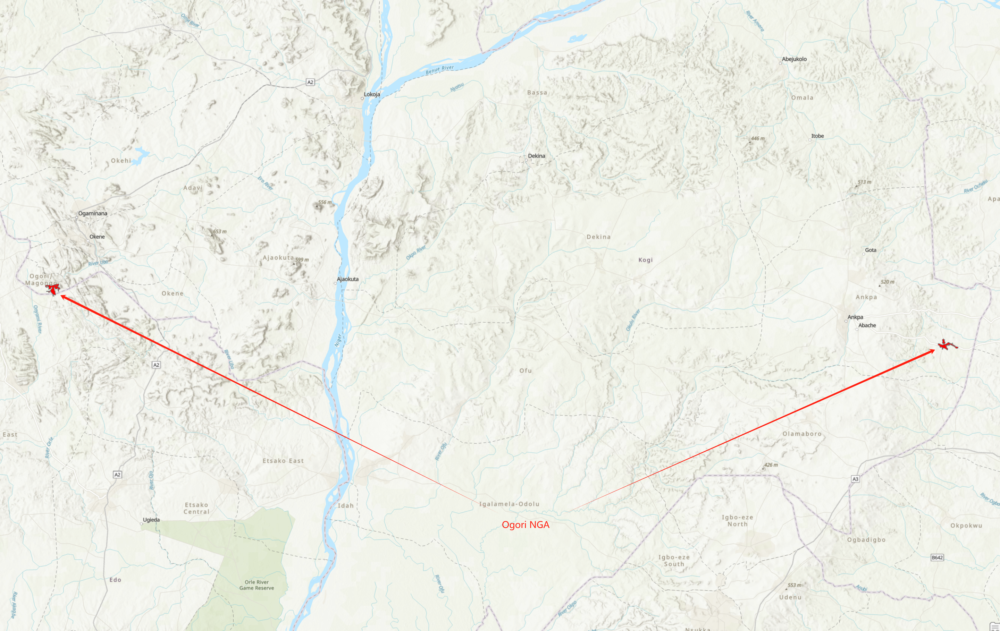

I am worried about the duplicated regions in our selected countries, but fortunately, there is only 2 duplicated cities in our selected countries

In [7]:
# Filter rows where ISO3 is in ['GHA', 'TZA', 'KEN', 'TGO']
filtered_rows = gis_africa[gis_africa['ISO3'].isin(['GHA', 'TZA', 'KEN', 'TGO'])]
# Calculate the number of unique combinations of 'agglosName' and 'ISO3' for the filtered rows
unique_combinations = filtered_rows[['agglosName', 'ISO3']].drop_duplicates()
# Calculate the difference
difference = len(filtered_rows) - len(unique_combinations)

unique_countries = filtered_rows['ISO3'].value_counts()

print(f"The difference in seleted four countries: {len(filtered_rows)}")
print(f"The number of cities in selected four countries: {unique_countries}")
print(f"The difference in seleted four countries: {difference}")

The difference in seleted four countries: 637
The number of cities in selected four countries: ISO3
TZA    249
GHA    209
KEN    126
TGO     53
Name: count, dtype: int64
The difference in seleted four countries: 2


In [8]:
filtered_rows[filtered_rows.duplicated(subset=['agglosName', 'ISO3'], keep=False)]

,agglosID,agglosName,ISO3,Longitude,Latitude,Pop2015,builtUp,Voronoi,Pop1950,Pop1960,Pop1970,Pop1980,Pop1990,Pop2000,Pop2010,Metropole,geometry
806,4096,Isagehe,TZA,32.68,-3.83,14585,5.19,675,0,0,0,0,0,0,13117,No,"POLYGON ((32.66287 -3.84185, 32.66019 -3.84138..."
807,4097,Isagehe,TZA,32.76,-3.92,11518,8.91,1965,0,0,0,0,0,0,10359,No,"POLYGON ((32.76846 -3.90133, 32.76962 -3.90097..."
6757,6157,Mkwajuni,TZA,39.26,-5.92,78049,17.84,361,0,0,0,0,0,18909,27433,No,"POLYGON ((39.28833 -5.86561, 39.28859 -5.86703..."
6758,6158,Mkwajuni,TZA,33.01,-8.44,16595,1.93,7826,0,0,0,0,0,0,14424,No,"POLYGON ((33.00846 -8.44186, 33.00989 -8.44152..."


Isagehe,TZA  
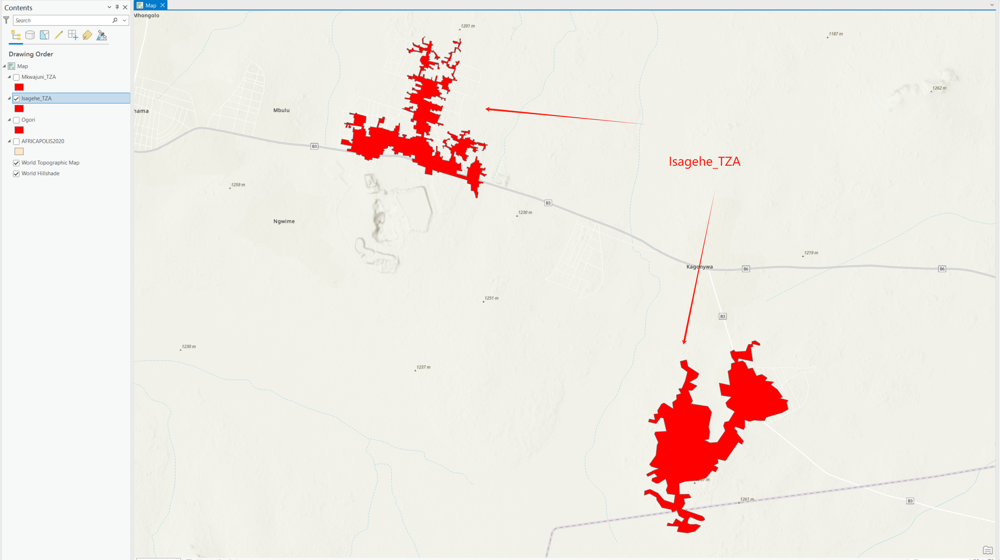

Mkwajuni,TZA  
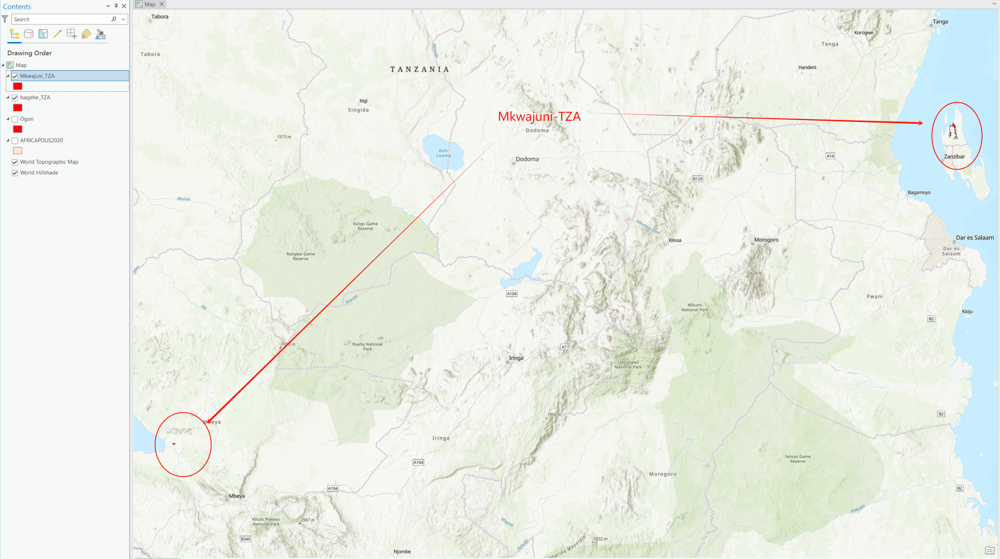

### 02.from the perspective of countries

In [9]:
len(gis_africa['ISO3'].unique())

56

In [10]:
len(csv_africa['ISO3'].unique())

50

In [11]:
gis_iso3 = set(gis_africa['ISO3'].unique())
csv_iso3 = set(csv_africa['ISO3'].unique())

# Find the unique ISO3 values in gis_africa
unique_in_gis = gis_iso3 - csv_iso3

print("In gis_africa but not in csv_africa:", unique_in_gis)

In gis_africa but not in csv_africa: {'TCD', 'MLI', 'MYT', 'LBY', 'SSD', 'REU'}


MLI:  
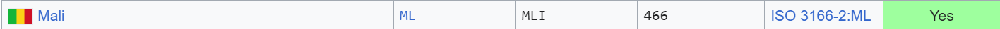

MYT:  
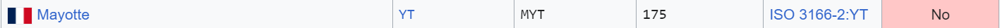

SSD:  
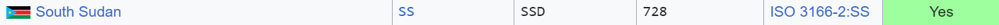

LBY:  
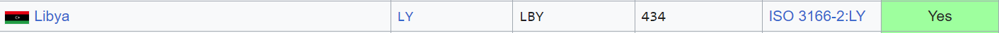

TCD:  
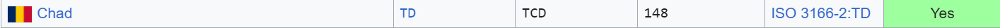

REU:  
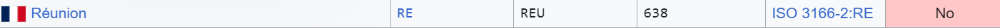

### 03.from the perspective of cities in selected 4 countries

In [12]:
difference = len(gis_africa[gis_africa['ISO3'].isin(['GHA', 'TZA', 'KEN', 'TGO'])]) - len(csv_africa[csv_africa['ISO3'].isin(['GHA', 'TZA', 'KEN', 'TGO'])])

print(f"The number of cities in gis_africa: {len(gis_africa[gis_africa['ISO3'].isin(['GHA', 'TZA', 'KEN', 'TGO'])])}")
print(f"The number of cities in csv_africa: {len(csv_africa[csv_africa['ISO3'].isin(['GHA', 'TZA', 'KEN', 'TGO'])])}")

The number of cities in gis_africa: 637
The number of cities in csv_africa: 569


In [13]:
gis_africa_filtered = gis_africa[gis_africa['ISO3'].isin(['GHA', 'TZA', 'KEN', 'TGO'])]
csv_africa_filtered = csv_africa[csv_africa['ISO3'].isin(['GHA', 'TZA', 'KEN', 'TGO'])]

problematic_rows = gis_africa_filtered.merge(csv_africa_filtered, left_on=['agglosName', 'ISO3'], right_on=['Agglomeration_Name', 'ISO3'], how='left', indicator=True)

problematic_rows = problematic_rows[problematic_rows['_merge'] == 'left_only']
problematic_rows = problematic_rows.drop(columns=['Agglomeration_Name', '_merge'])
problematic_rows

,agglosID_x,agglosName,ISO3,Longitude,Latitude,Pop2015,builtUp,Voronoi,Pop1950,Pop1960,Pop1970,Pop1980,Pop1990,Pop2000,Pop2010,Metropole,geometry,agglosID_y,agroeco_zone,annual_mean_temp,annual_max_temp,annual_precipitation,Population_1950,Population_1960,Population_1970,Population_1980,Population_1990,Population_2000,Population_2010,Population_2015,city_group,dif_elev_m,avg_slope_degree,built_up_area,street_length_avg,street_int_density,NBuildings,MeanBuildingArea,Elongation,Sprawl,Green_space_cover,Green_space_trees_cover,Green_space_shrubland_cover,Green_space_grassland_cover,PM2.5_2020
4,6798,Nkome,TZA,32.13,-2.57,21987,2.50,900,0,0,0,0,0,14214,19205,No,"POLYGON ((32.12636 -2.57201, 32.12664 -2.57204...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,6810,Nkungwe,TZA,29.72,-4.78,46412,10.54,212,0,0,0,0,0,17218,21619,No,"POLYGON ((29.73325 -4.75799, 29.73260 -4.75849...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
15,6743,Niamtougou,TGO,1.11,9.77,13577,23.28,687,0,0,12208,12566,10584,0,13355,No,"POLYGON ((1.09412 9.80277, 1.09624 9.80335, 1....",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
18,6976,Ofoase Kesse,GHA,-1.14,6.17,11857,2.60,817,0,0,0,0,0,0,10531,No,"POLYGON ((-1.13157 6.16770, -1.13227 6.16794, ...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
30,6915,Nyangwa,KEN,37.65,-0.69,10153,1.32,1131,0,0,0,0,0,0,0,No,"POLYGON ((37.63750 -0.68596, 37.63714 -0.68567...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
616,6447,Mwadui Lohumbo,TZA,33.59,-3.53,24237,3.59,625,0,0,0,0,0,22919,21798,No,"POLYGON ((33.57739 -3.51832, 33.57915 -3.51834...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
626,6460,Mwayaya,TZA,29.79,-4.44,58244,23.84,230,0,0,0,0,0,18219,32084,No,"POLYGON ((29.77458 -4.42703, 29.77495 -4.42611...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
630,6403,Muriti,TZA,32.91,-1.95,84809,15.85,6761,0,0,0,0,0,17880,21588,No,"POLYGON ((32.89970 -1.92531, 32.90003 -1.92474...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
632,6392,Mununga,KEN,36.56,-0.67,44455,57.66,161,0,0,0,0,0,0,13948,No,"MULTIPOLYGON (((36.48440 -0.57937, 36.48504 -0...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### 04.from the perspective of population in selected countries

In [14]:
pd.merge(gis_africa[gis_africa['ISO3'].isin(['GHA', 'TZA', 'KEN', 'TGO'])], csv_africa[csv_africa['ISO3'].isin(['GHA', 'TZA', 'KEN', 'TGO'])], left_on='agglosName', right_on='Agglomeration_Name')[['Pop2010']].describe()

,Pop2010
count,570.00
mean,74582.71
std,365010.24
min,0.00
25%,11825.75
50%,18627.00
75%,35667.75
max,4362570.00


In [15]:
matched = pd.merge(gis_africa[gis_africa['ISO3'].isin(['GHA', 'TZA', 'KEN', 'TGO'])], csv_africa[csv_africa['ISO3'].isin(['GHA', 'TZA', 'KEN', 'TGO'])], left_on='agglosName', right_on='Agglomeration_Name')
gis_africa[~gis_africa['agglosName'].isin(matched['agglosName'])][['Pop2010']].describe()

,Pop2010
count,7148.00
mean,52618.03
std,328188.13
min,0.00
25%,10600.00
50%,16200.50
75%,30000.00
max,16179873.00


## Merge the two dataframes

In [16]:
gis_africa_unique = gis_africa.drop_duplicates(subset=['agglosName', 'ISO3'])
csv_africa_unique = csv_africa.drop_duplicates(subset=['Agglomeration_Name', 'ISO3'])

In [17]:
combined_africa = gis_africa_unique.merge(csv_africa_unique, left_on=['agglosName', 'ISO3'], right_on=['Agglomeration_Name', 'ISO3'], how='left')

In [18]:
combined_africa.head(2)

,agglosID_x,agglosName,ISO3,Longitude,Latitude,Pop2015,builtUp,Voronoi,Pop1950,Pop1960,Pop1970,Pop1980,Pop1990,Pop2000,Pop2010,Metropole,geometry,agglosID_y,Agglomeration_Name,agroeco_zone,annual_mean_temp,annual_max_temp,annual_precipitation,Population_1950,Population_1960,Population_1970,Population_1980,Population_1990,Population_2000,Population_2010,Population_2015,city_group,dif_elev_m,avg_slope_degree,built_up_area,street_length_avg,street_int_density,NBuildings,MeanBuildingArea,Elongation,Sprawl,Green_space_cover,Green_space_trees_cover,Green_space_shrubland_cover,Green_space_grassland_cover,PM2.5_2020
0,6848,Norton (West),ZWE,30.66,-17.90,59773,14.44,3485,0,0,0,0,17161,34926,57769,No,"MULTIPOLYGON (((30.66409 -17.91587, 30.66482 -...",6848.00,Norton (West),Tropic - cool / semiarid,18.47,29.18,769.46,0.00,0.00,0.00,0.00,17161.00,34926.45,57768.88,59773.00,IntermediarySmall,48.00,1.89,0.09,118.59,34.89,25431.00,0.00,5.48,0.81,0.20,0.04,0.04,0.12,15.85
1,6849,Notse,TGO,1.17,6.95,58713,12.26,1279,0,0,0,0,13317,21397,47863,No,"POLYGON ((1.15976 6.95734, 1.16033 6.95829, 1....",6849.00,Notse,Tropic - warm / subhumid,26.71,34.11,1157.44,0.00,0.00,0.00,0.00,13317.01,21397.36,47863.00,58713.00,IntermediarySmall,70.00,3.43,0.09,99.60,48.04,21827.00,0.00,5.36,0.66,0.37,0.08,0.23,0.06,29.04


In [19]:
combined_africa.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 7622 entries, 0 to 7621
Data columns (total 46 columns):
 #   Column                       Non-Null Count  Dtype   
---  ------                       --------------  -----   
 0   agglosID_x                   7622 non-null   int64   
 1   agglosName                   7622 non-null   object  
 2   ISO3                         7622 non-null   object  
 3   Longitude                    7622 non-null   float64 
 4   Latitude                     7622 non-null   float64 
 5   Pop2015                      7622 non-null   int64   
 6   builtUp                      7622 non-null   float64 
 7   Voronoi                      7622 non-null   int64   
 8   Pop1950                      7622 non-null   int64   
 9   Pop1960                      7622 non-null   int64   
 10  Pop1970                      7622 non-null   int64   
 11  Pop1980                      7622 non-null   int64   
 12  Pop1990                      7622 non-null   int64   


In [20]:
# combined_africa.to_file('combined_africa.shp')

## Input the data from wikipedia

In [21]:
'''input the code of countries in Africa'''

url = 'https://en.wikipedia.org/wiki/ISO_3166-1'
tables = pd.read_html(url)
# Assuming the first table is the one you want
ISO_code = tables[1]

ISO_code

,English short name (using title case),Alpha-2 code,Alpha-3 code,Numeric code,Link to ISO 3166-2,Independent
0,Afghanistan[b],AF,AFG,4,ISO 3166-2:AF,Yes
1,Åland Islands,AX,ALA,248,ISO 3166-2:AX,No
2,Albania,AL,ALB,8,ISO 3166-2:AL,Yes
3,Algeria,DZ,DZA,12,ISO 3166-2:DZ,Yes
4,American Samoa,AS,ASM,16,ISO 3166-2:AS,No
...,...,...,...,...,...,...
244,Wallis and Futuna,WF,WLF,876,ISO 3166-2:WF,No
245,Western Sahara[b],EH,ESH,732,ISO 3166-2:EH,No
246,Yemen,YE,YEM,887,ISO 3166-2:YE,Yes
247,Zambia,ZM,ZMB,894,ISO 3166-2:ZM,Yes


In [22]:
countries = ['Ghana','Tanzania, United Republic of','Kenya','Togo']
ISO_code[ISO_code['English short name (using title case)'].isin(countries)]

,English short name (using title case),Alpha-2 code,Alpha-3 code,Numeric code,Link to ISO 3166-2,Independent
84,Ghana,GH,GHA,288,ISO 3166-2:GH,Yes
116,Kenya,KE,KEN,404,ISO 3166-2:KE,Yes
219,"Tanzania, United Republic of",TZ,TZA,834,ISO 3166-2:TZ,Yes
222,Togo,TG,TGO,768,ISO 3166-2:TG,Yes


In [23]:
iso_3 = ['GHA','TZA','KEN','TGO']
filtered_combined_africa = combined_africa[combined_africa['ISO3'].isin(iso_3)].reset_index(drop=True)

In [24]:
filtered_combined_africa[['agglosName', 'ISO3']].drop_duplicates()

,agglosName,ISO3
0,Notse,TGO
1,Nkonsia,GHA
2,Nkoranza,GHA
3,Nkenkaasu,GHA
4,Nkome,TZA
...,...,...
630,Onwe,GHA
631,Oloitokitok,KEN
632,Old Debiso,GHA
633,Old Shinyanga,TZA


In [25]:
filtered_combined_africa.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 635 entries, 0 to 634
Data columns (total 46 columns):
 #   Column                       Non-Null Count  Dtype   
---  ------                       --------------  -----   
 0   agglosID_x                   635 non-null    int64   
 1   agglosName                   635 non-null    object  
 2   ISO3                         635 non-null    object  
 3   Longitude                    635 non-null    float64 
 4   Latitude                     635 non-null    float64 
 5   Pop2015                      635 non-null    int64   
 6   builtUp                      635 non-null    float64 
 7   Voronoi                      635 non-null    int64   
 8   Pop1950                      635 non-null    int64   
 9   Pop1960                      635 non-null    int64   
 10  Pop1970                      635 non-null    int64   
 11  Pop1980                      635 non-null    int64   
 12  Pop1990                      635 non-null    int64   
 1

In [26]:
filtered_combined_africa.head(2)

,agglosID_x,agglosName,ISO3,Longitude,Latitude,Pop2015,builtUp,Voronoi,Pop1950,Pop1960,Pop1970,Pop1980,Pop1990,Pop2000,Pop2010,Metropole,geometry,agglosID_y,Agglomeration_Name,agroeco_zone,annual_mean_temp,annual_max_temp,annual_precipitation,Population_1950,Population_1960,Population_1970,Population_1980,Population_1990,Population_2000,Population_2010,Population_2015,city_group,dif_elev_m,avg_slope_degree,built_up_area,street_length_avg,street_int_density,NBuildings,MeanBuildingArea,Elongation,Sprawl,Green_space_cover,Green_space_trees_cover,Green_space_shrubland_cover,Green_space_grassland_cover,PM2.5_2020
0,6849,Notse,TGO,1.17,6.95,58713,12.26,1279,0,0,0,0,13317,21397,47863,No,"POLYGON ((1.15976 6.95734, 1.16033 6.95829, 1....",6849.00,Notse,Tropic - warm / subhumid,26.71,34.11,1157.44,0.00,0.00,0.00,0.00,13317.01,21397.36,47863.00,58713.00,IntermediarySmall,70.00,3.43,0.09,99.60,48.04,21827.00,0.00,5.36,0.66,0.37,0.08,0.23,0.06,29.04
1,6801,Nkonsia,GHA,-2.11,7.69,10775,4.54,240,0,0,0,0,0,0,0,No,"POLYGON ((-2.09552 7.66880, -2.09585 7.66842, ...",6801.00,Nkonsia,Tropic - warm / subhumid,26.46,34.50,1169.98,0.00,0.00,0.00,0.00,0.00,0.00,0.00,10775.00,Small,109.00,3.54,0.10,116.32,30.39,6428.00,0.00,8.30,1.17,0.38,0.08,0.07,0.23,26.76


In [27]:
# filtered_combined_africa.to_file('filtered_combined_africa.shp')

## Input the buildings data

In [28]:
folder_path = r'C:\Users\Admin\Desktop\work for summer intern\building'

buildings_list = []

for filename in os.listdir(folder_path):
    if filename.endswith('.csv'):
        file_path = os.path.join(folder_path, filename)
        df = pd.read_csv(file_path)
        buildings_list.append(df)

combined_buildings = pd.concat(buildings_list, ignore_index=True)

In [29]:
combined_buildings

,latitude,longitude,area_in_meters,confidence,geometry,full_plus_code
0,5.54,-0.42,30.97,0.82,"POLYGON((-0.416670371545615 5.53877416128653, ...",6CQXGHQM+G838
1,6.74,-3.49,91.19,0.83,"POLYGON((-3.49142125611363 6.74180541539105, -...",6CRRPGR5+PC64
2,5.69,-0.37,9.31,0.70,"POLYGON((-0.367694510319316 5.69058858463016, ...",6CQXMJRJ+6WV3
3,5.47,-4.05,252.15,0.92,"POLYGON((-4.04596726375824 5.46676883716086, -...",6CQQFX83+MHPJ
4,9.48,-0.02,143.15,0.91,"POLYGON((-0.0159753248061527 9.47956003657873,...",6CXXFXHM+RHPM
...,...,...,...,...,...,...
98595356,-2.60,33.89,14.83,0.73,"POLYGON((33.8892186569379 -2.6004880806509, 33...",6G9M9VXQ+RM87
98595357,-2.62,29.83,115.83,0.83,"POLYGON((29.8297011606214 -2.62115257981701, 2...",6G9F9RHH+GVR7
98595358,-1.46,30.87,6.34,0.66,"POLYGON((30.8746316193879 -1.45733246071221, 3...",6GCGGVVF+3RH5
98595359,-2.46,32.92,5.84,0.71,"POLYGON((32.9217306312264 -2.46081528501069, 3...",6G9JGWQC+MMHR


In [30]:
from shapely.wkt import loads
combined_buildings['geometry'] = combined_buildings['geometry'].apply(loads)

geo_combined_buildings = gpd.GeoDataFrame(combined_buildings, geometry='geometry')
geo_combined_buildings.set_crs(epsg=4326, inplace=True)

,latitude,longitude,area_in_meters,confidence,geometry,full_plus_code
0,5.54,-0.42,30.97,0.82,"POLYGON ((-0.41667 5.53877, -0.41672 5.53879, ...",6CQXGHQM+G838
1,6.74,-3.49,91.19,0.83,"POLYGON ((-3.49142 6.74181, -3.49154 6.74181, ...",6CRRPGR5+PC64
2,5.69,-0.37,9.31,0.70,"POLYGON ((-0.36769 5.69059, -0.36770 5.69061, ...",6CQXMJRJ+6WV3
3,5.47,-4.05,252.15,0.92,"POLYGON ((-4.04597 5.46677, -4.04615 5.46678, ...",6CQQFX83+MHPJ
4,9.48,-0.02,143.15,0.91,"POLYGON ((-0.01598 9.47956, -0.01599 9.47965, ...",6CXXFXHM+RHPM
...,...,...,...,...,...,...
98595356,-2.60,33.89,14.83,0.73,"POLYGON ((33.88922 -2.60049, 33.88922 -2.60045...",6G9M9VXQ+RM87
98595357,-2.62,29.83,115.83,0.83,"POLYGON ((29.82970 -2.62115, 29.82966 -2.62108...",6G9F9RHH+GVR7
98595358,-1.46,30.87,6.34,0.66,"POLYGON ((30.87463 -1.45733, 30.87463 -1.45731...",6GCGGVVF+3RH5
98595359,-2.46,32.92,5.84,0.71,"POLYGON ((32.92173 -2.46082, 32.92173 -2.46079...",6G9JGWQC+MMHR


In [31]:
geo_combined_buildings.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 98595361 entries, 0 to 98595360
Data columns (total 6 columns):
 #   Column          Dtype   
---  ------          -----   
 0   latitude        float64 
 1   longitude       float64 
 2   area_in_meters  float64 
 3   confidence      float64 
 4   geometry        geometry
 5   full_plus_code  object  
dtypes: float64(4), geometry(1), object(1)
memory usage: 4.4+ GB


In [32]:
# from shapely.geometry import Point
# geometry = [Point(xy) for xy in zip(combined_buildings['longitude'], combined_buildings['latitude'])]
# combined_buildings = gpd.GeoDataFrame(combined_buildings, geometry=geometry)
# combined_buildings.set_crs(epsg=4326, inplace=True)

## Filited buildings in these selected countries

In [33]:
filtered_combined_buildings = gpd.sjoin(geo_combined_buildings, filtered_combined_africa, op='within')

In [34]:
filtered_combined_buildings.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [35]:
# filtered_combined_buildings.to_file('filtered_combined_buildings.shp')

In [36]:
# filtered_combined_buildings.to_csv('filtered_combined_buildings.csv')

In [37]:
filtered_combined_africa['ISO3'].unique()

array(['TGO', 'GHA', 'TZA', 'KEN'], dtype=object)

## Export the results by countries

In [38]:
filtered_combined_africa[filtered_combined_africa['ISO3'] == 'TGO'].shape

(53, 46)

In [39]:
filtered_combined_africa[filtered_combined_africa['ISO3'] == 'GHA'].shape

(209, 46)

In [40]:
filtered_combined_africa[filtered_combined_africa['ISO3'] == 'TZA'].shape

(247, 46)

In [41]:
filtered_combined_africa[filtered_combined_africa['ISO3'] == 'KEN'].shape

(126, 46)

In [42]:
filtered_combined_africa_TGO = filtered_combined_africa[filtered_combined_africa['ISO3'] == 'TGO'].reset_index(drop=True)
filtered_combined_africa_GHA = filtered_combined_africa[filtered_combined_africa['ISO3'] == 'GHA'].reset_index(drop=True)
filtered_combined_africa_TZA = filtered_combined_africa[filtered_combined_africa['ISO3'] == 'TZA'].reset_index(drop=True)
filtered_combined_africa_KEN = filtered_combined_africa[filtered_combined_africa['ISO3'] == 'KEN'].reset_index(drop=True)

In [43]:
filtered_combined_buildings_TGO = gpd.sjoin(geo_combined_buildings, filtered_combined_africa_TGO, op='within')
filtered_combined_buildings_GHA = gpd.sjoin(geo_combined_buildings, filtered_combined_africa_GHA, op='within')
filtered_combined_buildings_TZA = gpd.sjoin(geo_combined_buildings, filtered_combined_africa_TZA, op='within')
filtered_combined_buildings_KEN = gpd.sjoin(geo_combined_buildings, filtered_combined_africa_KEN, op='within')

In [44]:
# filtered_combined_buildings_TGO.to_csv('filtered_combined_buildings_TGO.csv')
# filtered_combined_buildings_GHA.to_csv('filtered_combined_buildings_GHA.csv')
# filtered_combined_buildings_TZA.to_csv('filtered_combined_buildings_TZA.csv')
# filtered_combined_buildings_KEN.to_csv('filtered_combined_buildings_KEN.csv')

In [45]:
geo_combined_buildings

,latitude,longitude,area_in_meters,confidence,geometry,full_plus_code
0,5.54,-0.42,30.97,0.82,"POLYGON ((-0.41667 5.53877, -0.41672 5.53879, ...",6CQXGHQM+G838
1,6.74,-3.49,91.19,0.83,"POLYGON ((-3.49142 6.74181, -3.49154 6.74181, ...",6CRRPGR5+PC64
2,5.69,-0.37,9.31,0.70,"POLYGON ((-0.36769 5.69059, -0.36770 5.69061, ...",6CQXMJRJ+6WV3
3,5.47,-4.05,252.15,0.92,"POLYGON ((-4.04597 5.46677, -4.04615 5.46678, ...",6CQQFX83+MHPJ
4,9.48,-0.02,143.15,0.91,"POLYGON ((-0.01598 9.47956, -0.01599 9.47965, ...",6CXXFXHM+RHPM
...,...,...,...,...,...,...
98595356,-2.60,33.89,14.83,0.73,"POLYGON ((33.88922 -2.60049, 33.88922 -2.60045...",6G9M9VXQ+RM87
98595357,-2.62,29.83,115.83,0.83,"POLYGON ((29.82970 -2.62115, 29.82966 -2.62108...",6G9F9RHH+GVR7
98595358,-1.46,30.87,6.34,0.66,"POLYGON ((30.87463 -1.45733, 30.87463 -1.45731...",6GCGGVVF+3RH5
98595359,-2.46,32.92,5.84,0.71,"POLYGON ((32.92173 -2.46082, 32.92173 -2.46079...",6G9JGWQC+MMHR


In [46]:
print(f"The number of buildings in Togo: {len(filtered_combined_buildings_TGO)}")
print(f"The number of buildings in Ghana: {len(filtered_combined_buildings_GHA)}")
print(f"The number of buildings in Tanzania: {len(filtered_combined_buildings_TZA)}")
print(f"The number of buildings in Kenya: {len(filtered_combined_buildings_KEN)}")


print('---------------------------------------------------------------')
print(f"The number of buildings in Total: {len(filtered_combined_buildings_TGO) + len(filtered_combined_buildings_GHA) + len(filtered_combined_buildings_TZA) + len(filtered_combined_buildings_KEN)}")

The number of buildings in Togo: 1753128
The number of buildings in Ghana: 5976591
The number of buildings in Tanzania: 7082687
The number of buildings in Kenya: 14298014
---------------------------------------------------------------
The number of buildings in Total: 29110420


In [47]:
filtered_combined_buildings_TGO['agglosName'].unique()

array(['Kpalime', 'Lama-Bou', 'Dzrekpo', 'Lome/Aflao [TGO]', 'Kaboli',
       'Tsevie', 'Atakpame', 'Ketao', 'Datcha', 'Adjengre', 'Sokode',
       'Aneho/Hilacondji [TGO]', 'Ahepe', 'Niamtougou', 'Hahotoe', 'Glei',
       'Adeta', 'Kande', 'Tchamba', 'Kara', 'Notse', 'Badou', 'Wahala',
       'Bassar', 'Bafilo', 'Kouve', 'Mango', 'Tabligbo', 'Vogan',
       'Pagala-Gare', 'Afagnagan', 'Assahoun', 'Blitta', 'Anie', 'Kabou',
       'Asrama', 'Tado', 'Sotouboua', 'Aklakou', 'Kpekpleme', 'Anfoin',
       'Gboto', 'Tohoun', 'Tchekpo-Dedekpoe', 'Guerin Kouka', 'Kpele-Ele',
       'Issati', 'Togoville', 'Attitogon', 'Glidji'], dtype=object)

In [48]:
filtered_combined_buildings_GHA['agglosName'].unique()

array(['Accra', 'Cape Coast', 'Begoro', 'Sunyani', 'Techiman', 'Tamale',
       'Mankesim', 'Koforidua', 'Tepa', 'Parambo', 'Dormaa Ahenkro',
       'Kumasi', 'Akim Achiase', 'Yegyi', 'Chiraa', 'Juaso (reg.Ashanti)',
       'Asesewa', 'Nyinahin', 'Wa', 'Nkoranza', 'Obuasi', 'Akim Manso',
       'Kibi', 'Jumapo', 'Offinso', 'Bogoso', 'Nkonsia', 'Suhum',
       'Akim Asene', 'Tarkwa', 'Drobo', 'Sampa', 'Adeiso', 'Ejura',
       'Sefwi Wiawso', 'Abura Dunkwa', 'Agogo', 'Jirapa', 'Kintampo',
       'New Tafo', 'Asamankese', 'Gushiegu', 'Akim Akroso', 'Atebubu',
       'Maame Krobo', 'Nsuatre', 'Bibiani', 'Aburi', 'Nkawkaw',
       'Adoagyiri', 'Wulensi', 'New Ebiduase', 'Akropong', 'Effiduase',
       'Breman Brakwa', 'Sankore', 'Senya Bereku', 'Winneba', 'Konongo',
       'Assin Foso', 'Prestea', 'Karaga', 'Damongo', 'Savelugu',
       'Akim Swedru', 'Berekum', 'Mampong', 'Agona Swedru', 'Wenchi',
       'Wamfie', 'Yendi', 'Half Assini', 'Assin Bereku', 'Nalerigu',
       'Nkrankwanta', '

In [49]:
filtered_combined_buildings_TZA['agglosName'].unique()

array(['Mbomai', 'Esilalei', 'Arusha', 'Masama', 'Mirerani', 'Moshi',
       'Sirari', 'Himo', 'Monduli', 'Matongo', 'Mugumu Mjini', 'Magugu',
       'Mbulu Mjini', 'Barabarani', 'Karatu', 'Hai Mjini', 'Mwanga',
       'Mateves', 'Mbuguni', 'Ifakara', 'Dar es Salaam', 'Mafinga',
       'Korogwe', 'Mlandizi', 'Nyangugulu', 'Dodoma', 'Muheza',
       'Morogoro', 'Kidodi', 'Iringa', 'Kibaya', 'Zanzibar', 'Mvomero',
       'Manolo', 'Singida', 'Gairo', 'Kimamba', 'Igowole', 'Malindi',
       'Tanga', 'Chanika', 'Dumila', 'Konde', 'Babati', 'Lushoto',
       'Mtumba', 'Hedaru', 'Mpwapwa', 'Same Mjini', 'Kidatu', 'Magomeni',
       'Kondoa Mjini', 'Mhonda', 'Kengeja', 'Mwangoi', 'Nungwi',
       'Manyoni', 'Wete', 'Kibaigwa', 'Pongwe ? Mixed Ward',
       'Chake Chake', 'Mkwajuni', 'Mikese', 'Kongwa', 'Katesh', 'Mtibwa',
       'Bagamoyo (Pwani)', 'Kibiti', 'Mkuranga', 'Chalinze', 'Mikumi',
       'Maramba', 'Mungaa', 'Mvumi Mission', 'Ndungu', 'Mkata',
       'Mlandege', 'Kilosa', "Mang'ula

In [50]:
filtered_combined_buildings_KEN['agglosName'].unique()

array(['Kisumu', 'Eldoret', 'Nanyuky', 'Ndubenet (Ug)', 'Nyahururu',
       'Ethi', 'Isiolo', 'Maua', 'Kaplelach', 'Umande', 'Kitale', 'Meru',
       'Kapenguria', 'Marsabit', 'Maralal', 'Kabarnet', "Moi's Bridge",
       'Lodwar', 'Iten', 'Ndunyu', 'Kakuma', 'Subokia', 'Moyale [KEN]',
       'Eldama Ravine', 'Kesses', 'Wagalla', 'Mogoto', 'Malindi',
       'Gongoni', 'Lamu', 'Hola', 'Welmerer', 'Kibuyu', 'Kipkelion',
       'Njabini', 'Nairobi', 'Runyenjes', 'Bomet', 'Kisii', 'Embu',
       'Machakos', 'Karagatha', 'Kamburaini', 'Kikima', 'Migori',
       'Nakuru', 'Kawaida', 'Naivasha', 'Kehancha', 'Kericho',
       'Murugi (Smeru)', 'Kajiado', 'Wundyani', 'Elburgon', 'Thika',
       'Athi River', 'Ndunyu Njeru', 'Narok', 'Kitui', 'Oloitokitok',
       'Ki Li Fi', 'Mau Narok', 'Kahuru/Muruaki', 'Gatukuyu', 'Mununga',
       'Sokoni(Nakuru)', 'Tala/Kangundo', 'Mitunguu', 'Njoro (Nakuru)',
       'Magutuni', 'Namanga', 'Makindu', 'Rurii', 'Garissa', 'Chuka',
       'Silibwet(Nyanda)', 

In [51]:
import os
import re

def sanitize_filename(filename):
    return re.sub(r'[^a-zA-Z0-9 ]', '', filename)

def export_shapefiles_by_group(gdf, group_column, output_dir):
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
    
    for group_name, group_df in gdf.groupby(group_column):
        sanitized_group_name = sanitize_filename(group_name)
        group_output_dir = os.path.join(output_dir, sanitized_group_name)
        
        if not os.path.exists(group_output_dir):
            os.makedirs(group_output_dir)
        
        output_path = os.path.join(group_output_dir, f"{sanitized_group_name}.shp")
        group_df.to_file(output_path)

In [52]:
# output_directory = r'C:\Users\Admin\Desktop\work for summer intern\TGO_buildings'
# export_shapefiles_by_group(filtered_combined_buildings_TGO, 'agglosName', output_directory)

In [53]:
# output_directory = r'C:\Users\Admin\Desktop\work for summer intern\GHA_buildings'
# export_shapefiles_by_group(filtered_combined_buildings_GHA, 'agglosName', output_directory)

In [54]:
# output_directory = r'C:\Users\Admin\Desktop\work for summer intern\TZA_buildings'
# export_shapefiles_by_group(filtered_combined_buildings_TZA, 'agglosName', output_directory)

In [55]:
# output_directory = r'C:\Users\Admin\Desktop\work for summer intern\KEN_buildings'
# export_shapefiles_by_group(filtered_combined_buildings_KEN, 'agglosName', output_directory)

In [56]:
filtered_combined_buildings_TGO['agglosName'].value_counts().sort_values(ascending=False)

agglosName
Lome/Aflao [TGO]          930460
Tsevie                    158675
Kara                       96203
Sokode                     58511
Atakpame                   55846
Kpalime                    55607
Notse                      22080
Anie                       20990
Bassar                     18467
Niamtougou                 16740
Sotouboua                  15015
Mango                      14975
Ahepe                      14310
Tchamba                    14259
Adeta                      14175
Tabligbo                   13549
Hahotoe                    13299
Aneho/Hilacondji [TGO]     11978
Vogan                      11793
Ketao                      10948
Assahoun                   10684
Bafilo                     10415
Glei                       10402
Lama-Bou                   10305
Adjengre                   10288
Afagnagan                   9777
Blitta                      9741
Kouve                       8849
Pagala-Gare                 8085
Kabou                       6593

In [57]:
filtered_combined_buildings_GHA['agglosName'].value_counts().sort_values(ascending=False)

agglosName
Accra            2531627
Kumasi            863615
Tamale            216741
Takoradi          126945
Sunyani            95475
                  ...   
Banda               2255
Breman Odoben       2254
Nsawkaw             1955
Agona Nsaba         1853
Mpohor              1822
Name: count, Length: 202, dtype: int64

In [58]:
filtered_combined_buildings_TZA['agglosName'].value_counts().sort_values(ascending=False)

agglosName
Dar es Salaam     1969085
Arusha             492171
Mwanza             368514
Zanzibar           275613
Mbomai             255809
                   ...   
Mihambwe             1928
Kiwalala             1892
Mwadui Lohumbo       1878
Buganguzi            1712
Mkoreha              1538
Name: count, Length: 234, dtype: int64

In [59]:
filtered_combined_buildings_KEN['agglosName'].value_counts().sort_values(ascending=False)

agglosName
Kisumu         2647946
Kisii          2392548
Nairobi        2002539
Embu           1557585
Bomet           597972
                ...   
Sega(Kwale)       2278
Bissil            2186
Nyangwa           2047
Kibuyu            1203
Wagalla            978
Name: count, Length: 112, dtype: int64

# Week_2 Input the data and output the density map

In [60]:
Mombasa_shp = gpd.read_file('C:/Users/Admin/Desktop/work for summer intern/KEN_buildings/Mombasa/Mombasa.shp')

In [61]:
Mombasa_shp.info()
Mombasa_shp.head(2)

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 335672 entries, 0 to 335671
Data columns (total 52 columns):
 #   Column      Non-Null Count   Dtype   
---  ------      --------------   -----   
 0   latitude    335672 non-null  float64 
 1   longitude   335672 non-null  float64 
 2   area_in_me  335672 non-null  float64 
 3   confidence  335672 non-null  float64 
 4   full_plus_  335672 non-null  object  
 5   index_righ  335672 non-null  int64   
 6   agglosID_x  335672 non-null  int64   
 7   agglosName  335672 non-null  object  
 8   ISO3        335672 non-null  object  
 9   Longitud_1  335672 non-null  float64 
 10  Latitude_1  335672 non-null  float64 
 11  Pop2015     335672 non-null  int64   
 12  builtUp     335672 non-null  float64 
 13  Voronoi     335672 non-null  int64   
 14  Pop1950     335672 non-null  int64   
 15  Pop1960     335672 non-null  int64   
 16  Pop1970     335672 non-null  int64   
 17  Pop1980     335672 non-null  int64   
 18  Pop1990     3356

,latitude,longitude,area_in_me,confidence,full_plus_,index_righ,agglosID_x,agglosName,ISO3,Longitud_1,Latitude_1,Pop2015,builtUp,Voronoi,Pop1950,Pop1960,Pop1970,Pop1980,Pop1990,Pop2000,Pop2010,Metropole,agglosID_y,Agglomerat,agroeco_zo,annual_mea,annual_max,annual_pre,Population,Populati_1,Populati_2,Populati_3,Populati_4,Populati_5,Populati_6,Populati_7,city_group,dif_elev_m,avg_slope_,built_up_a,street_len,street_int,NBuildings,MeanBuildi,Elongation,Sprawl,Green_spac,Green_sp_1,Green_sp_2,Green_sp_3,PM2.5_2020,geometry
0,-3.89,39.76,21.86,0.75,6G8X4Q64+CM6P,98,6212,Mombasa,KEN,39.69,-4.00,1257654,156.19,534,94343,161308,254352,350570,477164,711002,1013838,Yes,6212.00,Mombasa,Tropic - warm / subhumid,26.12,32.54,1086.17,94342.79,161308.17,254352.42,350570.08,477164.20,711001.79,1013837.58,1257654.00,Large,123.00,2.96,0.15,103.41,30.85,332878.00,0.00,7.11,0.70,0.51,0.31,0.07,0.13,16.24,"POLYGON ((39.75668 -3.88897, 39.75663 -3.88899..."
1,-3.89,39.77,110.93,0.80,6G8X4Q48+VCF9,98,6212,Mombasa,KEN,39.69,-4.00,1257654,156.19,534,94343,161308,254352,350570,477164,711002,1013838,Yes,6212.00,Mombasa,Tropic - warm / subhumid,26.12,32.54,1086.17,94342.79,161308.17,254352.42,350570.08,477164.20,711001.79,1013837.58,1257654.00,Large,123.00,2.96,0.15,103.41,30.85,332878.00,0.00,7.11,0.70,0.51,0.31,0.07,0.13,16.24,"POLYGON ((39.76612 -3.89279, 39.76609 -3.89288..."


In [62]:
Mombasa_shp.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

<Axes: >

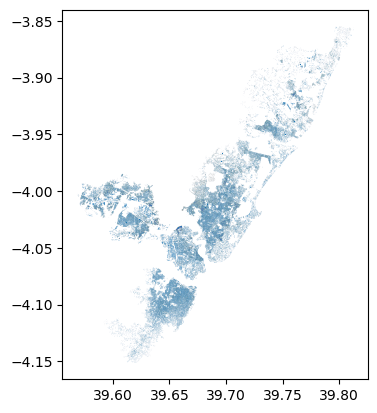

In [63]:
Mombasa_shp.plot()

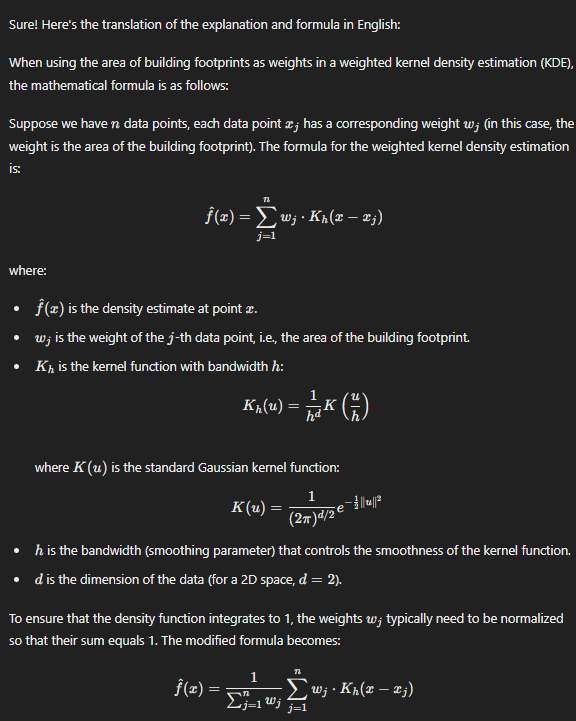  
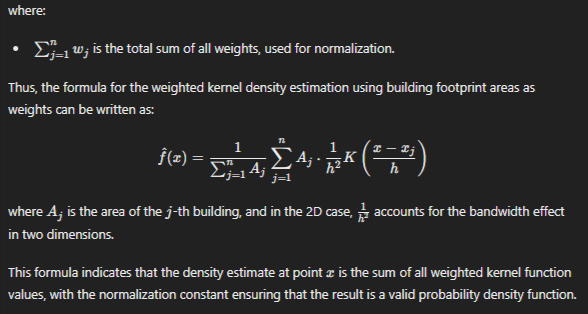

In [64]:
from scipy.stats import gaussian_kde
from mpl_toolkits.mplot3d import Axes3D

# Calculate the point density
Mombasa_shp['centroid'] = Mombasa_shp.centroid
centroids = np.array(list(zip(Mombasa_shp.centroid.x, Mombasa_shp.centroid.y)))

# Create a grid of points
Mombasa_shp = Mombasa_shp.to_crs(epsg=3857)
Mombasa_shp['area'] = Mombasa_shp.area
Mombasa_shp = Mombasa_shp.to_crs(epsg=4326)
weights = Mombasa_shp['area'].values

# Calculate the point density
kde = gaussian_kde(centroids.T, weights=weights, bw_method=0.05)

# Create a grid of points
x_min, y_min, x_max, y_max = Mombasa_shp.total_bounds
x, y = np.mgrid[x_min:x_max:100j, y_min:y_max:100j]
positions = np.vstack([x.ravel(), y.ravel()])

# Evaluate the KDE on the grid
kde_values = np.reshape(kde(positions).T, x.shape)

In [65]:
kde_values.shape

(100, 100)

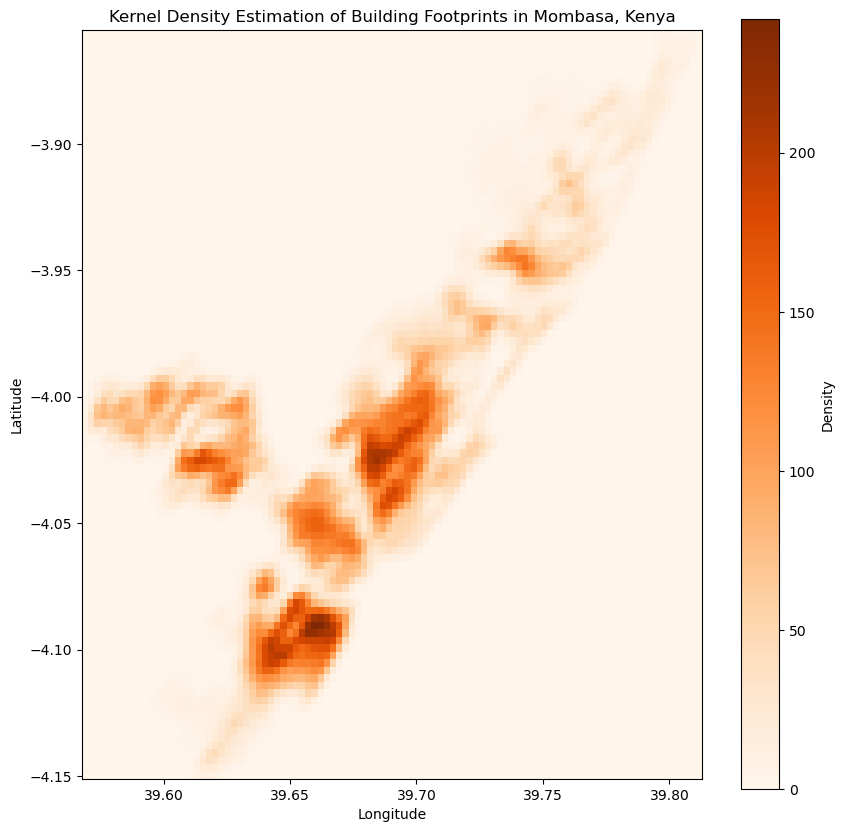

In [66]:
# Plot the results
plt.figure(figsize=(10, 10))
plt.imshow(np.rot90(kde_values), cmap=plt.cm.Oranges, extent=[x_min, x_max, y_min, y_max])
plt.colorbar(label='Density')
plt.title('Kernel Density Estimation of Building Footprints in Mombasa, Kenya')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()

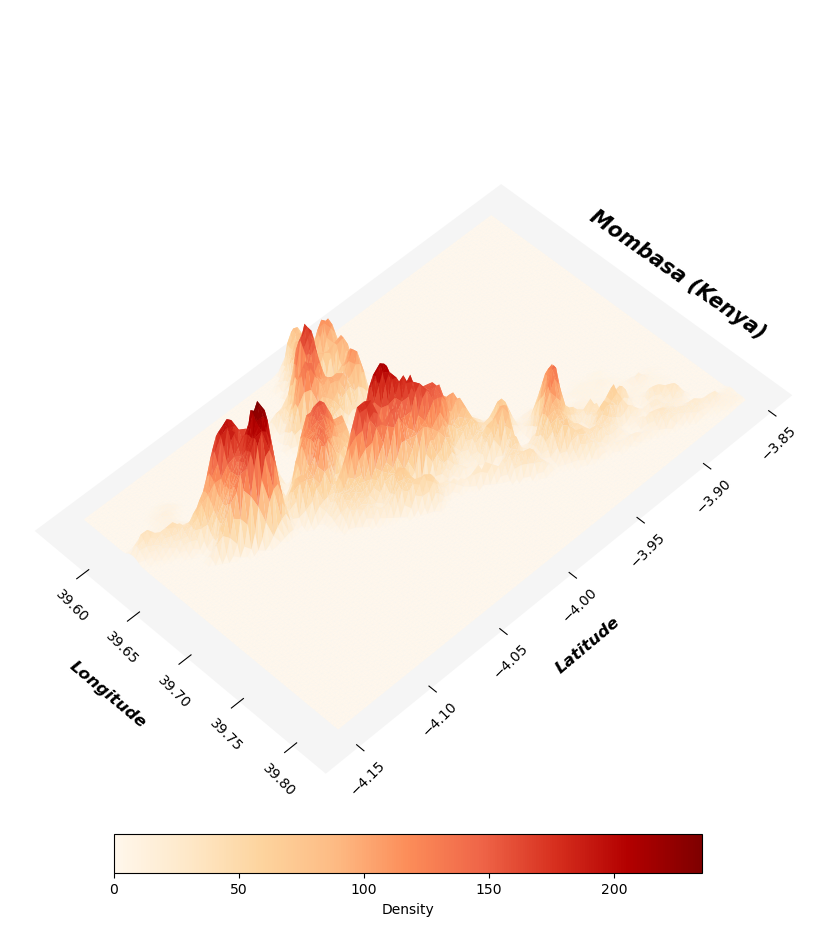

In [67]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(15, 10))
ax = fig.add_subplot(111, projection='3d')

# Create the surface plot
x_flat = x.ravel()
y_flat = y.ravel()
z_flat = kde_values.ravel()
surf = ax.plot_trisurf(x_flat, y_flat, z_flat, cmap=plt.cm.OrRd, linewidth=0)

# Adjust the view angle for a more top-down perspective
ax.view_init(elev=50, azim=315)

# Add labels and title
# ax.set_title('Mombasa(Kenya)')
# ax.set_xlabel('Longitude')
# ax.set_ylabel('Latitude')
# ax.set_zlabel('Density')

'''Hiding the axes'''
# Hide the z-axis
ax.zaxis.set_ticks([])

# Hide the grid lines
ax.grid(False) 

# Hide the panes (background)
ax.xaxis.pane.fill = False  # Hide the x-axis pane
ax.yaxis.pane.fill = False  # Hide the y-axis pane
# ax.zaxis.pane.fill = False  # Hide the z-axis pane

# Hide the panes (background)
ax.xaxis.pane.set_edgecolor('none')
ax.yaxis.pane.set_edgecolor('none')
ax.zaxis.pane.set_edgecolor('none')

# # Hide the axis lines by setting their color and width
# for spine in ax.spines.values():
#     spine.set_color('none')  # Hide the axis line by setting the color to 'none'
#     spine.set_linewidth(0)   # Set the width to 0 to hide the axis line
    
# # Hide the axis lines
ax.xaxis.line.set_color('none')  # Hide the x-axis line
ax.yaxis.line.set_color('none')  # Hide the y-axis line
ax.zaxis.line.set_color('none')  # Hide the z-axis line

# Hide the x and y axis ticks
ax.tick_params(axis='x', which='both', bottom=True, top=False, labelbottom=True, length=0.01, pad=0, rotation=-45)
ax.tick_params(axis='y', which='both', left=True, right=False, labelleft=True, length=0.01, pad=0, rotation=45)

'''Finished the hiding axes'''

# Adjust aspect ratio to make the plot non-square
ax.set_box_aspect([1, 1.6, 0.5])  # Aspect ratio is 1:2 for x:y

fig.text(0.68, 0.72, 'Mombasa (Kenya)', ha='center', va='center', rotation=-35, fontsize=15, color='Black', style='italic', weight='bold')
fig.text(0.3, 0.3, 'Longitude', ha='center', va='center', rotation=-40, fontsize=12, color='Black', style='italic', weight='bold')
fig.text(0.62, 0.35, 'Latitude', ha='center', va='center', rotation=40, fontsize=12, color='Black', style='italic', weight='bold')

# Add color bar which maps values to colors
fig.colorbar(surf, ax=ax, shrink=0.4, aspect=15, location='bottom', pad=0.03, label='Density')

# Tight layout to make the plot compact
plt.tight_layout()

plt.show()

# Week_2_2 Run the loop to output the final density maps

In [3]:
import os
import geopandas as gpd
import numpy as np
from scipy.stats import gaussian_kde
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Define the input directory and output directory
input_directory = 'C:/Users/Admin/Desktop/work for summer intern/TGO_buildings'
output_directory = 'C:/Users/Admin/Desktop/work for summer intern/TGO_map'

# Ensure the output directory exists
if not os.path.exists(output_directory):
    os.makedirs(output_directory)

# Iterate through each subfolder in the input directory
for subfolder_name in os.listdir(input_directory):
    subfolder_path = os.path.join(input_directory, subfolder_name)
    if os.path.isdir(subfolder_path):
        # Find the .shp file in the subfolder
        for file_name in os.listdir(subfolder_path):
            if file_name.endswith('.shp'):
                shp_file_path = os.path.join(subfolder_path, file_name)
                
                # Read the shapefile
                Mombasa_shp = gpd.read_file(shp_file_path)
                
                # Calculate the point density
                Mombasa_shp['centroid'] = Mombasa_shp.centroid
                centroids = np.array(list(zip(Mombasa_shp.centroid.x, Mombasa_shp.centroid.y)))
                
                # Create a grid of points
                Mombasa_shp = Mombasa_shp.to_crs(epsg=3857)
                Mombasa_shp['area'] = Mombasa_shp.area
                Mombasa_shp = Mombasa_shp.to_crs(epsg=4326)
                weights = Mombasa_shp['area'].values
                
                # Calculate the point density
                kde = gaussian_kde(centroids.T, weights=weights, bw_method=0.05)
                
                # Create a grid of points
                x_min, y_min, x_max, y_max = Mombasa_shp.total_bounds
                x, y = np.mgrid[x_min:x_max:100j, y_min:y_max:100j]
                positions = np.vstack([x.ravel(), y.ravel()])
                
                # Evaluate the KDE on the grid
                kde_values = np.reshape(kde(positions).T, x.shape)
                
                fig = plt.figure(figsize=(15, 10))
                ax = fig.add_subplot(111, projection='3d')
                
                # Create the surface plot
                x_flat = x.ravel()
                y_flat = y.ravel()
                z_flat = kde_values.ravel()
                surf = ax.plot_trisurf(x_flat, y_flat, z_flat, cmap=plt.cm.OrRd, linewidth=0)
                
                # Adjust the view angle for a more top-down perspective
                ax.view_init(elev=50, azim=315)
                
                # Hiding the axes
                ax.zaxis.set_ticks([])
                ax.grid(False) 
                ax.xaxis.pane.fill = False
                ax.yaxis.pane.fill = False
                ax.xaxis.pane.set_edgecolor('none')
                ax.yaxis.pane.set_edgecolor('none')
                ax.zaxis.pane.set_edgecolor('none')
                ax.xaxis.line.set_color('none')
                ax.yaxis.line.set_color('none')
                ax.zaxis.line.set_color('none')
                ax.tick_params(axis='x', which='both', bottom=True, top=False, labelbottom=True, length=0.01, pad=0, rotation=-45)
                ax.tick_params(axis='y', which='both', left=True, right=False, labelleft=True, length=0.01, pad=0, rotation=45)
                ax.set_box_aspect([1, 1.6, 0.5])
                
                # Add text
                fig.text(0.68, 0.72, f'{subfolder_name}(TGO)', ha='center', va='center', rotation=-35, fontsize=15, color='Black', style='italic', weight='bold')
                fig.text(0.3, 0.3, 'Longitude', ha='center', va='center', rotation=-40, fontsize=12, color='Black', style='italic', weight='bold')
                fig.text(0.62, 0.35, 'Latitude', ha='center', va='center', rotation=40, fontsize=12, color='Black', style='italic', weight='bold')
                
                # Add color bar which maps values to colors
                fig.colorbar(surf, ax=ax, shrink=0.4, aspect=15, location='bottom', pad=0.03, label='Density')
                
                # Tight layout to make the plot compact
                plt.tight_layout()
                
                # Save the figure
                output_file_path = os.path.join(output_directory, f'{subfolder_name}.png')
                plt.savefig(output_file_path)
                plt.close(fig)

In [4]:
import os
import geopandas as gpd
import numpy as np
from scipy.stats import gaussian_kde
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Define the input directory and output directory
input_directory = 'C:/Users/Admin/Desktop/work for summer intern/TZA_buildings'
output_directory = 'C:/Users/Admin/Desktop/work for summer intern/TZA_map'

# Ensure the output directory exists
if not os.path.exists(output_directory):
    os.makedirs(output_directory)

# Iterate through each subfolder in the input directory
for subfolder_name in os.listdir(input_directory):
    subfolder_path = os.path.join(input_directory, subfolder_name)
    if os.path.isdir(subfolder_path):
        # Find the .shp file in the subfolder
        for file_name in os.listdir(subfolder_path):
            if file_name.endswith('.shp'):
                shp_file_path = os.path.join(subfolder_path, file_name)
                
                # Read the shapefile
                Mombasa_shp = gpd.read_file(shp_file_path)
                
                # Calculate the point density
                Mombasa_shp['centroid'] = Mombasa_shp.centroid
                centroids = np.array(list(zip(Mombasa_shp.centroid.x, Mombasa_shp.centroid.y)))
                
                # Create a grid of points
                Mombasa_shp = Mombasa_shp.to_crs(epsg=3857)
                Mombasa_shp['area'] = Mombasa_shp.area
                Mombasa_shp = Mombasa_shp.to_crs(epsg=4326)
                weights = Mombasa_shp['area'].values
                
                # Calculate the point density
                kde = gaussian_kde(centroids.T, weights=weights, bw_method=0.05)
                
                # Create a grid of points
                x_min, y_min, x_max, y_max = Mombasa_shp.total_bounds
                x, y = np.mgrid[x_min:x_max:100j, y_min:y_max:100j]
                positions = np.vstack([x.ravel(), y.ravel()])
                
                # Evaluate the KDE on the grid
                kde_values = np.reshape(kde(positions).T, x.shape)
                
                fig = plt.figure(figsize=(15, 10))
                ax = fig.add_subplot(111, projection='3d')
                
                # Create the surface plot
                x_flat = x.ravel()
                y_flat = y.ravel()
                z_flat = kde_values.ravel()
                surf = ax.plot_trisurf(x_flat, y_flat, z_flat, cmap=plt.cm.OrRd, linewidth=0)
                
                # Adjust the view angle for a more top-down perspective
                ax.view_init(elev=50, azim=315)
                
                # Hiding the axes
                ax.zaxis.set_ticks([])
                ax.grid(False) 
                ax.xaxis.pane.fill = False
                ax.yaxis.pane.fill = False
                ax.xaxis.pane.set_edgecolor('none')
                ax.yaxis.pane.set_edgecolor('none')
                ax.zaxis.pane.set_edgecolor('none')
                ax.xaxis.line.set_color('none')
                ax.yaxis.line.set_color('none')
                ax.zaxis.line.set_color('none')
                ax.tick_params(axis='x', which='both', bottom=True, top=False, labelbottom=True, length=0.01, pad=0, rotation=-45)
                ax.tick_params(axis='y', which='both', left=True, right=False, labelleft=True, length=0.01, pad=0, rotation=45)
                ax.set_box_aspect([1, 1.6, 0.5])
                
                # Add text
                fig.text(0.68, 0.72, f'{subfolder_name}(TZA)', ha='center', va='center', rotation=-35, fontsize=15, color='Black', style='italic', weight='bold')
                fig.text(0.3, 0.3, 'Longitude', ha='center', va='center', rotation=-40, fontsize=12, color='Black', style='italic', weight='bold')
                fig.text(0.62, 0.35, 'Latitude', ha='center', va='center', rotation=40, fontsize=12, color='Black', style='italic', weight='bold')
                
                # Add color bar which maps values to colors
                fig.colorbar(surf, ax=ax, shrink=0.4, aspect=15, location='bottom', pad=0.03, label='Density')
                
                # Tight layout to make the plot compact
                plt.tight_layout()
                
                # Save the figure
                output_file_path = os.path.join(output_directory, f'{subfolder_name}.png')
                plt.savefig(output_file_path)
                plt.close(fig)

In [5]:
import os
import geopandas as gpd
import numpy as np
from scipy.stats import gaussian_kde
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Define the input directory and output directory
input_directory = 'C:/Users/Admin/Desktop/work for summer intern/GHA_buildings'
output_directory = 'C:/Users/Admin/Desktop/work for summer intern/GHA_map'

# Ensure the output directory exists
if not os.path.exists(output_directory):
    os.makedirs(output_directory)

# Iterate through each subfolder in the input directory
for subfolder_name in os.listdir(input_directory):
    subfolder_path = os.path.join(input_directory, subfolder_name)
    if os.path.isdir(subfolder_path):
        # Find the .shp file in the subfolder
        for file_name in os.listdir(subfolder_path):
            if file_name.endswith('.shp'):
                shp_file_path = os.path.join(subfolder_path, file_name)
                
                # Read the shapefile
                Mombasa_shp = gpd.read_file(shp_file_path)
                
                # Calculate the point density
                Mombasa_shp['centroid'] = Mombasa_shp.centroid
                centroids = np.array(list(zip(Mombasa_shp.centroid.x, Mombasa_shp.centroid.y)))
                
                # Create a grid of points
                Mombasa_shp = Mombasa_shp.to_crs(epsg=3857)
                Mombasa_shp['area'] = Mombasa_shp.area
                Mombasa_shp = Mombasa_shp.to_crs(epsg=4326)
                weights = Mombasa_shp['area'].values
                
                # Calculate the point density
                kde = gaussian_kde(centroids.T, weights=weights, bw_method=0.05)
                
                # Create a grid of points
                x_min, y_min, x_max, y_max = Mombasa_shp.total_bounds
                x, y = np.mgrid[x_min:x_max:100j, y_min:y_max:100j]
                positions = np.vstack([x.ravel(), y.ravel()])
                
                # Evaluate the KDE on the grid
                kde_values = np.reshape(kde(positions).T, x.shape)
                
                fig = plt.figure(figsize=(15, 10))
                ax = fig.add_subplot(111, projection='3d')
                
                # Create the surface plot
                x_flat = x.ravel()
                y_flat = y.ravel()
                z_flat = kde_values.ravel()
                surf = ax.plot_trisurf(x_flat, y_flat, z_flat, cmap=plt.cm.OrRd, linewidth=0)
                
                # Adjust the view angle for a more top-down perspective
                ax.view_init(elev=50, azim=315)
                
                # Hiding the axes
                ax.zaxis.set_ticks([])
                ax.grid(False) 
                ax.xaxis.pane.fill = False
                ax.yaxis.pane.fill = False
                ax.xaxis.pane.set_edgecolor('none')
                ax.yaxis.pane.set_edgecolor('none')
                ax.zaxis.pane.set_edgecolor('none')
                ax.xaxis.line.set_color('none')
                ax.yaxis.line.set_color('none')
                ax.zaxis.line.set_color('none')
                ax.tick_params(axis='x', which='both', bottom=True, top=False, labelbottom=True, length=0.01, pad=0, rotation=-45)
                ax.tick_params(axis='y', which='both', left=True, right=False, labelleft=True, length=0.01, pad=0, rotation=45)
                ax.set_box_aspect([1, 1.6, 0.5])
                
                # Add text
                fig.text(0.68, 0.72, f'{subfolder_name}(GHA)', ha='center', va='center', rotation=-35, fontsize=15, color='Black', style='italic', weight='bold')
                fig.text(0.3, 0.3, 'Longitude', ha='center', va='center', rotation=-40, fontsize=12, color='Black', style='italic', weight='bold')
                fig.text(0.62, 0.35, 'Latitude', ha='center', va='center', rotation=40, fontsize=12, color='Black', style='italic', weight='bold')
                
                # Add color bar which maps values to colors
                fig.colorbar(surf, ax=ax, shrink=0.4, aspect=15, location='bottom', pad=0.03, label='Density')
                
                # Tight layout to make the plot compact
                plt.tight_layout()
                
                # Save the figure
                output_file_path = os.path.join(output_directory, f'{subfolder_name}.png')
                plt.savefig(output_file_path)
                plt.close(fig)

# Week_4 Calculate the metrics

## An example to test code from Original Author

<iframe src="https://scikit-learn.org/stable/modules/density.html" width=100% height=500></iframe>

<iframe src="https://scikit-learn.org/stable/modules/generated/sklearn.neighbors.KernelDensity.html" width=100% height=500></iframe>

In [3]:
Mombasa_shp = gpd.read_file('C:/Users/Admin/Desktop/work for summer intern/KEN_buildings/Mombasa/Mombasa.shp')

In [5]:
import numpy as np
from scipy.stats import gaussian_kde
import geopandas as gpd
from shapely.geometry import Point, Polygon
from collections import deque

def PolycentricI(centroids, areas, bw=0.05):
    # Create KDE
    kde = gaussian_kde(centroids.T, weights=areas, bw_method=bw)
    
    # Create a grid of points
    x_min, y_min = centroids.min(axis=0)
    x_max, y_max = centroids.max(axis=0)
    x, y = np.mgrid[x_min:x_max:100j, y_min:y_max:100j]
    positions = np.vstack([x.ravel(), y.ravel()])
    
    # Evaluate the KDE on the grid
    kde_values = np.reshape(kde(positions).T, x.shape)
    
    # Create tree structure (this is a simplified version)
    def create_tree(kde_values):
        tree = {}
        levels = kde_values.flatten()
        for i, val in enumerate(levels):
            tree[i] = {
                'level': val,
                'volume': val,
                'parent': None
            }
        return tree
    
    tree = create_tree(kde_values)
    
    # Compute base and branches
    levels = np.array([tree[i]['level'] for i in range(len(tree))])
    volumes = np.array([tree[i]['volume'] for i in range(len(tree))])
    parents = np.array([tree[i]['parent'] for i in range(len(tree))])
    
    # Compute base
    base = 0
    parts = []
    u = np.argmax(levels)
    node_par = parents[u]
    base += volumes[u]
    levels[u] = 0
    while node_par is not None and node_par >= 0:
        u = node_par
        node_par = parents[u]
        base += volumes[u]
        levels[u] = 0
        volumes[u] = 0
    
    # Compute branches
    while np.sum(levels) > 0:
        u = np.argmax(levels)
        node_par = parents[u]
        temp_base = volumes[u]
        levels[u] = 0
        volumes[u] = 0
        while node_par is not None and node_par >= 0:
            u = node_par
            node_par = parents[u]
            temp_base += volumes[u]
            levels[u] = 0
            volumes[u] = 0
        parts.append(temp_base)
    
    weight_branch = np.array([base] + parts) / base
    polycentrism = np.sum(weight_branch * np.arange(1, len(weight_branch) + 1))
    herfindahl_index = np.sum((weight_branch / np.sum(weight_branch))**2)
    
    return {
        'NBranches': len(weight_branch),
        'Polycentrism': polycentrism,
        'HerfindahlIndex': herfindahl_index,
        'netT': tree
    }

In [6]:
# Example usage
Mombasa_shp['centroid'] = Mombasa_shp.centroid
centroids = np.array(list(zip(Mombasa_shp.centroid.x, Mombasa_shp.centroid.y)))

Mombasa_shp = Mombasa_shp.to_crs(epsg=3857)
Mombasa_shp['area'] = Mombasa_shp.area
Mombasa_shp = Mombasa_shp.to_crs(epsg=4326)
areas = Mombasa_shp['area'].values

result = PolycentricI(centroids, areas, bw=0.05)

In [7]:
result

{'NBranches': 8396,
 'Polycentrism': 378751.10583249194,
 'HerfindahlIndex': 0.0007137830512409773,
 'netT': {0: {'level': 1.4225342785572815e-37,
   'volume': 1.4225342785572815e-37,
   'parent': None},
  1: {'level': 6.4904779990213565e-34,
   'volume': 6.4904779990213565e-34,
   'parent': None},
  2: {'level': 7.733377858210437e-31,
   'volume': 7.733377858210437e-31,
   'parent': None},
  3: {'level': 1.4080767322371797e-28,
   'volume': 1.4080767322371797e-28,
   'parent': None},
  4: {'level': 4.3684818571035096e-27,
   'volume': 4.3684818571035096e-27,
   'parent': None},
  5: {'level': 3.2292060386591183e-26,
   'volume': 3.2292060386591183e-26,
   'parent': None},
  6: {'level': 6.651979096872062e-26,
   'volume': 6.651979096872062e-26,
   'parent': None},
  7: {'level': 2.718679087172862e-26,
   'volume': 2.718679087172862e-26,
   'parent': None},
  8: {'level': 1.7308208777461365e-27,
   'volume': 1.7308208777461365e-27,
   'parent': None},
  9: {'level': 1.6043343813064931e

## New test

In [8]:
Mombasa_shp = gpd.read_file('C:/Users/Admin/Desktop/work for summer intern/KEN_buildings/Mombasa/Mombasa.shp')

In [20]:
from scipy.stats import gaussian_kde
from mpl_toolkits.mplot3d import Axes3D
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import MaxAbsScaler

# Calculate the point density
Mombasa_shp['centroid'] = Mombasa_shp.centroid
centroids = np.array(list(zip(Mombasa_shp.centroid.x, Mombasa_shp.centroid.y)))

# Create a grid of points
Mombasa_shp = Mombasa_shp.to_crs(epsg=3857)
Mombasa_shp['area'] = Mombasa_shp.area
Mombasa_shp = Mombasa_shp.to_crs(epsg=4326)
weights = Mombasa_shp['area'].values

# Calculate the point density
kde = gaussian_kde(centroids.T, weights=weights, bw_method=0.05)

# Create a grid of points
x_min, y_min, x_max, y_max = Mombasa_shp.total_bounds
x, y = np.mgrid[x_min:x_max:100j, y_min:y_max:100j]
positions = np.vstack([x.ravel(), y.ravel()])

# Evaluate the KDE on the grid
kde_values = np.reshape(kde(positions).T, x.shape)

''' different Standardize methods '''
# Standardize the values using MaxAbsScaler
scaler = MaxAbsScaler()
kde_values_flattened = kde_values.flatten().reshape(-1, 1)
kde_values_normalized = scaler.fit_transform(kde_values_flattened).reshape(x.shape)

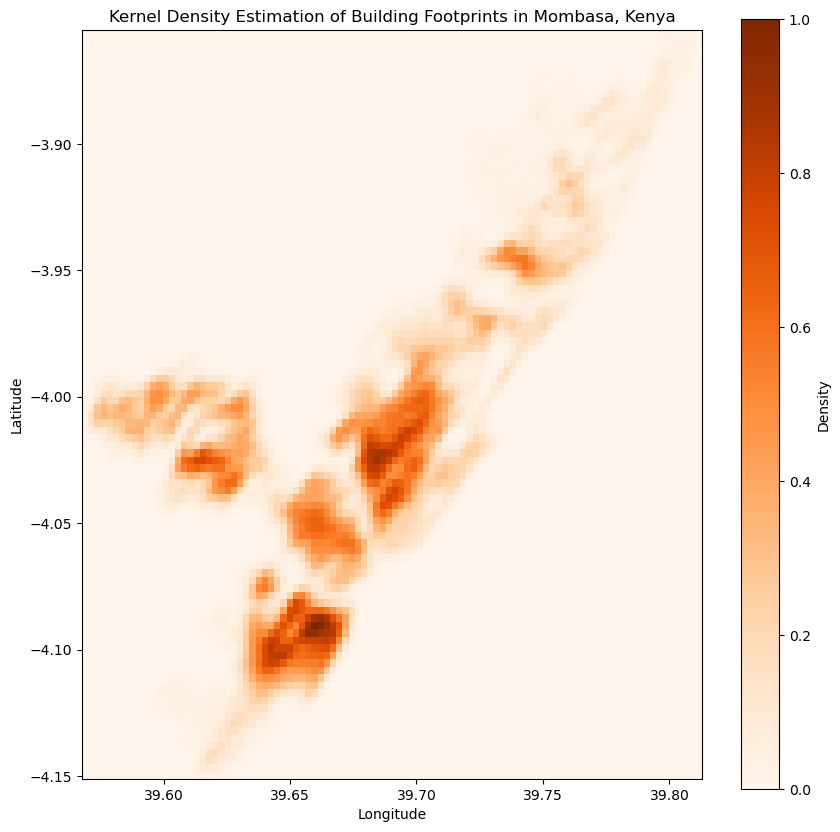

In [21]:
# Plot the results
plt.figure(figsize=(10, 10))
plt.imshow(np.rot90(kde_values_normalized), cmap=plt.cm.Oranges, extent=[x_min, x_max, y_min, y_max])
plt.colorbar(label='Density')
plt.title('Kernel Density Estimation of Building Footprints in Mombasa, Kenya')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()

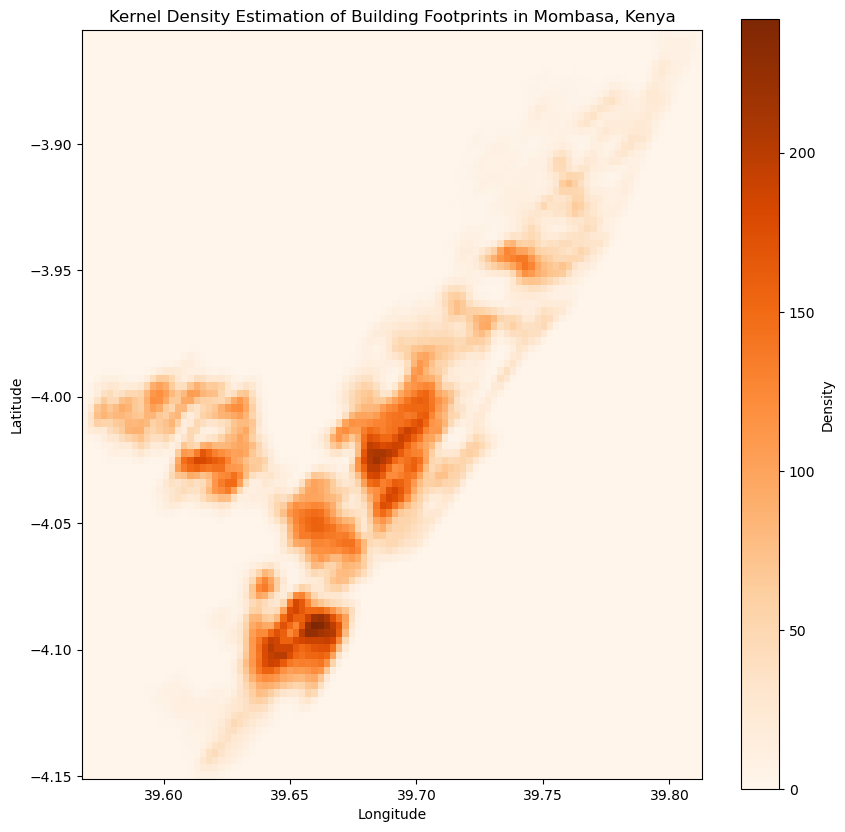

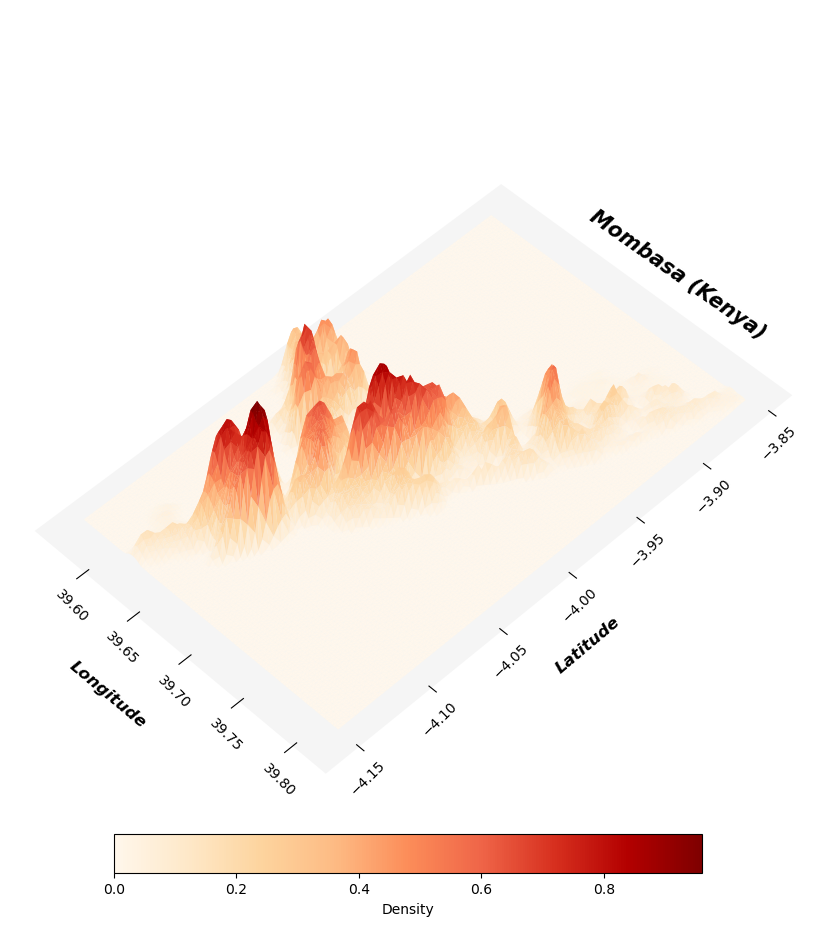

In [22]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(15, 10))
ax = fig.add_subplot(111, projection='3d')

# Create the surface plot
x_flat = x.ravel()
y_flat = y.ravel()
z_flat = kde_values_normalized.ravel()
surf = ax.plot_trisurf(x_flat, y_flat, z_flat, cmap=plt.cm.OrRd, linewidth=0)

# Adjust the view angle for a more top-down perspective
ax.view_init(elev=50, azim=315)

# Add labels and title
# ax.set_title('Mombasa(Kenya)')
# ax.set_xlabel('Longitude')
# ax.set_ylabel('Latitude')
# ax.set_zlabel('Density')

'''Hiding the axes'''
# Hide the z-axis
ax.zaxis.set_ticks([])

# Hide the grid lines
ax.grid(False) 

# Hide the panes (background)
ax.xaxis.pane.fill = False  # Hide the x-axis pane
ax.yaxis.pane.fill = False  # Hide the y-axis pane
# ax.zaxis.pane.fill = False  # Hide the z-axis pane

# Hide the panes (background)
ax.xaxis.pane.set_edgecolor('none')
ax.yaxis.pane.set_edgecolor('none')
ax.zaxis.pane.set_edgecolor('none')

# # Hide the axis lines by setting their color and width
# for spine in ax.spines.values():
#     spine.set_color('none')  # Hide the axis line by setting the color to 'none'
#     spine.set_linewidth(0)   # Set the width to 0 to hide the axis line
    
# # Hide the axis lines
ax.xaxis.line.set_color('none')  # Hide the x-axis line
ax.yaxis.line.set_color('none')  # Hide the y-axis line
ax.zaxis.line.set_color('none')  # Hide the z-axis line

# Hide the x and y axis ticks
ax.tick_params(axis='x', which='both', bottom=True, top=False, labelbottom=True, length=0.01, pad=0, rotation=-45)
ax.tick_params(axis='y', which='both', left=True, right=False, labelleft=True, length=0.01, pad=0, rotation=45)

'''Finished the hiding axes'''

# Adjust aspect ratio to make the plot non-square
ax.set_box_aspect([1, 1.6, 0.5])  # Aspect ratio is 1:2 for x:y

fig.text(0.68, 0.72, 'Mombasa (Kenya)', ha='center', va='center', rotation=-35, fontsize=15, color='Black', style='italic', weight='bold')
fig.text(0.3, 0.3, 'Longitude', ha='center', va='center', rotation=-40, fontsize=12, color='Black', style='italic', weight='bold')
fig.text(0.62, 0.35, 'Latitude', ha='center', va='center', rotation=40, fontsize=12, color='Black', style='italic', weight='bold')

# Add color bar which maps values to colors
fig.colorbar(surf, ax=ax, shrink=0.4, aspect=15, location='bottom', pad=0.03, label='Density')

# Tight layout to make the plot compact
plt.tight_layout()

plt.show()

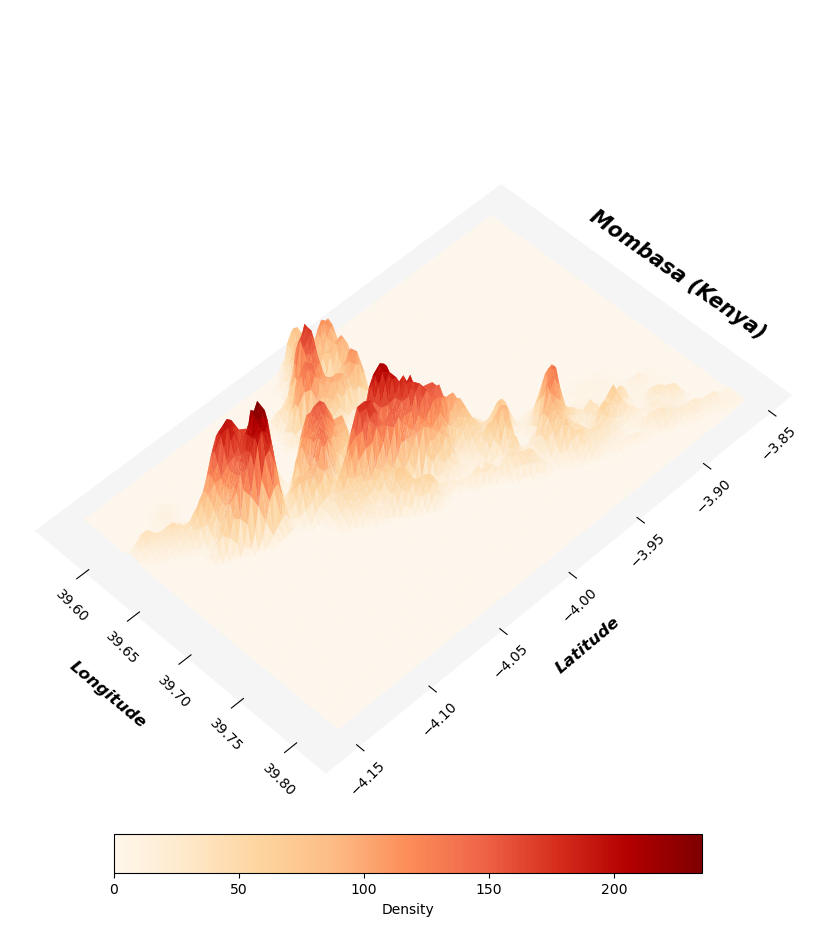

## Calculate the polycentrism index for 598 cities in selected 4 countries

In [3]:
filtered_combined_africa = gpd.read_file('C:/Users/Admin/Desktop/work for summer intern/Africa_shp/filtered_combined_africa.shp')
dissolve_combined_africa = filtered_combined_africa[['agglosName','ISO3','geometry']]

In [25]:
Mombasa_shp = gpd.read_file('C:/Users/Admin/Desktop/work for summer intern/KEN_buildings/Mombasa/Mombasa.shp')

from scipy.stats import gaussian_kde
from sklearn.preprocessing import MaxAbsScaler

# Calculate the point density
Mombasa_shp['centroid'] = Mombasa_shp.centroid
centroids = np.array(list(zip(Mombasa_shp.centroid.x, Mombasa_shp.centroid.y)))

# Create a grid of points
Mombasa_shp = Mombasa_shp.to_crs(epsg=3857)
Mombasa_shp['area'] = Mombasa_shp.area
Mombasa_shp = Mombasa_shp.to_crs(epsg=4326)
weights = Mombasa_shp['area'].values

# Calculate the point density
kde = gaussian_kde(centroids.T, weights=weights, bw_method=0.05)

# Create a grid of points
x_min, y_min, x_max, y_max = Mombasa_shp.total_bounds
x, y = np.mgrid[x_min:x_max:100j, y_min:y_max:100j]
positions = np.vstack([x.ravel(), y.ravel()])

# Evaluate the KDE on the grid
kde_values = np.reshape(kde(positions).T, x.shape)

# Standardize the values using MaxAbsScaler
scaler = MaxAbsScaler()
kde_values_flattened = kde_values.flatten().reshape(-1, 1)
kde_values_normalized = scaler.fit_transform(kde_values_flattened).reshape(x.shape)

# Calculate cell area using EPSG:3857
Mombasa_shp = Mombasa_shp.to_crs(epsg=3857)
x_min, y_min, x_max, y_max = Mombasa_shp.total_bounds
cell_width = (x_max - x_min) / 100
cell_length = (y_max - y_min) / 100
cell_area = cell_width * cell_length

# Calculate the volume for each cell
cell_volumes = kde_values_normalized * cell_area

# Flatten the cell volumes and sort them from high to low
flattened_volumes = cell_volumes.flatten()
sorted_volumes = np.sort(flattened_volumes)[::-1]

# Calculate the polycentrism index φi
v1 = sorted_volumes[0]
k_values = np.arange(1, len(sorted_volumes) + 1)
phi_i = np.sum(k_values * sorted_volumes) / v1

# Create a DataFrame to store the results
data = {
    'poly_index': [phi_i],
    'agglosName': [Mombasa_shp['agglosName'].iloc[0]],  # Assuming 'agglosName' is a column in Mombasa_shp
    'ISO3': [Mombasa_shp['ISO3'].iloc[0]],              # Assuming 'ISO3' is a column in Mombasa_shp
}

results_df = pd.DataFrame(data)

results_df = results_df.merge(dissolve_combined_africa[['agglosName', 'ISO3', 'geometry']],
                              on=['agglosName', 'ISO3'],
                              how='left')

results_gdf = gpd.GeoDataFrame(results_df, geometry='geometry',crs='EPSG:4326')

In [47]:
results_gdf

,poly_index,agglosName,ISO3,geometry
0,377871.66,Mombasa,KEN,"POLYGON ((39.81312 -3.85556, 39.81311 -3.85578..."


In [33]:
from scipy.stats import gaussian_kde
from sklearn.preprocessing import MaxAbsScaler

# Define the input directory and output directory
input_directory = 'C:/Users/Admin/Desktop/work for summer intern/KEN_buildings'
output_directory = 'C:/Users/Admin/Desktop/work for summer intern/KEN_polytable'

# Ensure the output directory exists
if not os.path.exists(output_directory):
    os.makedirs(output_directory)

# Initialize an empty list to store results
results_list = []

# Iterate through each subfolder in the input directory
for subfolder_name in os.listdir(input_directory):
    subfolder_path = os.path.join(input_directory, subfolder_name)
    if os.path.isdir(subfolder_path):
        # Find the .shp file in the subfolder
        for file_name in os.listdir(subfolder_path):
            if file_name.endswith('.shp'):
                shp_file_path = os.path.join(subfolder_path, file_name)

                # Read the shapefile
                Mombasa_shp = gpd.read_file(shp_file_path)

                # Calculate the point density
                Mombasa_shp['centroid'] = Mombasa_shp.centroid
                centroids = np.array(list(zip(Mombasa_shp.centroid.x, Mombasa_shp.centroid.y)))

                # Create a grid of points
                Mombasa_shp = Mombasa_shp.to_crs(epsg=3857)
                Mombasa_shp['area'] = Mombasa_shp.area
                Mombasa_shp = Mombasa_shp.to_crs(epsg=4326)
                weights = Mombasa_shp['area'].values

                # Calculate the point density
                kde = gaussian_kde(centroids.T, weights=weights, bw_method=0.05)

                # Create a grid of points
                x_min, y_min, x_max, y_max = Mombasa_shp.total_bounds
                x, y = np.mgrid[x_min:x_max:100j, y_min:y_max:100j]
                positions = np.vstack([x.ravel(), y.ravel()])

                # Evaluate the KDE on the grid
                kde_values = np.reshape(kde(positions).T, x.shape)

                # Standardize the values using MaxAbsScaler
                scaler = MaxAbsScaler()
                kde_values_flattened = kde_values.flatten().reshape(-1, 1)
                kde_values_normalized = scaler.fit_transform(kde_values_flattened).reshape(x.shape)

                # Calculate cell area using EPSG:3857
                Mombasa_shp = Mombasa_shp.to_crs(epsg=3857)
                x_min, y_min, x_max, y_max = Mombasa_shp.total_bounds
                cell_width = (x_max - x_min) / 100
                cell_length = (y_max - y_min) / 100
                cell_area = cell_width * cell_length

                # Calculate the volume for each cell
                cell_volumes = kde_values_normalized * cell_area

                # Flatten the cell volumes and sort them from high to low
                flattened_volumes = cell_volumes.flatten()
                sorted_volumes = np.sort(flattened_volumes)[::-1]

                # Calculate the polycentrism index φi
                v1 = sorted_volumes[0]
                k_values = np.arange(1, len(sorted_volumes) + 1)
                phi_i = np.sum(k_values * sorted_volumes) / v1

                # Create a DataFrame to store the results
                data = {
                    'poly_index': [phi_i],
                    'agglosName': [Mombasa_shp['agglosName'].iloc[0]],  # Assuming 'agglosName' is a column in Mombasa_shp
                    'ISO3': [Mombasa_shp['ISO3'].iloc[0]],              # Assuming 'ISO3' is a column in Mombasa_shp
                }

                results_list.append(pd.DataFrame(data))

# Combine all results into a single DataFrame
combined_results_KEN = pd.concat(results_list, ignore_index=True)


# Merge with the combined results
final_results_KEN = combined_results_KEN.merge(dissolve_combined_africa[['agglosName', 'ISO3', 'geometry']],
                                             on=['agglosName', 'ISO3'],
                                             how='left')

# Convert to GeoDataFrame
final_results_KEN = gpd.GeoDataFrame(final_results_KEN, geometry='geometry', crs='EPSG:4326')

# Save the final GeoDataFrame to a file
final_results_KEN.to_file(os.path.join(output_directory, 'KEN_polytable.shp'))

In [34]:
final_results_KEN

,poly_index,agglosName,ISO3,geometry
0,600284.24,Athi River,KEN,"POLYGON ((37.00165 -1.43661, 37.00194 -1.43685..."
1,698347.16,Bissil,KEN,"POLYGON ((36.78788 -2.09643, 36.78797 -2.09621..."
2,1944239.12,Bomet,KEN,"MULTIPOLYGON (((35.04227 -0.88750, 35.04395 -0..."
3,385063.60,Bondo,KEN,"POLYGON ((34.25142 -0.09458, 34.25073 -0.09382..."
4,771960.55,Chuka,KEN,"MULTIPOLYGON (((37.60738 -0.34465, 37.60782 -0..."
...,...,...,...,...
107,319911.23,Wagalla,KEN,"POLYGON ((39.93521 1.78415, 39.93595 1.78460, ..."
108,402412.29,Wamumu,KEN,"POLYGON ((37.31853 -0.72623, 37.31916 -0.72617..."
109,442190.59,Wanguru,KEN,"POLYGON ((37.39148 -0.67936, 37.39121 -0.67953..."
110,3299541.74,Welmerer,KEN,"POLYGON ((40.35876 0.01160, 40.35798 0.01000, ..."


In [35]:
from scipy.stats import gaussian_kde
from sklearn.preprocessing import MaxAbsScaler

# Define the input directory and output directory
input_directory = 'C:/Users/Admin/Desktop/work for summer intern/TGO_buildings'
output_directory = 'C:/Users/Admin/Desktop/work for summer intern/TGO_polytable'

# Ensure the output directory exists
if not os.path.exists(output_directory):
    os.makedirs(output_directory)

# Initialize an empty list to store results
results_list = []

# Iterate through each subfolder in the input directory
for subfolder_name in os.listdir(input_directory):
    subfolder_path = os.path.join(input_directory, subfolder_name)
    if os.path.isdir(subfolder_path):
        # Find the .shp file in the subfolder
        for file_name in os.listdir(subfolder_path):
            if file_name.endswith('.shp'):
                shp_file_path = os.path.join(subfolder_path, file_name)

                # Read the shapefile
                Mombasa_shp = gpd.read_file(shp_file_path)

                # Calculate the point density
                Mombasa_shp['centroid'] = Mombasa_shp.centroid
                centroids = np.array(list(zip(Mombasa_shp.centroid.x, Mombasa_shp.centroid.y)))

                # Create a grid of points
                Mombasa_shp = Mombasa_shp.to_crs(epsg=3857)
                Mombasa_shp['area'] = Mombasa_shp.area
                Mombasa_shp = Mombasa_shp.to_crs(epsg=4326)
                weights = Mombasa_shp['area'].values

                # Calculate the point density
                kde = gaussian_kde(centroids.T, weights=weights, bw_method=0.05)

                # Create a grid of points
                x_min, y_min, x_max, y_max = Mombasa_shp.total_bounds
                x, y = np.mgrid[x_min:x_max:100j, y_min:y_max:100j]
                positions = np.vstack([x.ravel(), y.ravel()])

                # Evaluate the KDE on the grid
                kde_values = np.reshape(kde(positions).T, x.shape)

                # Standardize the values using MaxAbsScaler
                scaler = MaxAbsScaler()
                kde_values_flattened = kde_values.flatten().reshape(-1, 1)
                kde_values_normalized = scaler.fit_transform(kde_values_flattened).reshape(x.shape)

                # Calculate cell area using EPSG:3857
                Mombasa_shp = Mombasa_shp.to_crs(epsg=3857)
                x_min, y_min, x_max, y_max = Mombasa_shp.total_bounds
                cell_width = (x_max - x_min) / 100
                cell_length = (y_max - y_min) / 100
                cell_area = cell_width * cell_length

                # Calculate the volume for each cell
                cell_volumes = kde_values_normalized * cell_area

                # Flatten the cell volumes and sort them from high to low
                flattened_volumes = cell_volumes.flatten()
                sorted_volumes = np.sort(flattened_volumes)[::-1]

                # Calculate the polycentrism index φi
                v1 = sorted_volumes[0]
                k_values = np.arange(1, len(sorted_volumes) + 1)
                phi_i = np.sum(k_values * sorted_volumes) / v1

                # Create a DataFrame to store the results
                data = {
                    'poly_index': [phi_i],
                    'agglosName': [Mombasa_shp['agglosName'].iloc[0]],  # Assuming 'agglosName' is a column in Mombasa_shp
                    'ISO3': [Mombasa_shp['ISO3'].iloc[0]],              # Assuming 'ISO3' is a column in Mombasa_shp
                }

                results_list.append(pd.DataFrame(data))

# Combine all results into a single DataFrame
combined_results_TGO = pd.concat(results_list, ignore_index=True)


# Merge with the combined results
final_results_TGO = combined_results_TGO.merge(dissolve_combined_africa[['agglosName', 'ISO3', 'geometry']],
                                             on=['agglosName', 'ISO3'],
                                             how='left')

# Convert to GeoDataFrame
final_results_TGO = gpd.GeoDataFrame(final_results_TGO, geometry='geometry', crs='EPSG:4326')

# Save the final GeoDataFrame to a file
final_results_TGO.to_file(os.path.join(output_directory, 'TGO_polytable.shp'))

In [36]:
final_results_TGO

,poly_index,agglosName,ISO3,geometry
0,234918.44,Adeta,TGO,"POLYGON ((0.76443 7.19398, 0.76449 7.19493, 0...."
1,470346.81,Adjengre,TGO,"POLYGON ((1.00673 8.64754, 1.00671 8.64749, 1...."
2,1204653.31,Afagnagan,TGO,"POLYGON ((1.63386 6.50363, 1.63372 6.50356, 1...."
3,806741.62,Ahepe,TGO,"POLYGON ((1.40571 6.61584, 1.40463 6.61542, 1...."
4,852756.60,Aklakou,TGO,"POLYGON ((1.71615 6.33565, 1.71629 6.33565, 1...."
5,289031.21,Aneho/Hilacondji [TGO],TGO,"POLYGON ((1.62946 6.24134, 1.62891 6.23614, 1...."
6,560376.72,Anfoin,TGO,"POLYGON ((1.61380 6.33851, 1.61380 6.33859, 1...."
7,1482593.42,Anie,TGO,"POLYGON ((1.18937 7.80164, 1.19143 7.80195, 1...."
8,402081.60,Asrama,TGO,"POLYGON ((1.38483 7.02918, 1.38553 7.03078, 1...."
9,734309.93,Assahoun,TGO,"POLYGON ((0.90670 6.46898, 0.90669 6.46943, 0...."


In [37]:
from scipy.stats import gaussian_kde
from sklearn.preprocessing import MaxAbsScaler

# Define the input directory and output directory
input_directory = 'C:/Users/Admin/Desktop/work for summer intern/TZA_buildings'
output_directory = 'C:/Users/Admin/Desktop/work for summer intern/TZA_polytable'

# Ensure the output directory exists
if not os.path.exists(output_directory):
    os.makedirs(output_directory)

# Initialize an empty list to store results
results_list = []

# Iterate through each subfolder in the input directory
for subfolder_name in os.listdir(input_directory):
    subfolder_path = os.path.join(input_directory, subfolder_name)
    if os.path.isdir(subfolder_path):
        # Find the .shp file in the subfolder
        for file_name in os.listdir(subfolder_path):
            if file_name.endswith('.shp'):
                shp_file_path = os.path.join(subfolder_path, file_name)

                # Read the shapefile
                Mombasa_shp = gpd.read_file(shp_file_path)

                # Calculate the point density
                Mombasa_shp['centroid'] = Mombasa_shp.centroid
                centroids = np.array(list(zip(Mombasa_shp.centroid.x, Mombasa_shp.centroid.y)))

                # Create a grid of points
                Mombasa_shp = Mombasa_shp.to_crs(epsg=3857)
                Mombasa_shp['area'] = Mombasa_shp.area
                Mombasa_shp = Mombasa_shp.to_crs(epsg=4326)
                weights = Mombasa_shp['area'].values

                # Calculate the point density
                kde = gaussian_kde(centroids.T, weights=weights, bw_method=0.05)

                # Create a grid of points
                x_min, y_min, x_max, y_max = Mombasa_shp.total_bounds
                x, y = np.mgrid[x_min:x_max:100j, y_min:y_max:100j]
                positions = np.vstack([x.ravel(), y.ravel()])

                # Evaluate the KDE on the grid
                kde_values = np.reshape(kde(positions).T, x.shape)

                # Standardize the values using MaxAbsScaler
                scaler = MaxAbsScaler()
                kde_values_flattened = kde_values.flatten().reshape(-1, 1)
                kde_values_normalized = scaler.fit_transform(kde_values_flattened).reshape(x.shape)

                # Calculate cell area using EPSG:3857
                Mombasa_shp = Mombasa_shp.to_crs(epsg=3857)
                x_min, y_min, x_max, y_max = Mombasa_shp.total_bounds
                cell_width = (x_max - x_min) / 100
                cell_length = (y_max - y_min) / 100
                cell_area = cell_width * cell_length

                # Calculate the volume for each cell
                cell_volumes = kde_values_normalized * cell_area

                # Flatten the cell volumes and sort them from high to low
                flattened_volumes = cell_volumes.flatten()
                sorted_volumes = np.sort(flattened_volumes)[::-1]

                # Calculate the polycentrism index φi
                v1 = sorted_volumes[0]
                k_values = np.arange(1, len(sorted_volumes) + 1)
                phi_i = np.sum(k_values * sorted_volumes) / v1

                # Create a DataFrame to store the results
                data = {
                    'poly_index': [phi_i],
                    'agglosName': [Mombasa_shp['agglosName'].iloc[0]],  # Assuming 'agglosName' is a column in Mombasa_shp
                    'ISO3': [Mombasa_shp['ISO3'].iloc[0]],              # Assuming 'ISO3' is a column in Mombasa_shp
                }

                results_list.append(pd.DataFrame(data))

# Combine all results into a single DataFrame
combined_results_TZA = pd.concat(results_list, ignore_index=True)


# Merge with the combined results
final_results_TZA = combined_results_TZA.merge(dissolve_combined_africa[['agglosName', 'ISO3', 'geometry']],
                                             on=['agglosName', 'ISO3'],
                                             how='left')

# Convert to GeoDataFrame
final_results_TZA = gpd.GeoDataFrame(final_results_TZA, geometry='geometry', crs='EPSG:4326')

# Save the final GeoDataFrame to a file
final_results_TZA.to_file(os.path.join(output_directory, 'TZA_polytable.shp'))

In [38]:
final_results_TZA

,poly_index,agglosName,ISO3,geometry
0,832328.70,Arusha,TZA,"MULTIPOLYGON (((36.89142 -3.39970, 36.89102 -3..."
1,371966.81,Babati,TZA,"POLYGON ((35.75150 -4.23700, 35.75023 -4.23709..."
2,1227212.00,Bagamoyo (Pwani),TZA,"POLYGON ((38.90748 -6.45422, 38.90637 -6.45444..."
3,370865.02,Barabarani,TZA,"POLYGON ((35.84802 -3.37237, 35.84370 -3.37111..."
4,441037.68,Bariadi,TZA,"POLYGON ((33.98423 -2.80303, 33.98387 -2.80281..."
...,...,...,...,...
229,1118707.15,Utete,TZA,"POLYGON ((38.74839 -7.99376, 38.74811 -7.99235..."
230,142730.50,Uyovu,TZA,"POLYGON ((31.51800 -3.34436, 31.51821 -3.34404..."
231,452566.77,Vigoi,TZA,"POLYGON ((36.70531 -8.68689, 36.70486 -8.68598..."
232,1545098.58,Wete,TZA,"POLYGON ((39.71802 -5.06172, 39.71796 -5.06149..."


In [39]:
from scipy.stats import gaussian_kde
from sklearn.preprocessing import MaxAbsScaler

# Define the input directory and output directory
input_directory = 'C:/Users/Admin/Desktop/work for summer intern/GHA_buildings'
output_directory = 'C:/Users/Admin/Desktop/work for summer intern/GHA_polytable'

# Ensure the output directory exists
if not os.path.exists(output_directory):
    os.makedirs(output_directory)

# Initialize an empty list to store results
results_list = []

# Iterate through each subfolder in the input directory
for subfolder_name in os.listdir(input_directory):
    subfolder_path = os.path.join(input_directory, subfolder_name)
    if os.path.isdir(subfolder_path):
        # Find the .shp file in the subfolder
        for file_name in os.listdir(subfolder_path):
            if file_name.endswith('.shp'):
                shp_file_path = os.path.join(subfolder_path, file_name)

                # Read the shapefile
                Mombasa_shp = gpd.read_file(shp_file_path)

                # Calculate the point density
                Mombasa_shp['centroid'] = Mombasa_shp.centroid
                centroids = np.array(list(zip(Mombasa_shp.centroid.x, Mombasa_shp.centroid.y)))

                # Create a grid of points
                Mombasa_shp = Mombasa_shp.to_crs(epsg=3857)
                Mombasa_shp['area'] = Mombasa_shp.area
                Mombasa_shp = Mombasa_shp.to_crs(epsg=4326)
                weights = Mombasa_shp['area'].values

                # Calculate the point density
                kde = gaussian_kde(centroids.T, weights=weights, bw_method=0.05)

                # Create a grid of points
                x_min, y_min, x_max, y_max = Mombasa_shp.total_bounds
                x, y = np.mgrid[x_min:x_max:100j, y_min:y_max:100j]
                positions = np.vstack([x.ravel(), y.ravel()])

                # Evaluate the KDE on the grid
                kde_values = np.reshape(kde(positions).T, x.shape)

                # Standardize the values using MaxAbsScaler
                scaler = MaxAbsScaler()
                kde_values_flattened = kde_values.flatten().reshape(-1, 1)
                kde_values_normalized = scaler.fit_transform(kde_values_flattened).reshape(x.shape)

                # Calculate cell area using EPSG:3857
                Mombasa_shp = Mombasa_shp.to_crs(epsg=3857)
                x_min, y_min, x_max, y_max = Mombasa_shp.total_bounds
                cell_width = (x_max - x_min) / 100
                cell_length = (y_max - y_min) / 100
                cell_area = cell_width * cell_length

                # Calculate the volume for each cell
                cell_volumes = kde_values_normalized * cell_area

                # Flatten the cell volumes and sort them from high to low
                flattened_volumes = cell_volumes.flatten()
                sorted_volumes = np.sort(flattened_volumes)[::-1]

                # Calculate the polycentrism index φi
                v1 = sorted_volumes[0]
                k_values = np.arange(1, len(sorted_volumes) + 1)
                phi_i = np.sum(k_values * sorted_volumes) / v1

                # Create a DataFrame to store the results
                data = {
                    'poly_index': [phi_i],
                    'agglosName': [Mombasa_shp['agglosName'].iloc[0]],  # Assuming 'agglosName' is a column in Mombasa_shp
                    'ISO3': [Mombasa_shp['ISO3'].iloc[0]],              # Assuming 'ISO3' is a column in Mombasa_shp
                }

                results_list.append(pd.DataFrame(data))

# Combine all results into a single DataFrame
combined_results_GHA = pd.concat(results_list, ignore_index=True)


# Merge with the combined results
final_results_GHA = combined_results_GHA.merge(dissolve_combined_africa[['agglosName', 'ISO3', 'geometry']],
                                             on=['agglosName', 'ISO3'],
                                             how='left')

# Convert to GeoDataFrame
final_results_GHA = gpd.GeoDataFrame(final_results_GHA, geometry='geometry', crs='EPSG:4326')

# Save the final GeoDataFrame to a file
final_results_GHA.to_file(os.path.join(output_directory, 'GHA_polytable.shp'))

In [40]:
final_results_GHA

,poly_index,agglosName,ISO3,geometry
0,1407299.28,Abetifi,GHA,"POLYGON ((-0.73261 6.67309, -0.73312 6.67298, ..."
1,1072632.39,Abofour,GHA,"POLYGON ((-1.72301 7.14218, -1.72367 7.14185, ..."
2,623325.51,Aboso,GHA,"POLYGON ((-1.93366 5.36108, -1.93391 5.36057, ..."
3,1768710.04,Abuesi,GHA,"POLYGON ((-1.63467 4.98288, -1.63519 4.98175, ..."
4,2285684.25,Abura Dunkwa,GHA,"POLYGON ((-1.15490 5.35164, -1.15587 5.35043, ..."
...,...,...,...,...
197,1399116.84,Wulensi,GHA,"POLYGON ((0.01112 8.64997, 0.01055 8.65003, 0...."
198,1792199.58,Yamfo,GHA,"POLYGON ((-2.22869 7.22335, -2.22912 7.22235, ..."
199,1838346.96,Yegyi,GHA,"POLYGON ((-0.63263 8.22055, -0.63289 8.21928, ..."
200,1643456.82,Yendi,GHA,"POLYGON ((0.01985 9.44446, 0.01864 9.44397, 0...."


## Week_5_Explore the correlationship between population with different factors

In [115]:
final_results_KEN = gpd.read_file('C:/Users/Admin/Desktop/work for summer intern/KEN_polytable/KEN_polytable.shp')
final_results_GHA = gpd.read_file('C:/Users/Admin/Desktop/work for summer intern/GHA_polytable/GHA_polytable.shp')
final_results_TZA = gpd.read_file('C:/Users/Admin/Desktop/work for summer intern/TZA_polytable/TZA_polytable.shp')
final_results_TGO = gpd.read_file('C:/Users/Admin/Desktop/work for summer intern/TGO_polytable/TGO_polytable.shp')

combined_final_results = pd.concat([final_results_KEN, final_results_GHA, final_results_TZA, final_results_TGO], ignore_index=True)

In [118]:
selected_four_countries_final_results = combined_final_results[['poly_index', 'agglosName', 'ISO3']].merge(filtered_combined_africa, on=['agglosName', 'ISO3'], how='left').dropna()

In [126]:
selected_four_countries_final_results[['Pop2015', 'poly_index', 'Elongation', 'Sprawl', 'NBuildings', 'Green_spac', 'PM2.5_2020']].describe()

,Pop2015,poly_index,Elongation,Sprawl,NBuildings,Green_spac,PM2.5_2020
count,527.00,527.00,527.00,527.00,527.00,527.00,527.00
mean,109168.26,942697.49,7.75,1.01,51372.20,0.44,24.26
std,503757.58,647266.20,3.11,0.54,243322.33,0.22,5.36
min,10030.00,79170.57,3.57,0.38,2016.00,0.02,14.63
25%,14304.50,425595.82,5.46,0.63,5133.00,0.28,20.43
50%,23088.00,771960.55,6.82,0.85,8857.00,0.42,23.42
75%,45431.00,1300834.54,9.02,1.17,18038.50,0.58,27.33
max,5877118.00,3299541.74,20.00,2.88,2890811.00,0.97,46.74


In [127]:
selected_four_countries_final_results['ln_Pop_2015'] = np.log(selected_four_countries_final_results['Pop2015'])
selected_four_countries_final_results['ln_poly_index'] = np.log(selected_four_countries_final_results['poly_index'])
selected_four_countries_final_results['ln_NBuildings'] = np.log(selected_four_countries_final_results['NBuildings'])

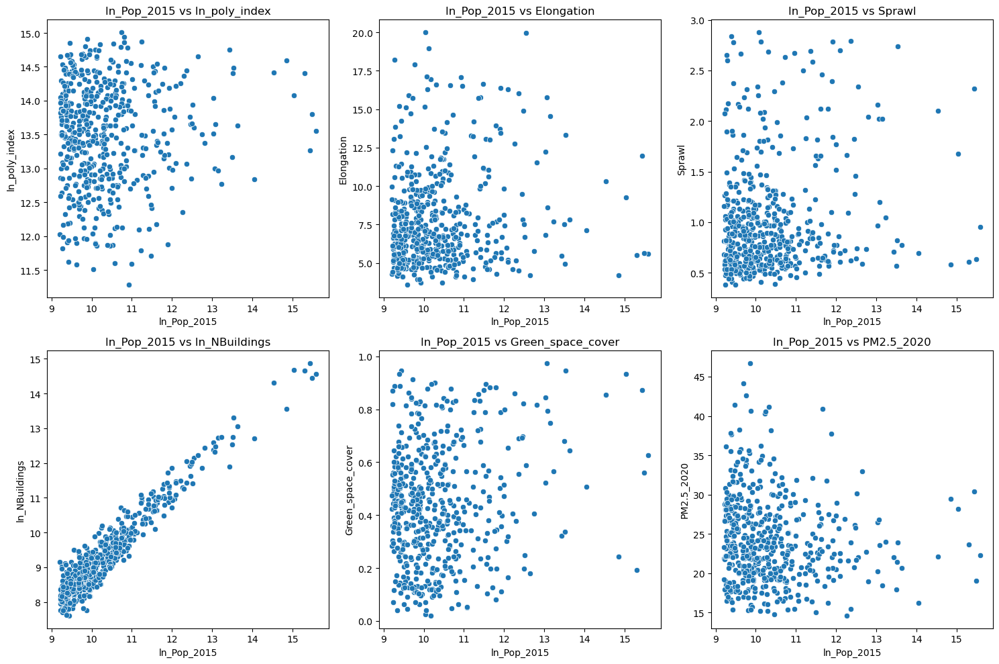

In [62]:
fig, axes = plt.subplots(2, 3, figsize=(15, 10))

axes = axes.flatten()

x_var = 'ln_Pop_2015'
y_vars = ['ln_poly_index', 'Elongation', 'Sprawl', 'ln_NBuildings', 'Green_spac', 'PM2.5_2020']

for i, y_var in enumerate(y_vars):
    sns.scatterplot(data=selected_four_countries_final_results, x=x_var, y=y_var, ax=axes[i])
    axes[i].set_title(f'{x_var} vs {y_var}')
    
plt.tight_layout()

plt.show()

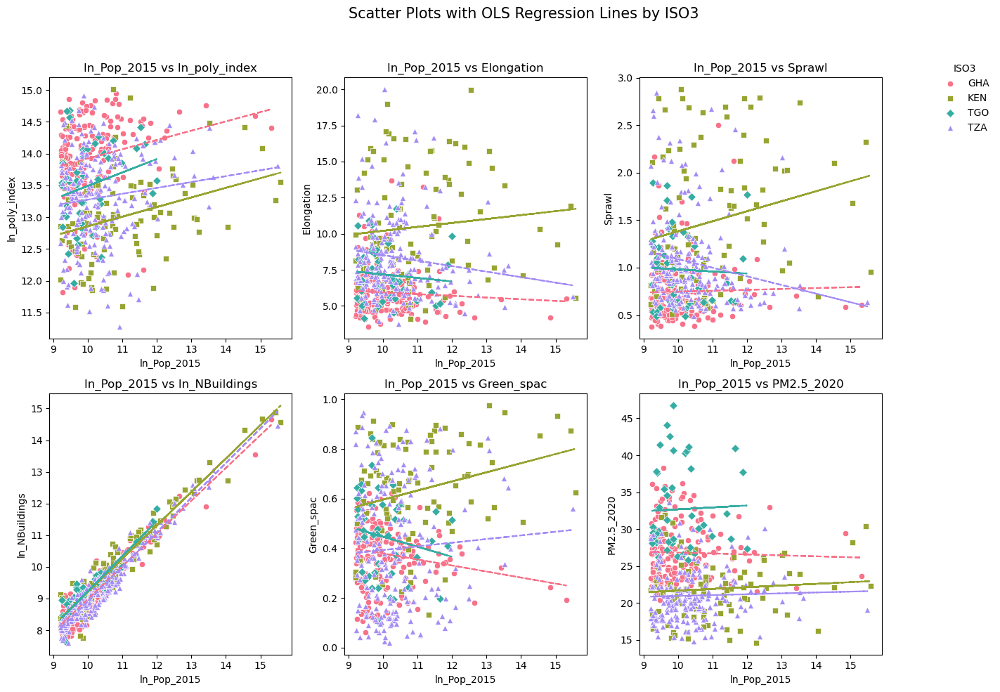

In [128]:
# Define color palette and markers
palette = sns.color_palette("husl", len(selected_four_countries_final_results['ISO3'].unique()))
markers = ['o', 's', 'D', '^', 'v', 'p']

# Plotting the pairplot with the specified layout
fig, axes = plt.subplots(2, 3, figsize=(15, 10))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Define the variables to plot
x_var = 'ln_Pop_2015'
y_vars = ['ln_poly_index', 'Elongation', 'Sprawl', 'ln_NBuildings', 'Green_spac', 'PM2.5_2020']

# Plot each pair in its respective subplot
for i, y_var in enumerate(y_vars):
    ax = axes[i]
    for j, (ios, group) in enumerate(selected_four_countries_final_results.groupby('ISO3')):
        sns.scatterplot(data=group, x=x_var, y=y_var, ax=ax, label=ios, color=palette[j], marker=markers[j])

        # Fit OLS
        X = sm.add_constant(group[x_var])
        model = sm.OLS(group[y_var], X).fit()
        ax.plot(group[x_var], model.fittedvalues, color=palette[j], linestyle='--')

    ax.set_title(f'{x_var} vs {y_var}')
    ax.legend_.remove()  # Remove the legend from individual subplots

# Add a single legend to the right
handles, labels = ax.get_legend_handles_labels()
fig.legend(handles, labels, loc='center right', title='ISO3', bbox_to_anchor=(0.95, 0.85), frameon=False)

# Set the overall title
fig.suptitle('Scatter Plots with OLS Regression Lines by ISO3', fontsize=15)

plt.tight_layout(rect=[0, 0, 0.85, 0.95])
plt.show()

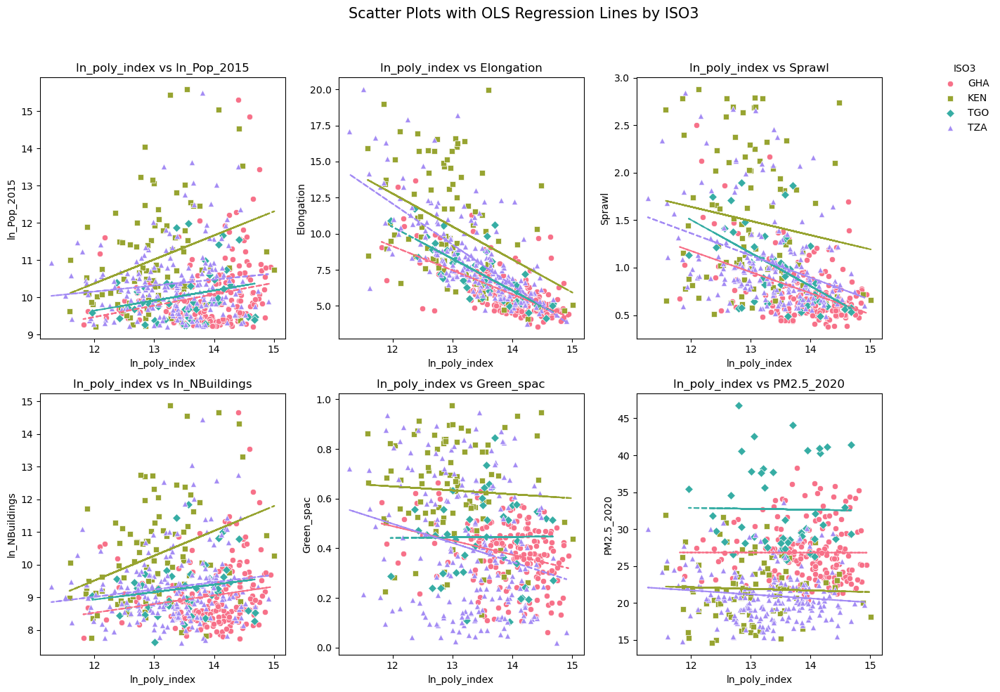

In [129]:
# Define color palette and markers
palette = sns.color_palette("husl", len(selected_four_countries_final_results['ISO3'].unique()))
markers = ['o', 's', 'D', '^', 'v', 'p']

# Plotting the pairplot with the specified layout
fig, axes = plt.subplots(2, 3, figsize=(15, 10))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Define the variables to plot
x_var = 'ln_poly_index'
y_vars = ['ln_Pop_2015', 'Elongation', 'Sprawl', 'ln_NBuildings', 'Green_spac', 'PM2.5_2020']

# Plot each pair in its respective subplot
for i, y_var in enumerate(y_vars):
    ax = axes[i]
    for j, (ios, group) in enumerate(selected_four_countries_final_results.groupby('ISO3')):
        sns.scatterplot(data=group, x=x_var, y=y_var, ax=ax, label=ios, color=palette[j], marker=markers[j])

        # Fit OLS
        X = sm.add_constant(group[x_var])
        model = sm.OLS(group[y_var], X).fit()
        ax.plot(group[x_var], model.fittedvalues, color=palette[j], linestyle='--')

    ax.set_title(f'{x_var} vs {y_var}')
    ax.legend_.remove()  # Remove the legend from individual subplots

# Add a single legend to the right
handles, labels = ax.get_legend_handles_labels()
fig.legend(handles, labels, loc='center right', title='ISO3', bbox_to_anchor=(0.95, 0.85), frameon=False)

# Set the overall title
fig.suptitle('Scatter Plots with OLS Regression Lines by ISO3', fontsize=15)

plt.tight_layout(rect=[0, 0, 0.85, 0.95])
plt.show()

## Week_6

### LISA by kernal density value

In [4]:
from pysal.viz import splot
from splot.esda import plot_moran
from pysal.explore import esda
from pysal.lib import weights
from esda.moran import Moran
from libpysal.weights import Queen, KNN
from numpy.random import seed

from splot import esda as esdaplot

from scipy.stats import gaussian_kde
from mpl_toolkits.mplot3d import Axes3D
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import MaxAbsScaler

In [5]:
Mombasa_shp = gpd.read_file('C:/Users/Admin/Desktop/work for summer intern/KEN_buildings/Mombasa/Mombasa.shp')

In [74]:
# # Calculate the point density
# Mombasa_shp['centroid'] = Mombasa_shp.centroid
# centroids = np.array(list(zip(Mombasa_shp.centroid.x, Mombasa_shp.centroid.y)))

# # Create a grid of points
# Mombasa_shp = Mombasa_shp.to_crs(epsg=3857)
# Mombasa_shp['area'] = Mombasa_shp.area
# Mombasa_shp = Mombasa_shp.to_crs(epsg=4326)
# weights = Mombasa_shp['area'].values

# # Calculate the point density
# kde = gaussian_kde(centroids.T, weights=weights, bw_method=0.05)

# # Create a grid of points
# x_min, y_min, x_max, y_max = Mombasa_shp.total_bounds
# x, y = np.mgrid[x_min:x_max:100j, y_min:y_max:100j]
# positions = np.vstack([x.ravel(), y.ravel()])

# # Evaluate the KDE on the grid
# kde_values = np.reshape(kde(positions).T, x.shape)

# ''' different Standardize methods '''
# # Standardize the values using MaxAbsScaler
# scaler = MaxAbsScaler()
# kde_values_flattened = kde_values.flatten().reshape(-1, 1)
# kde_values_normalized = scaler.fit_transform(kde_values_flattened).reshape(x.shape)

# # transfer the kde_values_normalized to a dataframe
# kde_values_normalized_flattened = kde_values_normalized.flatten()
# data = {
#     'x': x.ravel(),
#     'y': y.ravel(),
#     'kde_value': kde_values_normalized_flattened
# }
# kde_values_df = pd.DataFrame(data)

# # transfer the dataframe to a geodataframe
# geometry = [Point(xy) for xy in zip(kde_values_df['x'], kde_values_df['y'])]
# kde_values_gdf = gpd.GeoDataFrame(kde_values_df, geometry=geometry,crs='EPSG:4326')

In [75]:
# # create a new datafram to store the results of lisa
# kde_values_gdf.to_crs(epsg=3857, inplace=True)

# w = KNN.from_dataframe(kde_values_gdf, k=8)
# w.transform = 'R'

# lisa = esda.moran.Moran_Local(kde_values_gdf["kde_value"], w, permutations=9999)

# kde_values_gdf['LISA'] = lisa.Is
# kde_values_gdf['LISA_p'] = lisa.p_sim
# kde_values_gdf['LISA_q'] = lisa.q  # Quadrant information

# kde_values_gdf['sig'] = (kde_values_gdf['LISA_p'] < 0.01) * 1

# # pick up HH and HL clusters tracts
# polycentric = kde_values_gdf[((kde_values_gdf['LISA_q'] == 1) | (kde_values_gdf['LISA_q'] == 4)) & (kde_values_gdf['sig'] == 1)].reset_index(drop=True)
# polycentric['rank'] = polycentric['kde_value'].rank(ascending=False, method='first')

In [76]:
# tot_value = polycentric['kde_value']
# max_value = tot_value.max()
# hypothetical_sd = np.std([max_value, 0])

# result = {}

# # 1.1 Calculate the standard deviation of all tot_pop in the group
# sd_all = np.std(tot_value)
# result['std_dev_all'] = 1 - (sd_all / hypothetical_sd)

# # Create a DataFrame to store the results
# data_list = {
#     'std_dev_all': [result['std_dev_all']],
#     'agglosName': [Mombasa_shp['agglosName'].iloc[0]],  # Assuming 'agglosName' is a column in Mombasa_shp
#     'ISO3': [Mombasa_shp['ISO3'].iloc[0]],              # Assuming 'ISO3' is a column in Mombasa_shp
# }

# df_results = pd.DataFrame(data_list)

### case study_get the geometric center of the Mombasa_shp city

In [101]:
# Calculate the point density
Mombasa_shp['centroid'] = Mombasa_shp.centroid
centroids = np.array(list(zip(Mombasa_shp.centroid.x, Mombasa_shp.centroid.y)))

# Convert CRS and calculate area
Mombasa_shp = Mombasa_shp.to_crs(epsg=3857)
Mombasa_shp['area'] = Mombasa_shp.area
Mombasa_shp = Mombasa_shp.to_crs(epsg=4326)
weights = Mombasa_shp['area'].values

# Calculate the point density using KDE
kde = gaussian_kde(centroids.T, weights=weights, bw_method=0.05)

# Create a grid of points
x_min, y_min, x_max, y_max = Mombasa_shp.total_bounds
x, y = np.mgrid[x_min:x_max:100j, y_min:y_max:100j]
positions = np.vstack([x.ravel(), y.ravel()])

# Evaluate the KDE on the grid
kde_values = np.reshape(kde(positions).T, x.shape)

# Standardize the values using MaxAbsScaler
scaler = MaxAbsScaler()
kde_values_flattened = kde_values.flatten().reshape(-1, 1)
kde_values_normalized = scaler.fit_transform(kde_values_flattened).reshape(x.shape)

# Transfer the kde_values_normalized to a dataframe
kde_values_normalized_flattened = kde_values_normalized.flatten()
data = {
    'x': x.ravel(),
    'y': y.ravel(),
    'kde_value': kde_values_normalized_flattened
}
kde_values_df = pd.DataFrame(data)

# Create grid geometries (polygons)
x_min, y_min, x_max, y_max = Mombasa_shp.total_bounds
x_points = np.linspace(x_min, x_max, 101)  # 101 points to create 100 cells
y_points = np.linspace(y_min, y_max, 101)  # 101 points to create 100 cells
polygons = []

for i in range(len(x_points) - 1):
    for j in range(len(y_points) - 1):
        polygons.append(Polygon([
            (x_points[i], y_points[j]),
            (x_points[i + 1], y_points[j]),
            (x_points[i + 1], y_points[j + 1]),
            (x_points[i], y_points[j + 1])
        ]))
        
grid_gdf = gpd.GeoDataFrame({'geometry': polygons}, crs="EPSG:4326")

# Change the geometry to the kde_values_gdf
kde_values_df['geometry'] = grid_gdf['geometry']
kde_values_gdf = gpd.GeoDataFrame(kde_values_df, geometry='geometry')

# Convert CRS for LISA calculation
kde_values_gdf.to_crs(epsg=3857, inplace=True)

# Create spatial weights and calculate LISA
w = KNN.from_dataframe(kde_values_gdf, k=8)
w.transform = 'R'
lisa = esda.moran.Moran_Local(kde_values_gdf["kde_value"], w, permutations=9999)

# Add LISA results to the GeoDataFrame
kde_values_gdf['LISA'] = lisa.Is
kde_values_gdf['LISA_p'] = lisa.p_sim
kde_values_gdf['LISA_q'] = lisa.q  # Quadrant information
kde_values_gdf['sig'] = (kde_values_gdf['LISA_p'] < 0.01) * 1

# Convert back to original CRS
kde_values_gdf.to_crs(epsg=4326, inplace=True)

# pick up HH and HL clusters tracts
polycentric = kde_values_gdf[((kde_values_gdf['LISA_q'] == 1) | (kde_values_gdf['LISA_q'] == 4)) & (kde_values_gdf['sig'] == 1)].reset_index(drop=True)

# Dissolve selected clusters into a single geometry
dissolved_polycentric = polycentric.dissolve().reset_index()
dissolved_polycentric = dissolved_polycentric[['geometry']]

# explore the multipolygon into ploygon
exploded_polycentric = dissolved_polycentric.explode(column='geometry', ignore_index=True)

# calculate the total population in each combined polygon
spatial_joined_within = gpd.sjoin(polycentric, exploded_polycentric, how='inner', op='within')
total_kde_value_sum = spatial_joined_within.groupby('index_right')['kde_value'].sum().reset_index()
exploded_polycentric = exploded_polycentric.merge(total_kde_value_sum, left_index=True, right_on='index_right', how='left').drop(columns='index_right')

# keep the total kde value sum > 0
exploded_polycentric = exploded_polycentric[~exploded_polycentric['kde_value'].isna()].reset_index(drop=True)
# rank the kde_value
exploded_polycentric['rank'] = exploded_polycentric['kde_value'].rank(ascending=False, method='first')

# create the function to calculate the standard deviation metrics
def calculate_std_dev_metrics(exploded_polycentric):
    tot_kde_value = exploded_polycentric['kde_value']
    max_kde_value = tot_kde_value.max()
    hypothetical_sd = np.std([max_kde_value, 0])

    result = {}

    # 1.1 Calculate the standard deviation of all tot_kde_value in the group
    sd_all = np.std(tot_kde_value)
    result['std_dev_all'] = 1 - (sd_all / hypothetical_sd)

    # 1.2 Calculate the standard deviation of the top 2 to top 15 rankings separately
    for i in range(2, 16):
        if len(tot_kde_value) >= i:
            sd_kde_value_i = np.std(tot_kde_value.nlargest(i))
            result[f'std_dev_{i}'] = 1 - (sd_kde_value_i / hypothetical_sd)
        else:
            result[f'std_dev_{i}'] = np.nan

    # Calculate the mean of the standard deviations for rankings 2, 3, and 4
    ranks_2_to_4 = [result.get(f'std_dev_{i}', np.nan) for i in range(2, 5)]
    # calculate the average only if when all values of 'std_dev_2','std_dev_3','std_dev_4' are not NaN
    if all(not np.isnan(value) for value in ranks_2_to_4):
        result['avg_std_dev_2_to_4'] = np.mean(ranks_2_to_4)
    else:
        result['avg_std_dev_2_to_4'] = np.nan

    return pd.Series(result)

# operate the function
std_dev_metrics = calculate_std_dev_metrics(exploded_polycentric)
# convert the result to a dataframe
sd_results = pd.DataFrame(std_dev_metrics).T

# add the 'agglosName' and 'ISO3' to the result
sd_results['agglosName'] = Mombasa_shp['agglosName'].iloc[0]
sd_results['ISO3'] = Mombasa_shp['ISO3'].iloc[0]

# transfer the result to a geodataframe
sd_results_geo = sd_results.merge(dissolve_combined_africa[['agglosName', 'ISO3', 'geometry']], on=['agglosName', 'ISO3'], how='left')
sd_results_geo = gpd.GeoDataFrame(sd_results_geo, geometry='geometry', crs='EPSG:4326')

In [108]:
sd_results_geo

,std_dev_all,std_dev_2,std_dev_3,std_dev_4,std_dev_5,std_dev_6,std_dev_7,std_dev_8,std_dev_9,std_dev_10,std_dev_11,std_dev_12,std_dev_13,std_dev_14,std_dev_15,avg_std_dev_2_to_4,agglosName,ISO3,geometry
0,0.30,0.53,0.49,0.35,0.31,0.30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.46,Mombasa,KEN,"POLYGON ((39.81312 -3.85556, 39.81311 -3.85578..."


In [107]:
# sd_results_geo.to_file('C:/Users/Admin/Desktop/work for summer intern/test/sd_results_geo.shp')

### Run the code

In [5]:
from scipy.stats import gaussian_kde
from sklearn.preprocessing import MaxAbsScaler
from esda.moran import Moran_Local
from libpysal.weights import KNN
import os
import numpy as np
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point, Polygon

In [130]:
# Define the input directory and output directory
input_directory = 'C:/Users/Admin/Desktop/work for summer intern/TGO_buildings'
output_directory = 'C:/Users/Admin/Desktop/work for summer intern/TGO_sd_metrics'

# Ensure the output directory exists
if not os.path.exists(output_directory):
    os.makedirs(output_directory)

# Initialize an empty list to store results
results_list = []

# Iterate through each subfolder in the input directory
for subfolder_name in os.listdir(input_directory):
    subfolder_path = os.path.join(input_directory, subfolder_name)
    if os.path.isdir(subfolder_path):
        # Find the .shp file in the subfolder
        for file_name in os.listdir(subfolder_path):
            if file_name.endswith('.shp'):
                shp_file_path = os.path.join(subfolder_path, file_name)

                # Read the shapefile
                Mombasa_shp = gpd.read_file(shp_file_path)

                # Calculate the point density
                Mombasa_shp['centroid'] = Mombasa_shp.centroid
                centroids = np.array(list(zip(Mombasa_shp.centroid.x, Mombasa_shp.centroid.y)))

                # Convert CRS and calculate area
                Mombasa_shp = Mombasa_shp.to_crs(epsg=3857)
                Mombasa_shp['area'] = Mombasa_shp.area
                Mombasa_shp = Mombasa_shp.to_crs(epsg=4326)
                weights = Mombasa_shp['area'].values

                # Calculate the point density using KDE
                kde = gaussian_kde(centroids.T, weights=weights, bw_method=0.05)

                # Create a grid of points
                x_min, y_min, x_max, y_max = Mombasa_shp.total_bounds
                x, y = np.mgrid[x_min:x_max:100j, y_min:y_max:100j]
                positions = np.vstack([x.ravel(), y.ravel()])

                # Evaluate the KDE on the grid
                kde_values = np.reshape(kde(positions).T, x.shape)

                # Standardize the values using MaxAbsScaler
                scaler = MaxAbsScaler()
                kde_values_flattened = kde_values.flatten().reshape(-1, 1)
                kde_values_normalized = scaler.fit_transform(kde_values_flattened).reshape(x.shape)

                # Transfer the kde_values_normalized to a dataframe
                kde_values_normalized_flattened = kde_values_normalized.flatten()
                data = {
                    'x': x.ravel(),
                    'y': y.ravel(),
                    'kde_value': kde_values_normalized_flattened
                }
                kde_values_df = pd.DataFrame(data)

                # Create grid geometries (polygons)
                x_points = np.linspace(x_min, x_max, 101)  # 101 points to create 100 cells
                y_points = np.linspace(y_min, y_max, 101)  # 101 points to create 100 cells
                polygons = []

                for i in range(len(x_points) - 1):
                    for j in range(len(y_points) - 1):
                        polygons.append(Polygon([
                            (x_points[i], y_points[j]),
                            (x_points[i + 1], y_points[j]),
                            (x_points[i + 1], y_points[j + 1]),
                            (x_points[i], y_points[j + 1])
                        ]))

                grid_gdf = gpd.GeoDataFrame({'geometry': polygons}, crs="EPSG:4326")

                # Change the geometry to the kde_values_gdf
                kde_values_df['geometry'] = grid_gdf['geometry']
                kde_values_gdf = gpd.GeoDataFrame(kde_values_df, geometry='geometry')

                # Convert CRS for LISA calculation
                kde_values_gdf.to_crs(epsg=3857, inplace=True)

                # Create spatial weights and calculate LISA
                w = KNN.from_dataframe(kde_values_gdf, k=8)
                w.transform = 'R'
                lisa = esda.moran.Moran_Local(kde_values_gdf["kde_value"], w, permutations=9999)

                # Add LISA results to the GeoDataFrame
                kde_values_gdf['LISA'] = lisa.Is
                kde_values_gdf['LISA_p'] = lisa.p_sim
                kde_values_gdf['LISA_q'] = lisa.q  # Quadrant information
                kde_values_gdf['sig'] = (kde_values_gdf['LISA_p'] < 0.01) * 1

                # Pick up HH and HL clusters tracts
                polycentric = kde_values_gdf[((kde_values_gdf['LISA_q'] == 1) | (kde_values_gdf['LISA_q'] == 4)) & (kde_values_gdf['sig'] == 1)].reset_index(drop=True)

                # Dissolve selected clusters into a single geometry
                dissolved_polycentric = polycentric.dissolve().reset_index()
                dissolved_polycentric = dissolved_polycentric[['geometry']]

                # Explore the multipolygon into polygon
                exploded_polycentric = dissolved_polycentric.explode(column='geometry', ignore_index=True)

                # Calculate the total population in each combined polygon
                spatial_joined_within = gpd.sjoin(polycentric, exploded_polycentric, how='inner', op='within')
                total_kde_value_sum = spatial_joined_within.groupby('index_right')['kde_value'].sum().reset_index()
                exploded_polycentric = exploded_polycentric.merge(total_kde_value_sum, left_index=True, right_on='index_right', how='left').drop(columns='index_right')

                # Keep the total kde value sum > 0
                exploded_polycentric = exploded_polycentric[~exploded_polycentric['kde_value'].isna()].reset_index(drop=True)
                # Rank the kde_value
                exploded_polycentric['rank'] = exploded_polycentric['kde_value'].rank(ascending=False, method='first')

                # Create the function to calculate the standard deviation metrics
                def calculate_std_dev_metrics(exploded_polycentric):
                    tot_kde_value = exploded_polycentric['kde_value']
                    max_kde_value = tot_kde_value.max()
                    hypothetical_sd = np.std([max_kde_value, 0])

                    result = {}

                    # 1.1 Calculate the standard deviation of all tot_kde_value in the group
                    sd_all = np.std(tot_kde_value)
                    result['std_dev_all'] = 1 - (sd_all / hypothetical_sd)

                    # 1.2 Calculate the standard deviation of the top 2 to top 15 rankings separately
                    for i in range(2, 16):
                        if len(tot_kde_value) >= i:
                            sd_kde_value_i = np.std(tot_kde_value.nlargest(i))
                            result[f'std_dev_{i}'] = 1 - (sd_kde_value_i / hypothetical_sd)
                        else:
                            result[f'std_dev_{i}'] = np.nan

                    # Calculate the mean of the standard deviations for rankings 2, 3, and 4
                    ranks_2_to_4 = [result.get(f'std_dev_{i}', np.nan) for i in range(2, 5)]
                    # Calculate the average only if when all values of 'std_dev_2','std_dev_3','std_dev_4' are not NaN
                    if all(not np.isnan(value) for value in ranks_2_to_4):
                        result['avg_std_dev_2_to_4'] = np.mean(ranks_2_to_4)
                    else:
                        result['avg_std_dev_2_to_4'] = np.nan

                    return pd.Series(result)

                # Operate the function
                std_dev_metrics = calculate_std_dev_metrics(exploded_polycentric)
                # Convert the result to a dataframe
                sd_results = pd.DataFrame(std_dev_metrics).T

                # Add the 'agglosName' and 'ISO3' to the result
                sd_results['agglosName'] = Mombasa_shp['agglosName'].iloc[0]
                sd_results['ISO3'] = Mombasa_shp['ISO3'].iloc[0]

                # Append the result to the list
                results_list.append(sd_results)
                
# Combine all results into a single DataFrame
combined_results_TGO = pd.concat(results_list, ignore_index=True)

# Transfer the result to a geodataframe
sd_results_TGO = combined_results_TGO.merge(dissolve_combined_africa[['agglosName', 'ISO3', 'geometry']], on=['agglosName', 'ISO3'], how='left')
sd_results_TGO = gpd.GeoDataFrame(sd_results_TGO, geometry='geometry', crs='EPSG:4326')

# Save the final GeoDataFrame to a file
sd_results_TGO.to_file(os.path.join(output_directory, 'TGO_sd_index.shp'))

In [131]:
sd_results_TGO

,std_dev_all,std_dev_2,std_dev_3,std_dev_4,std_dev_5,std_dev_6,std_dev_7,std_dev_8,std_dev_9,std_dev_10,std_dev_11,std_dev_12,std_dev_13,std_dev_14,std_dev_15,avg_std_dev_2_to_4,agglosName,ISO3,geometry
0,0.42,0.52,0.34,0.33,0.34,0.36,0.39,0.40,0.42,NaN,NaN,NaN,NaN,NaN,NaN,0.40,Adeta,TGO,"POLYGON ((0.76443 7.19398, 0.76449 7.19493, 0...."
1,0.43,0.04,0.10,0.17,0.23,0.28,0.32,0.35,0.38,0.41,0.43,NaN,NaN,NaN,NaN,0.10,Adjengre,TGO,"POLYGON ((1.00673 8.64754, 1.00671 8.64749, 1...."
2,0.47,0.02,0.07,0.15,0.21,0.26,0.31,0.34,0.38,0.40,0.43,0.45,0.47,NaN,NaN,0.08,Afagnagan,TGO,"POLYGON ((1.63386 6.50363, 1.63372 6.50356, 1...."
3,0.26,0.86,0.63,0.42,0.31,0.27,0.26,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.64,Ahepe,TGO,"POLYGON ((1.40571 6.61584, 1.40463 6.61542, 1...."
4,0.46,0.57,0.45,0.29,0.27,0.27,0.29,0.32,0.34,0.36,0.38,0.40,0.41,0.43,0.44,0.44,Aklakou,TGO,"POLYGON ((1.71615 6.33565, 1.71629 6.33565, 1...."
5,0.29,0.65,0.29,0.23,0.22,0.23,0.26,0.29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.39,Aneho/Hilacondji [TGO],TGO,"POLYGON ((1.62946 6.24134, 1.62891 6.23614, 1...."
6,0.57,0.07,0.12,0.19,0.24,0.29,0.33,0.36,0.40,0.42,0.44,0.46,0.48,0.50,0.51,0.13,Anfoin,TGO,"POLYGON ((1.61380 6.33851, 1.61380 6.33859, 1...."
7,0.29,0.14,0.16,0.20,0.24,0.29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.16,Anie,TGO,"POLYGON ((1.18937 7.80164, 1.19143 7.80195, 1...."
8,0.31,0.78,0.32,0.23,0.22,0.23,0.25,0.27,0.29,0.31,NaN,NaN,NaN,NaN,NaN,0.44,Asrama,TGO,"POLYGON ((1.38483 7.02918, 1.38553 7.03078, 1...."
9,0.41,0.31,0.23,0.24,0.27,0.30,0.33,0.36,0.38,0.41,NaN,NaN,NaN,NaN,NaN,0.26,Assahoun,TGO,"POLYGON ((0.90670 6.46898, 0.90669 6.46943, 0...."


In [132]:
# Define the input directory and output directory
input_directory = 'C:/Users/Admin/Desktop/work for summer intern/KEN_buildings'
output_directory = 'C:/Users/Admin/Desktop/work for summer intern/KEN_sd_metrics'

# Ensure the output directory exists
if not os.path.exists(output_directory):
    os.makedirs(output_directory)

# Initialize an empty list to store results
results_list = []

# Iterate through each subfolder in the input directory
for subfolder_name in os.listdir(input_directory):
    subfolder_path = os.path.join(input_directory, subfolder_name)
    if os.path.isdir(subfolder_path):
        # Find the .shp file in the subfolder
        for file_name in os.listdir(subfolder_path):
            if file_name.endswith('.shp'):
                shp_file_path = os.path.join(subfolder_path, file_name)

                # Read the shapefile
                Mombasa_shp = gpd.read_file(shp_file_path)

                # Calculate the point density
                Mombasa_shp['centroid'] = Mombasa_shp.centroid
                centroids = np.array(list(zip(Mombasa_shp.centroid.x, Mombasa_shp.centroid.y)))

                # Convert CRS and calculate area
                Mombasa_shp = Mombasa_shp.to_crs(epsg=3857)
                Mombasa_shp['area'] = Mombasa_shp.area
                Mombasa_shp = Mombasa_shp.to_crs(epsg=4326)
                weights = Mombasa_shp['area'].values

                # Calculate the point density using KDE
                kde = gaussian_kde(centroids.T, weights=weights, bw_method=0.05)

                # Create a grid of points
                x_min, y_min, x_max, y_max = Mombasa_shp.total_bounds
                x, y = np.mgrid[x_min:x_max:100j, y_min:y_max:100j]
                positions = np.vstack([x.ravel(), y.ravel()])

                # Evaluate the KDE on the grid
                kde_values = np.reshape(kde(positions).T, x.shape)

                # Standardize the values using MaxAbsScaler
                scaler = MaxAbsScaler()
                kde_values_flattened = kde_values.flatten().reshape(-1, 1)
                kde_values_normalized = scaler.fit_transform(kde_values_flattened).reshape(x.shape)

                # Transfer the kde_values_normalized to a dataframe
                kde_values_normalized_flattened = kde_values_normalized.flatten()
                data = {
                    'x': x.ravel(),
                    'y': y.ravel(),
                    'kde_value': kde_values_normalized_flattened
                }
                kde_values_df = pd.DataFrame(data)

                # Create grid geometries (polygons)
                x_points = np.linspace(x_min, x_max, 101)  # 101 points to create 100 cells
                y_points = np.linspace(y_min, y_max, 101)  # 101 points to create 100 cells
                polygons = []

                for i in range(len(x_points) - 1):
                    for j in range(len(y_points) - 1):
                        polygons.append(Polygon([
                            (x_points[i], y_points[j]),
                            (x_points[i + 1], y_points[j]),
                            (x_points[i + 1], y_points[j + 1]),
                            (x_points[i], y_points[j + 1])
                        ]))

                grid_gdf = gpd.GeoDataFrame({'geometry': polygons}, crs="EPSG:4326")

                # Change the geometry to the kde_values_gdf
                kde_values_df['geometry'] = grid_gdf['geometry']
                kde_values_gdf = gpd.GeoDataFrame(kde_values_df, geometry='geometry')

                # Convert CRS for LISA calculation
                kde_values_gdf.to_crs(epsg=3857, inplace=True)

                # Create spatial weights and calculate LISA
                w = KNN.from_dataframe(kde_values_gdf, k=8)
                w.transform = 'R'
                lisa = esda.moran.Moran_Local(kde_values_gdf["kde_value"], w, permutations=9999)

                # Add LISA results to the GeoDataFrame
                kde_values_gdf['LISA'] = lisa.Is
                kde_values_gdf['LISA_p'] = lisa.p_sim
                kde_values_gdf['LISA_q'] = lisa.q  # Quadrant information
                kde_values_gdf['sig'] = (kde_values_gdf['LISA_p'] < 0.01) * 1

                # Pick up HH and HL clusters tracts
                polycentric = kde_values_gdf[((kde_values_gdf['LISA_q'] == 1) | (kde_values_gdf['LISA_q'] == 4)) & (kde_values_gdf['sig'] == 1)].reset_index(drop=True)

                # Dissolve selected clusters into a single geometry
                dissolved_polycentric = polycentric.dissolve().reset_index()
                dissolved_polycentric = dissolved_polycentric[['geometry']]

                # Explore the multipolygon into polygon
                exploded_polycentric = dissolved_polycentric.explode(column='geometry', ignore_index=True)

                # Calculate the total population in each combined polygon
                spatial_joined_within = gpd.sjoin(polycentric, exploded_polycentric, how='inner', op='within')
                total_kde_value_sum = spatial_joined_within.groupby('index_right')['kde_value'].sum().reset_index()
                exploded_polycentric = exploded_polycentric.merge(total_kde_value_sum, left_index=True, right_on='index_right', how='left').drop(columns='index_right')

                # Keep the total kde value sum > 0
                exploded_polycentric = exploded_polycentric[~exploded_polycentric['kde_value'].isna()].reset_index(drop=True)
                # Rank the kde_value
                exploded_polycentric['rank'] = exploded_polycentric['kde_value'].rank(ascending=False, method='first')

                # Create the function to calculate the standard deviation metrics
                def calculate_std_dev_metrics(exploded_polycentric):
                    tot_kde_value = exploded_polycentric['kde_value']
                    max_kde_value = tot_kde_value.max()
                    hypothetical_sd = np.std([max_kde_value, 0])

                    result = {}

                    # 1.1 Calculate the standard deviation of all tot_kde_value in the group
                    sd_all = np.std(tot_kde_value)
                    result['std_dev_all'] = 1 - (sd_all / hypothetical_sd)

                    # 1.2 Calculate the standard deviation of the top 2 to top 15 rankings separately
                    for i in range(2, 16):
                        if len(tot_kde_value) >= i:
                            sd_kde_value_i = np.std(tot_kde_value.nlargest(i))
                            result[f'std_dev_{i}'] = 1 - (sd_kde_value_i / hypothetical_sd)
                        else:
                            result[f'std_dev_{i}'] = np.nan

                    # Calculate the mean of the standard deviations for rankings 2, 3, and 4
                    ranks_2_to_4 = [result.get(f'std_dev_{i}', np.nan) for i in range(2, 5)]
                    # Calculate the average only if when all values of 'std_dev_2','std_dev_3','std_dev_4' are not NaN
                    if all(not np.isnan(value) for value in ranks_2_to_4):
                        result['avg_std_dev_2_to_4'] = np.mean(ranks_2_to_4)
                    else:
                        result['avg_std_dev_2_to_4'] = np.nan

                    return pd.Series(result)

                # Operate the function
                std_dev_metrics = calculate_std_dev_metrics(exploded_polycentric)
                # Convert the result to a dataframe
                sd_results = pd.DataFrame(std_dev_metrics).T

                # Add the 'agglosName' and 'ISO3' to the result
                sd_results['agglosName'] = Mombasa_shp['agglosName'].iloc[0]
                sd_results['ISO3'] = Mombasa_shp['ISO3'].iloc[0]

                # Append the result to the list
                results_list.append(sd_results)
                
# Combine all results into a single DataFrame
combined_results_KEN = pd.concat(results_list, ignore_index=True)

# Transfer the result to a geodataframe
sd_results_KEN = combined_results_KEN.merge(dissolve_combined_africa[['agglosName', 'ISO3', 'geometry']], on=['agglosName', 'ISO3'], how='left')
sd_results_KEN = gpd.GeoDataFrame(sd_results_KEN, geometry='geometry', crs='EPSG:4326')

# Save the final GeoDataFrame to a file
sd_results_KEN.to_file(os.path.join(output_directory, 'KEN_sd_index.shp'))

In [133]:
sd_results_KEN

,std_dev_all,std_dev_2,std_dev_3,std_dev_4,std_dev_5,std_dev_6,std_dev_7,std_dev_8,std_dev_9,std_dev_10,std_dev_11,std_dev_12,std_dev_13,std_dev_14,std_dev_15,avg_std_dev_2_to_4,agglosName,ISO3,geometry
0,0.13,0.89,0.19,0.13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.40,Athi River,KEN,"POLYGON ((37.00165 -1.43661, 37.00194 -1.43685..."
1,0.53,0.13,0.16,0.22,0.27,0.31,0.34,0.38,0.40,0.43,0.45,0.47,0.48,0.50,0.51,0.17,Bissil,KEN,"POLYGON ((36.78788 -2.09643, 36.78797 -2.09621..."
2,0.60,0.27,0.19,0.21,0.25,0.29,0.33,0.36,0.39,0.41,0.43,0.45,0.47,0.49,0.50,0.23,Bomet,KEN,"MULTIPOLYGON (((35.04227 -0.88750, 35.04395 -0..."
3,0.34,0.02,0.07,0.15,0.21,0.26,0.31,0.34,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.08,Bondo,KEN,"POLYGON ((34.25142 -0.09458, 34.25073 -0.09382..."
4,0.55,0.05,0.10,0.18,0.24,0.29,0.33,0.36,0.39,0.42,0.44,0.46,0.48,0.50,0.51,0.11,Chuka,KEN,"MULTIPOLYGON (((37.60738 -0.34465, 37.60782 -0..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107,0.58,0.21,0.23,0.26,0.30,0.34,0.37,0.40,0.42,0.44,0.46,0.48,0.50,0.51,0.52,0.23,Wagalla,KEN,"POLYGON ((39.93521 1.78415, 39.93595 1.78460, ..."
108,0.35,0.50,0.24,0.22,0.24,0.27,0.30,0.33,0.35,NaN,NaN,NaN,NaN,NaN,NaN,0.32,Wamumu,KEN,"POLYGON ((37.31853 -0.72623, 37.31916 -0.72617..."
109,0.51,0.27,0.25,0.25,0.28,0.31,0.34,0.37,0.40,0.42,0.44,0.46,0.48,0.49,0.51,0.25,Wanguru,KEN,"POLYGON ((37.39148 -0.67936, 37.39121 -0.67953..."
110,0.39,0.15,0.19,0.23,0.27,0.30,0.34,0.37,0.39,NaN,NaN,NaN,NaN,NaN,NaN,0.19,Welmerer,KEN,"POLYGON ((40.35876 0.01160, 40.35798 0.01000, ..."


In [134]:
# Define the input directory and output directory
input_directory = 'C:/Users/Admin/Desktop/work for summer intern/GHA_buildings'
output_directory = 'C:/Users/Admin/Desktop/work for summer intern/GHA_sd_metrics'

# Ensure the output directory exists
if not os.path.exists(output_directory):
    os.makedirs(output_directory)

# Initialize an empty list to store results
results_list = []

# Iterate through each subfolder in the input directory
for subfolder_name in os.listdir(input_directory):
    subfolder_path = os.path.join(input_directory, subfolder_name)
    if os.path.isdir(subfolder_path):
        # Find the .shp file in the subfolder
        for file_name in os.listdir(subfolder_path):
            if file_name.endswith('.shp'):
                shp_file_path = os.path.join(subfolder_path, file_name)

                # Read the shapefile
                Mombasa_shp = gpd.read_file(shp_file_path)

                # Calculate the point density
                Mombasa_shp['centroid'] = Mombasa_shp.centroid
                centroids = np.array(list(zip(Mombasa_shp.centroid.x, Mombasa_shp.centroid.y)))

                # Convert CRS and calculate area
                Mombasa_shp = Mombasa_shp.to_crs(epsg=3857)
                Mombasa_shp['area'] = Mombasa_shp.area
                Mombasa_shp = Mombasa_shp.to_crs(epsg=4326)
                weights = Mombasa_shp['area'].values

                # Calculate the point density using KDE
                kde = gaussian_kde(centroids.T, weights=weights, bw_method=0.05)

                # Create a grid of points
                x_min, y_min, x_max, y_max = Mombasa_shp.total_bounds
                x, y = np.mgrid[x_min:x_max:100j, y_min:y_max:100j]
                positions = np.vstack([x.ravel(), y.ravel()])

                # Evaluate the KDE on the grid
                kde_values = np.reshape(kde(positions).T, x.shape)

                # Standardize the values using MaxAbsScaler
                scaler = MaxAbsScaler()
                kde_values_flattened = kde_values.flatten().reshape(-1, 1)
                kde_values_normalized = scaler.fit_transform(kde_values_flattened).reshape(x.shape)

                # Transfer the kde_values_normalized to a dataframe
                kde_values_normalized_flattened = kde_values_normalized.flatten()
                data = {
                    'x': x.ravel(),
                    'y': y.ravel(),
                    'kde_value': kde_values_normalized_flattened
                }
                kde_values_df = pd.DataFrame(data)

                # Create grid geometries (polygons)
                x_points = np.linspace(x_min, x_max, 101)  # 101 points to create 100 cells
                y_points = np.linspace(y_min, y_max, 101)  # 101 points to create 100 cells
                polygons = []

                for i in range(len(x_points) - 1):
                    for j in range(len(y_points) - 1):
                        polygons.append(Polygon([
                            (x_points[i], y_points[j]),
                            (x_points[i + 1], y_points[j]),
                            (x_points[i + 1], y_points[j + 1]),
                            (x_points[i], y_points[j + 1])
                        ]))

                grid_gdf = gpd.GeoDataFrame({'geometry': polygons}, crs="EPSG:4326")

                # Change the geometry to the kde_values_gdf
                kde_values_df['geometry'] = grid_gdf['geometry']
                kde_values_gdf = gpd.GeoDataFrame(kde_values_df, geometry='geometry')

                # Convert CRS for LISA calculation
                kde_values_gdf.to_crs(epsg=3857, inplace=True)

                # Create spatial weights and calculate LISA
                w = KNN.from_dataframe(kde_values_gdf, k=8)
                w.transform = 'R'
                lisa = esda.moran.Moran_Local(kde_values_gdf["kde_value"], w, permutations=9999)

                # Add LISA results to the GeoDataFrame
                kde_values_gdf['LISA'] = lisa.Is
                kde_values_gdf['LISA_p'] = lisa.p_sim
                kde_values_gdf['LISA_q'] = lisa.q  # Quadrant information
                kde_values_gdf['sig'] = (kde_values_gdf['LISA_p'] < 0.01) * 1

                # Pick up HH and HL clusters tracts
                polycentric = kde_values_gdf[((kde_values_gdf['LISA_q'] == 1) | (kde_values_gdf['LISA_q'] == 4)) & (kde_values_gdf['sig'] == 1)].reset_index(drop=True)

                # Dissolve selected clusters into a single geometry
                dissolved_polycentric = polycentric.dissolve().reset_index()
                dissolved_polycentric = dissolved_polycentric[['geometry']]

                # Explore the multipolygon into polygon
                exploded_polycentric = dissolved_polycentric.explode(column='geometry', ignore_index=True)

                # Calculate the total population in each combined polygon
                spatial_joined_within = gpd.sjoin(polycentric, exploded_polycentric, how='inner', op='within')
                total_kde_value_sum = spatial_joined_within.groupby('index_right')['kde_value'].sum().reset_index()
                exploded_polycentric = exploded_polycentric.merge(total_kde_value_sum, left_index=True, right_on='index_right', how='left').drop(columns='index_right')

                # Keep the total kde value sum > 0
                exploded_polycentric = exploded_polycentric[~exploded_polycentric['kde_value'].isna()].reset_index(drop=True)
                # Rank the kde_value
                exploded_polycentric['rank'] = exploded_polycentric['kde_value'].rank(ascending=False, method='first')

                # Create the function to calculate the standard deviation metrics
                def calculate_std_dev_metrics(exploded_polycentric):
                    tot_kde_value = exploded_polycentric['kde_value']
                    max_kde_value = tot_kde_value.max()
                    hypothetical_sd = np.std([max_kde_value, 0])

                    result = {}

                    # 1.1 Calculate the standard deviation of all tot_kde_value in the group
                    sd_all = np.std(tot_kde_value)
                    result['std_dev_all'] = 1 - (sd_all / hypothetical_sd)

                    # 1.2 Calculate the standard deviation of the top 2 to top 15 rankings separately
                    for i in range(2, 16):
                        if len(tot_kde_value) >= i:
                            sd_kde_value_i = np.std(tot_kde_value.nlargest(i))
                            result[f'std_dev_{i}'] = 1 - (sd_kde_value_i / hypothetical_sd)
                        else:
                            result[f'std_dev_{i}'] = np.nan

                    # Calculate the mean of the standard deviations for rankings 2, 3, and 4
                    ranks_2_to_4 = [result.get(f'std_dev_{i}', np.nan) for i in range(2, 5)]
                    # Calculate the average only if when all values of 'std_dev_2','std_dev_3','std_dev_4' are not NaN
                    if all(not np.isnan(value) for value in ranks_2_to_4):
                        result['avg_std_dev_2_to_4'] = np.mean(ranks_2_to_4)
                    else:
                        result['avg_std_dev_2_to_4'] = np.nan

                    return pd.Series(result)

                # Operate the function
                std_dev_metrics = calculate_std_dev_metrics(exploded_polycentric)
                # Convert the result to a dataframe
                sd_results = pd.DataFrame(std_dev_metrics).T

                # Add the 'agglosName' and 'ISO3' to the result
                sd_results['agglosName'] = Mombasa_shp['agglosName'].iloc[0]
                sd_results['ISO3'] = Mombasa_shp['ISO3'].iloc[0]

                # Append the result to the list
                results_list.append(sd_results)
                
# Combine all results into a single DataFrame
combined_results_GHA = pd.concat(results_list, ignore_index=True)

# Transfer the result to a geodataframe
sd_results_GHA = combined_results_GHA.merge(dissolve_combined_africa[['agglosName', 'ISO3', 'geometry']], on=['agglosName', 'ISO3'], how='left')
sd_results_GHA = gpd.GeoDataFrame(sd_results_GHA, geometry='geometry', crs='EPSG:4326')

# Save the final GeoDataFrame to a file
sd_results_GHA.to_file(os.path.join(output_directory, 'GHA_sd_index.shp'))

In [135]:
sd_results_GHA

,std_dev_all,std_dev_2,std_dev_3,std_dev_4,std_dev_5,std_dev_6,std_dev_7,std_dev_8,std_dev_9,std_dev_10,std_dev_11,std_dev_12,std_dev_13,std_dev_14,std_dev_15,avg_std_dev_2_to_4,agglosName,ISO3,geometry
0,0.60,0.03,0.08,0.16,0.22,0.27,0.31,0.35,0.38,0.41,0.43,0.45,0.47,0.49,0.51,0.09,Abetifi,GHA,"POLYGON ((-0.73261 6.67309, -0.73312 6.67298, ..."
1,0.39,0.80,0.53,0.30,0.26,0.25,0.26,0.27,0.29,0.31,0.32,0.34,0.36,0.37,0.39,0.54,Abofour,GHA,"POLYGON ((-1.72301 7.14218, -1.72367 7.14185, ..."
2,0.46,0.07,0.12,0.18,0.24,0.29,0.33,0.36,0.39,0.42,0.44,0.46,NaN,NaN,NaN,0.12,Aboso,GHA,"POLYGON ((-1.93366 5.36108, -1.93391 5.36057, ..."
3,0.17,0.96,0.12,0.05,0.07,0.10,0.13,0.17,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.38,Abuesi,GHA,"POLYGON ((-1.63467 4.98288, -1.63519 4.98175, ..."
4,0.55,0.44,0.30,0.27,0.28,0.31,0.33,0.36,0.38,0.41,0.43,0.44,0.46,0.48,0.49,0.34,Abura Dunkwa,GHA,"POLYGON ((-1.15490 5.35164, -1.15587 5.35043, ..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
197,0.59,0.01,0.07,0.14,0.21,0.26,0.31,0.34,0.38,0.40,0.43,0.45,0.47,0.49,0.50,0.07,Wulensi,GHA,"POLYGON ((0.01112 8.64997, 0.01055 8.65003, 0...."
198,0.59,0.04,0.10,0.16,0.22,0.28,0.32,0.35,0.39,0.41,0.44,0.46,0.48,0.49,0.51,0.10,Yamfo,GHA,"POLYGON ((-2.22869 7.22335, -2.22912 7.22235, ..."
199,0.52,0.03,0.08,0.15,0.22,0.27,0.31,0.35,0.38,0.41,0.43,0.45,0.47,0.49,0.51,0.09,Yegyi,GHA,"POLYGON ((-0.63263 8.22055, -0.63289 8.21928, ..."
200,0.47,0.01,0.06,0.14,0.20,0.26,0.30,0.34,0.37,0.40,0.43,0.45,0.47,NaN,NaN,0.07,Yendi,GHA,"POLYGON ((0.01985 9.44446, 0.01864 9.44397, 0...."


In [136]:
# Define the input directory and output directory
input_directory = 'C:/Users/Admin/Desktop/work for summer intern/TZA_buildings'
output_directory = 'C:/Users/Admin/Desktop/work for summer intern/TZA_sd_metrics'

# Ensure the output directory exists
if not os.path.exists(output_directory):
    os.makedirs(output_directory)

# Initialize an empty list to store results
results_list = []

# Iterate through each subfolder in the input directory
for subfolder_name in os.listdir(input_directory):
    subfolder_path = os.path.join(input_directory, subfolder_name)
    if os.path.isdir(subfolder_path):
        # Find the .shp file in the subfolder
        for file_name in os.listdir(subfolder_path):
            if file_name.endswith('.shp'):
                shp_file_path = os.path.join(subfolder_path, file_name)

                # Read the shapefile
                Mombasa_shp = gpd.read_file(shp_file_path)

                # Calculate the point density
                Mombasa_shp['centroid'] = Mombasa_shp.centroid
                centroids = np.array(list(zip(Mombasa_shp.centroid.x, Mombasa_shp.centroid.y)))

                # Convert CRS and calculate area
                Mombasa_shp = Mombasa_shp.to_crs(epsg=3857)
                Mombasa_shp['area'] = Mombasa_shp.area
                Mombasa_shp = Mombasa_shp.to_crs(epsg=4326)
                weights = Mombasa_shp['area'].values

                # Calculate the point density using KDE
                kde = gaussian_kde(centroids.T, weights=weights, bw_method=0.05)

                # Create a grid of points
                x_min, y_min, x_max, y_max = Mombasa_shp.total_bounds
                x, y = np.mgrid[x_min:x_max:100j, y_min:y_max:100j]
                positions = np.vstack([x.ravel(), y.ravel()])

                # Evaluate the KDE on the grid
                kde_values = np.reshape(kde(positions).T, x.shape)

                # Standardize the values using MaxAbsScaler
                scaler = MaxAbsScaler()
                kde_values_flattened = kde_values.flatten().reshape(-1, 1)
                kde_values_normalized = scaler.fit_transform(kde_values_flattened).reshape(x.shape)

                # Transfer the kde_values_normalized to a dataframe
                kde_values_normalized_flattened = kde_values_normalized.flatten()
                data = {
                    'x': x.ravel(),
                    'y': y.ravel(),
                    'kde_value': kde_values_normalized_flattened
                }
                kde_values_df = pd.DataFrame(data)

                # Create grid geometries (polygons)
                x_points = np.linspace(x_min, x_max, 101)  # 101 points to create 100 cells
                y_points = np.linspace(y_min, y_max, 101)  # 101 points to create 100 cells
                polygons = []

                for i in range(len(x_points) - 1):
                    for j in range(len(y_points) - 1):
                        polygons.append(Polygon([
                            (x_points[i], y_points[j]),
                            (x_points[i + 1], y_points[j]),
                            (x_points[i + 1], y_points[j + 1]),
                            (x_points[i], y_points[j + 1])
                        ]))

                grid_gdf = gpd.GeoDataFrame({'geometry': polygons}, crs="EPSG:4326")

                # Change the geometry to the kde_values_gdf
                kde_values_df['geometry'] = grid_gdf['geometry']
                kde_values_gdf = gpd.GeoDataFrame(kde_values_df, geometry='geometry')

                # Convert CRS for LISA calculation
                kde_values_gdf.to_crs(epsg=3857, inplace=True)

                # Create spatial weights and calculate LISA
                w = KNN.from_dataframe(kde_values_gdf, k=8)
                w.transform = 'R'
                lisa = esda.moran.Moran_Local(kde_values_gdf["kde_value"], w, permutations=9999)

                # Add LISA results to the GeoDataFrame
                kde_values_gdf['LISA'] = lisa.Is
                kde_values_gdf['LISA_p'] = lisa.p_sim
                kde_values_gdf['LISA_q'] = lisa.q  # Quadrant information
                kde_values_gdf['sig'] = (kde_values_gdf['LISA_p'] < 0.01) * 1

                # Pick up HH and HL clusters tracts
                polycentric = kde_values_gdf[((kde_values_gdf['LISA_q'] == 1) | (kde_values_gdf['LISA_q'] == 4)) & (kde_values_gdf['sig'] == 1)].reset_index(drop=True)

                # Dissolve selected clusters into a single geometry
                dissolved_polycentric = polycentric.dissolve().reset_index()
                dissolved_polycentric = dissolved_polycentric[['geometry']]

                # Explore the multipolygon into polygon
                exploded_polycentric = dissolved_polycentric.explode(column='geometry', ignore_index=True)

                # Calculate the total population in each combined polygon
                spatial_joined_within = gpd.sjoin(polycentric, exploded_polycentric, how='inner', op='within')
                total_kde_value_sum = spatial_joined_within.groupby('index_right')['kde_value'].sum().reset_index()
                exploded_polycentric = exploded_polycentric.merge(total_kde_value_sum, left_index=True, right_on='index_right', how='left').drop(columns='index_right')

                # Keep the total kde value sum > 0
                exploded_polycentric = exploded_polycentric[~exploded_polycentric['kde_value'].isna()].reset_index(drop=True)
                # Rank the kde_value
                exploded_polycentric['rank'] = exploded_polycentric['kde_value'].rank(ascending=False, method='first')

                # Create the function to calculate the standard deviation metrics
                def calculate_std_dev_metrics(exploded_polycentric):
                    tot_kde_value = exploded_polycentric['kde_value']
                    max_kde_value = tot_kde_value.max()
                    hypothetical_sd = np.std([max_kde_value, 0])

                    result = {}

                    # 1.1 Calculate the standard deviation of all tot_kde_value in the group
                    sd_all = np.std(tot_kde_value)
                    result['std_dev_all'] = 1 - (sd_all / hypothetical_sd)

                    # 1.2 Calculate the standard deviation of the top 2 to top 15 rankings separately
                    for i in range(2, 16):
                        if len(tot_kde_value) >= i:
                            sd_kde_value_i = np.std(tot_kde_value.nlargest(i))
                            result[f'std_dev_{i}'] = 1 - (sd_kde_value_i / hypothetical_sd)
                        else:
                            result[f'std_dev_{i}'] = np.nan

                    # Calculate the mean of the standard deviations for rankings 2, 3, and 4
                    ranks_2_to_4 = [result.get(f'std_dev_{i}', np.nan) for i in range(2, 5)]
                    # Calculate the average only if when all values of 'std_dev_2','std_dev_3','std_dev_4' are not NaN
                    if all(not np.isnan(value) for value in ranks_2_to_4):
                        result['avg_std_dev_2_to_4'] = np.mean(ranks_2_to_4)
                    else:
                        result['avg_std_dev_2_to_4'] = np.nan

                    return pd.Series(result)

                # Operate the function
                std_dev_metrics = calculate_std_dev_metrics(exploded_polycentric)
                # Convert the result to a dataframe
                sd_results = pd.DataFrame(std_dev_metrics).T

                # Add the 'agglosName' and 'ISO3' to the result
                sd_results['agglosName'] = Mombasa_shp['agglosName'].iloc[0]
                sd_results['ISO3'] = Mombasa_shp['ISO3'].iloc[0]

                # Append the result to the list
                results_list.append(sd_results)
                
# Combine all results into a single DataFrame
combined_results_TZA = pd.concat(results_list, ignore_index=True)

# Transfer the result to a geodataframe
sd_results_TZA = combined_results_TZA.merge(dissolve_combined_africa[['agglosName', 'ISO3', 'geometry']], on=['agglosName', 'ISO3'], how='left')
sd_results_TZA = gpd.GeoDataFrame(sd_results_TZA, geometry='geometry', crs='EPSG:4326')

# Save the final GeoDataFrame to a file
sd_results_TZA.to_file(os.path.join(output_directory, 'TZA_sd_index.shp'))

In [137]:
sd_results_TZA

,std_dev_all,std_dev_2,std_dev_3,std_dev_4,std_dev_5,std_dev_6,std_dev_7,std_dev_8,std_dev_9,std_dev_10,std_dev_11,std_dev_12,std_dev_13,std_dev_14,std_dev_15,avg_std_dev_2_to_4,agglosName,ISO3,geometry
0,0.21,0.03,0.08,0.15,0.21,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.09,Arusha,TZA,"MULTIPOLYGON (((36.89142 -3.39970, 36.89102 -3..."
1,0.48,0.08,0.12,0.19,0.24,0.29,0.33,0.36,0.39,0.42,0.44,0.46,0.48,NaN,NaN,0.13,Babati,TZA,"POLYGON ((35.75150 -4.23700, 35.75023 -4.23709..."
2,0.38,0.08,0.10,0.16,0.22,0.27,0.31,0.35,0.38,NaN,NaN,NaN,NaN,NaN,NaN,0.11,Bagamoyo (Pwani),TZA,"POLYGON ((38.90748 -6.45422, 38.90637 -6.45444..."
3,0.36,0.14,0.17,0.22,0.26,0.30,0.33,0.36,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.18,Barabarani,TZA,"POLYGON ((35.84802 -3.37237, 35.84370 -3.37111..."
4,0.26,0.03,0.07,0.15,0.21,0.26,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.08,Bariadi,TZA,"POLYGON ((33.98423 -2.80303, 33.98387 -2.80281..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
229,0.59,0.04,0.09,0.16,0.22,0.27,0.32,0.35,0.38,0.41,0.44,0.46,0.48,0.49,0.51,0.10,Utete,TZA,"POLYGON ((38.74839 -7.99376, 38.74811 -7.99235..."
230,0.15,0.03,0.08,0.15,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.08,Uyovu,TZA,"POLYGON ((31.51800 -3.34436, 31.51821 -3.34404..."
231,0.44,0.13,0.14,0.20,0.25,0.29,0.33,0.36,0.39,0.41,0.44,NaN,NaN,NaN,NaN,0.15,Vigoi,TZA,"POLYGON ((36.70531 -8.68689, 36.70486 -8.68598..."
232,0.21,0.03,0.07,0.14,0.21,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.08,Wete,TZA,"POLYGON ((39.71802 -5.06172, 39.71796 -5.06149..."


### Wrong codes

In [8]:
# # Define the input directory and output directory
# input_directory = 'C:/Users/Admin/Desktop/work for summer intern/KEN_buildings'
# output_directory = 'C:/Users/Admin/Desktop/work for summer intern/KEN_sd_index'

# # Ensure the output directory exists
# if not os.path.exists(output_directory):
#     os.makedirs(output_directory)

# # Initialize an empty list to store results
# results_list = []

# # Iterate through each subfolder in the input directory
# for subfolder_name in os.listdir(input_directory):
#     subfolder_path = os.path.join(input_directory, subfolder_name)
#     if os.path.isdir(subfolder_path):
#         # Find the .shp file in the subfolder
#         for file_name in os.listdir(subfolder_path):
#             if file_name.endswith('.shp'):
#                 shp_file_path = os.path.join(subfolder_path, file_name)

#                 # Read the shapefile
#                 Mombasa_shp = gpd.read_file(shp_file_path)

#                 # Calculate the point density
#                 Mombasa_shp['centroid'] = Mombasa_shp.centroid
#                 centroids = np.array(list(zip(Mombasa_shp.centroid.x, Mombasa_shp.centroid.y)))

#                 # Create a grid of points
#                 Mombasa_shp = Mombasa_shp.to_crs(epsg=3857)
#                 Mombasa_shp['area'] = Mombasa_shp.area
#                 Mombasa_shp = Mombasa_shp.to_crs(epsg=4326)
#                 weights = Mombasa_shp['area'].values

#                 # Calculate the point density
#                 kde = gaussian_kde(centroids.T, weights=weights, bw_method=0.05)

#                 # Create a grid of points
#                 x_min, y_min, x_max, y_max = Mombasa_shp.total_bounds
#                 x, y = np.mgrid[x_min:x_max:100j, y_min:y_max:100j]
#                 positions = np.vstack([x.ravel(), y.ravel()])

#                 # Evaluate the KDE on the grid
#                 kde_values = np.reshape(kde(positions).T, x.shape)

#                 # Different Standardize methods
#                 scaler = MaxAbsScaler()
#                 kde_values_flattened = kde_values.flatten().reshape(-1, 1)
#                 kde_values_normalized = scaler.fit_transform(kde_values_flattened).reshape(x.shape)

#                 # Transfer the kde_values_normalized to a dataframe
#                 kde_values_normalized_flattened = kde_values_normalized.flatten()
#                 data = {
#                     'x': x.ravel(),
#                     'y': y.ravel(),
#                     'kde_value': kde_values_normalized_flattened
#                 }
#                 kde_values_df = pd.DataFrame(data)

#                 # Transfer the dataframe to a geodataframe
#                 geometry = [Point(xy) for xy in zip(kde_values_df['x'], kde_values_df['y'])]
#                 kde_values_gdf = gpd.GeoDataFrame(kde_values_df, geometry=geometry, crs='EPSG:4326')

#                 # Create a new dataframe to store the results of LISA
#                 kde_values_gdf.to_crs(epsg=3857, inplace=True)

#                 w = KNN.from_dataframe(kde_values_gdf, k=8)
#                 w.transform = 'R'

#                 lisa = Moran_Local(kde_values_gdf["kde_value"], w, permutations=9999)

#                 kde_values_gdf['LISA'] = lisa.Is
#                 kde_values_gdf['LISA_p'] = lisa.p_sim
#                 kde_values_gdf['LISA_q'] = lisa.q  # Quadrant information

#                 kde_values_gdf['sig'] = (kde_values_gdf['LISA_p'] < 0.01) * 1

#                 # Pick up HH and HL clusters tracts
#                 polycentric = kde_values_gdf[((kde_values_gdf['LISA_q'] == 1) | (kde_values_gdf['LISA_q'] == 4)) & (kde_values_gdf['sig'] == 1)].reset_index(drop=True)
#                 polycentric['rank'] = polycentric['kde_value'].rank(ascending=False, method='first')

#                 tot_value = polycentric['kde_value']
#                 max_value = tot_value.max()
#                 hypothetical_sd = np.std([max_value, 0])

#                 result = {}

#                 # 1.1 Calculate the standard deviation of all tot_pop in the group
#                 sd_all = np.std(tot_value)
#                 result['std_dev_all'] = 1 - (sd_all / hypothetical_sd)

#                 # Create a DataFrame to store the results
#                 data_list = {
#                     'std_dev_all': [result['std_dev_all']],
#                     'agglosName': [Mombasa_shp['agglosName'].iloc[0]],  # Assuming 'agglosName' is a column in Mombasa_shp
#                     'ISO3': [Mombasa_shp['ISO3'].iloc[0]],              # Assuming 'ISO3' is a column in Mombasa_shp
#                 }

#                 df_results = pd.DataFrame(data_list)
#                 results_list.append(df_results)

# # Combine all results into a single DataFrame
# combined_results_KEN = pd.concat(results_list, ignore_index=True)

# # Merge with the combined results
# final_results_KEN = combined_results_KEN.merge(dissolve_combined_africa[['agglosName', 'ISO3', 'geometry']],
#                                              on=['agglosName', 'ISO3'],
#                                              how='left')

# # Convert to GeoDataFrame
# final_results_KEN = gpd.GeoDataFrame(final_results_KEN, geometry='geometry', crs='EPSG:4326')

# # Save the final GeoDataFrame to a file
# final_results_KEN.to_file(os.path.join(output_directory, 'KEN_sd_index.shp'))

In [9]:
# final_results_KEN

,std_dev_all,agglosName,ISO3,geometry
0,0.69,Athi River,KEN,"POLYGON ((37.00165 -1.43661, 37.00194 -1.43685..."
1,0.68,Bissil,KEN,"POLYGON ((36.78788 -2.09643, 36.78797 -2.09621..."
2,0.77,Bomet,KEN,"MULTIPOLYGON (((35.04227 -0.88750, 35.04395 -0..."
3,0.67,Bondo,KEN,"POLYGON ((34.25142 -0.09458, 34.25073 -0.09382..."
4,0.66,Chuka,KEN,"MULTIPOLYGON (((37.60738 -0.34465, 37.60782 -0..."
...,...,...,...,...
107,0.70,Wagalla,KEN,"POLYGON ((39.93521 1.78415, 39.93595 1.78460, ..."
108,0.70,Wamumu,KEN,"POLYGON ((37.31853 -0.72623, 37.31916 -0.72617..."
109,0.66,Wanguru,KEN,"POLYGON ((37.39148 -0.67936, 37.39121 -0.67953..."
110,0.78,Welmerer,KEN,"POLYGON ((40.35876 0.01160, 40.35798 0.01000, ..."


In [8]:
# # Define the input directory and output directory
# input_directory = 'C:/Users/Admin/Desktop/work for summer intern/TGO_buildings'
# output_directory = 'C:/Users/Admin/Desktop/work for summer intern/TGO_sd_index'

# # Ensure the output directory exists
# if not os.path.exists(output_directory):
#     os.makedirs(output_directory)

# # Initialize an empty list to store results
# results_list = []

# # Iterate through each subfolder in the input directory
# for subfolder_name in os.listdir(input_directory):
#     subfolder_path = os.path.join(input_directory, subfolder_name)
#     if os.path.isdir(subfolder_path):
#         # Find the .shp file in the subfolder
#         for file_name in os.listdir(subfolder_path):
#             if file_name.endswith('.shp'):
#                 shp_file_path = os.path.join(subfolder_path, file_name)

#                 # Read the shapefile
#                 Mombasa_shp = gpd.read_file(shp_file_path)

#                 # Calculate the point density
#                 Mombasa_shp['centroid'] = Mombasa_shp.centroid
#                 centroids = np.array(list(zip(Mombasa_shp.centroid.x, Mombasa_shp.centroid.y)))

#                 # Create a grid of points
#                 Mombasa_shp = Mombasa_shp.to_crs(epsg=3857)
#                 Mombasa_shp['area'] = Mombasa_shp.area
#                 Mombasa_shp = Mombasa_shp.to_crs(epsg=4326)
#                 weights = Mombasa_shp['area'].values

#                 # Calculate the point density
#                 kde = gaussian_kde(centroids.T, weights=weights, bw_method=0.05)

#                 # Create a grid of points
#                 x_min, y_min, x_max, y_max = Mombasa_shp.total_bounds
#                 x, y = np.mgrid[x_min:x_max:100j, y_min:y_max:100j]
#                 positions = np.vstack([x.ravel(), y.ravel()])

#                 # Evaluate the KDE on the grid
#                 kde_values = np.reshape(kde(positions).T, x.shape)

#                 # Different Standardize methods
#                 scaler = MaxAbsScaler()
#                 kde_values_flattened = kde_values.flatten().reshape(-1, 1)
#                 kde_values_normalized = scaler.fit_transform(kde_values_flattened).reshape(x.shape)

#                 # Transfer the kde_values_normalized to a dataframe
#                 kde_values_normalized_flattened = kde_values_normalized.flatten()
#                 data = {
#                     'x': x.ravel(),
#                     'y': y.ravel(),
#                     'kde_value': kde_values_normalized_flattened
#                 }
#                 kde_values_df = pd.DataFrame(data)

#                 # Transfer the dataframe to a geodataframe
#                 geometry = [Point(xy) for xy in zip(kde_values_df['x'], kde_values_df['y'])]
#                 kde_values_gdf = gpd.GeoDataFrame(kde_values_df, geometry=geometry, crs='EPSG:4326')

#                 # Create a new dataframe to store the results of LISA
#                 kde_values_gdf.to_crs(epsg=3857, inplace=True)

#                 w = KNN.from_dataframe(kde_values_gdf, k=8)
#                 w.transform = 'R'

#                 lisa = Moran_Local(kde_values_gdf["kde_value"], w, permutations=9999)

#                 kde_values_gdf['LISA'] = lisa.Is
#                 kde_values_gdf['LISA_p'] = lisa.p_sim
#                 kde_values_gdf['LISA_q'] = lisa.q  # Quadrant information

#                 kde_values_gdf['sig'] = (kde_values_gdf['LISA_p'] < 0.01) * 1

#                 # Pick up HH and HL clusters tracts
#                 polycentric = kde_values_gdf[((kde_values_gdf['LISA_q'] == 1) | (kde_values_gdf['LISA_q'] == 4)) & (kde_values_gdf['sig'] == 1)].reset_index(drop=True)
#                 polycentric['rank'] = polycentric['kde_value'].rank(ascending=False, method='first')

#                 tot_value = polycentric['kde_value']
#                 max_value = tot_value.max()
#                 hypothetical_sd = np.std([max_value, 0])

#                 result = {}

#                 # 1.1 Calculate the standard deviation of all tot_pop in the group
#                 sd_all = np.std(tot_value)
#                 result['std_dev_all'] = 1 - (sd_all / hypothetical_sd)

#                 # Create a DataFrame to store the results
#                 data_list = {
#                     'std_dev_all': [result['std_dev_all']],
#                     'agglosName': [Mombasa_shp['agglosName'].iloc[0]],  # Assuming 'agglosName' is a column in Mombasa_shp
#                     'ISO3': [Mombasa_shp['ISO3'].iloc[0]],              # Assuming 'ISO3' is a column in Mombasa_shp
#                 }

#                 df_results = pd.DataFrame(data_list)
#                 results_list.append(df_results)

# # Combine all results into a single DataFrame
# combined_results_TGO = pd.concat(results_list, ignore_index=True)

# # Merge with the combined results
# final_results_TGO = combined_results_TGO.merge(dissolve_combined_africa[['agglosName', 'ISO3', 'geometry']],
#                                              on=['agglosName', 'ISO3'],
#                                              how='left')

# # Convert to GeoDataFrame
# final_results_TGO = gpd.GeoDataFrame(final_results_TGO, geometry='geometry', crs='EPSG:4326')

# # Save the final GeoDataFrame to a file
# final_results_TGO.to_file(os.path.join(output_directory, 'TGO_sd_index.shp'))

In [9]:
# final_results_TGO

,std_dev_all,agglosName,ISO3,geometry
0,0.63,Adeta,TGO,"POLYGON ((0.76443 7.19398, 0.76449 7.19493, 0...."
1,0.68,Adjengre,TGO,"POLYGON ((1.00673 8.64754, 1.00671 8.64749, 1...."
2,0.68,Afagnagan,TGO,"POLYGON ((1.63386 6.50363, 1.63372 6.50356, 1...."
3,0.68,Ahepe,TGO,"POLYGON ((1.40571 6.61584, 1.40463 6.61542, 1...."
4,0.62,Aklakou,TGO,"POLYGON ((1.71615 6.33565, 1.71629 6.33565, 1...."
5,0.64,Aneho/Hilacondji [TGO],TGO,"POLYGON ((1.62946 6.24134, 1.62891 6.23614, 1...."
6,0.70,Anfoin,TGO,"POLYGON ((1.61380 6.33851, 1.61380 6.33859, 1...."
7,0.72,Anie,TGO,"POLYGON ((1.18937 7.80164, 1.19143 7.80195, 1...."
8,0.61,Asrama,TGO,"POLYGON ((1.38483 7.02918, 1.38553 7.03078, 1...."
9,0.67,Assahoun,TGO,"POLYGON ((0.90670 6.46898, 0.90669 6.46943, 0...."


In [10]:
# # Define the input directory and output directory
# input_directory = 'C:/Users/Admin/Desktop/work for summer intern/TZA_buildings'
# output_directory = 'C:/Users/Admin/Desktop/work for summer intern/TZA_sd_index'

# # Ensure the output directory exists
# if not os.path.exists(output_directory):
#     os.makedirs(output_directory)

# # Initialize an empty list to store results
# results_list = []

# # Iterate through each subfolder in the input directory
# for subfolder_name in os.listdir(input_directory):
#     subfolder_path = os.path.join(input_directory, subfolder_name)
#     if os.path.isdir(subfolder_path):
#         # Find the .shp file in the subfolder
#         for file_name in os.listdir(subfolder_path):
#             if file_name.endswith('.shp'):
#                 shp_file_path = os.path.join(subfolder_path, file_name)

#                 # Read the shapefile
#                 Mombasa_shp = gpd.read_file(shp_file_path)

#                 # Calculate the point density
#                 Mombasa_shp['centroid'] = Mombasa_shp.centroid
#                 centroids = np.array(list(zip(Mombasa_shp.centroid.x, Mombasa_shp.centroid.y)))

#                 # Create a grid of points
#                 Mombasa_shp = Mombasa_shp.to_crs(epsg=3857)
#                 Mombasa_shp['area'] = Mombasa_shp.area
#                 Mombasa_shp = Mombasa_shp.to_crs(epsg=4326)
#                 weights = Mombasa_shp['area'].values

#                 # Calculate the point density
#                 kde = gaussian_kde(centroids.T, weights=weights, bw_method=0.05)

#                 # Create a grid of points
#                 x_min, y_min, x_max, y_max = Mombasa_shp.total_bounds
#                 x, y = np.mgrid[x_min:x_max:100j, y_min:y_max:100j]
#                 positions = np.vstack([x.ravel(), y.ravel()])

#                 # Evaluate the KDE on the grid
#                 kde_values = np.reshape(kde(positions).T, x.shape)

#                 # Different Standardize methods
#                 scaler = MaxAbsScaler()
#                 kde_values_flattened = kde_values.flatten().reshape(-1, 1)
#                 kde_values_normalized = scaler.fit_transform(kde_values_flattened).reshape(x.shape)

#                 # Transfer the kde_values_normalized to a dataframe
#                 kde_values_normalized_flattened = kde_values_normalized.flatten()
#                 data = {
#                     'x': x.ravel(),
#                     'y': y.ravel(),
#                     'kde_value': kde_values_normalized_flattened
#                 }
#                 kde_values_df = pd.DataFrame(data)

#                 # Transfer the dataframe to a geodataframe
#                 geometry = [Point(xy) for xy in zip(kde_values_df['x'], kde_values_df['y'])]
#                 kde_values_gdf = gpd.GeoDataFrame(kde_values_df, geometry=geometry, crs='EPSG:4326')

#                 # Create a new dataframe to store the results of LISA
#                 kde_values_gdf.to_crs(epsg=3857, inplace=True)

#                 w = KNN.from_dataframe(kde_values_gdf, k=8)
#                 w.transform = 'R'

#                 lisa = Moran_Local(kde_values_gdf["kde_value"], w, permutations=9999)

#                 kde_values_gdf['LISA'] = lisa.Is
#                 kde_values_gdf['LISA_p'] = lisa.p_sim
#                 kde_values_gdf['LISA_q'] = lisa.q  # Quadrant information

#                 kde_values_gdf['sig'] = (kde_values_gdf['LISA_p'] < 0.01) * 1

#                 # Pick up HH and HL clusters tracts
#                 polycentric = kde_values_gdf[((kde_values_gdf['LISA_q'] == 1) | (kde_values_gdf['LISA_q'] == 4)) & (kde_values_gdf['sig'] == 1)].reset_index(drop=True)
#                 polycentric['rank'] = polycentric['kde_value'].rank(ascending=False, method='first')

#                 tot_value = polycentric['kde_value']
#                 max_value = tot_value.max()
#                 hypothetical_sd = np.std([max_value, 0])

#                 result = {}

#                 # 1.1 Calculate the standard deviation of all tot_pop in the group
#                 sd_all = np.std(tot_value)
#                 result['std_dev_all'] = 1 - (sd_all / hypothetical_sd)

#                 # Create a DataFrame to store the results
#                 data_list = {
#                     'std_dev_all': [result['std_dev_all']],
#                     'agglosName': [Mombasa_shp['agglosName'].iloc[0]],  # Assuming 'agglosName' is a column in Mombasa_shp
#                     'ISO3': [Mombasa_shp['ISO3'].iloc[0]],              # Assuming 'ISO3' is a column in Mombasa_shp
#                 }

#                 df_results = pd.DataFrame(data_list)
#                 results_list.append(df_results)

# # Combine all results into a single DataFrame
# combined_results_TZA = pd.concat(results_list, ignore_index=True)

# # Merge with the combined results
# final_results_TZA = combined_results_TZA.merge(dissolve_combined_africa[['agglosName', 'ISO3', 'geometry']],
#                                              on=['agglosName', 'ISO3'],
#                                              how='left')

# # Convert to GeoDataFrame
# final_results_TZA = gpd.GeoDataFrame(final_results_TZA, geometry='geometry', crs='EPSG:4326')

# # Save the final GeoDataFrame to a file
# final_results_TZA.to_file(os.path.join(output_directory, 'TZA_sd_index.shp'))

In [11]:
# final_results_TZA

,std_dev_all,agglosName,ISO3,geometry
0,0.66,Arusha,TZA,"MULTIPOLYGON (((36.89142 -3.39970, 36.89102 -3..."
1,0.62,Babati,TZA,"POLYGON ((35.75150 -4.23700, 35.75023 -4.23709..."
2,0.71,Bagamoyo (Pwani),TZA,"POLYGON ((38.90748 -6.45422, 38.90637 -6.45444..."
3,0.63,Barabarani,TZA,"POLYGON ((35.84802 -3.37237, 35.84370 -3.37111..."
4,0.69,Bariadi,TZA,"POLYGON ((33.98423 -2.80303, 33.98387 -2.80281..."
...,...,...,...,...
229,0.78,Utete,TZA,"POLYGON ((38.74839 -7.99376, 38.74811 -7.99235..."
230,0.73,Uyovu,TZA,"POLYGON ((31.51800 -3.34436, 31.51821 -3.34404..."
231,0.75,Vigoi,TZA,"POLYGON ((36.70531 -8.68689, 36.70486 -8.68598..."
232,0.71,Wete,TZA,"POLYGON ((39.71802 -5.06172, 39.71796 -5.06149..."


In [6]:
# # Define the input directory and output directory
# input_directory = 'C:/Users/Admin/Desktop/work for summer intern/GHA_buildings'
# output_directory = 'C:/Users/Admin/Desktop/work for summer intern/GHA_sd_index'

# # Ensure the output directory exists
# if not os.path.exists(output_directory):
#     os.makedirs(output_directory)

# # Initialize an empty list to store results
# results_list = []

# # Iterate through each subfolder in the input directory
# for subfolder_name in os.listdir(input_directory):
#     subfolder_path = os.path.join(input_directory, subfolder_name)
#     if os.path.isdir(subfolder_path):
#         # Find the .shp file in the subfolder
#         for file_name in os.listdir(subfolder_path):
#             if file_name.endswith('.shp'):
#                 shp_file_path = os.path.join(subfolder_path, file_name)

#                 # Read the shapefile
#                 Mombasa_shp = gpd.read_file(shp_file_path)

#                 # Calculate the point density
#                 Mombasa_shp['centroid'] = Mombasa_shp.centroid
#                 centroids = np.array(list(zip(Mombasa_shp.centroid.x, Mombasa_shp.centroid.y)))

#                 # Create a grid of points
#                 Mombasa_shp = Mombasa_shp.to_crs(epsg=3857)
#                 Mombasa_shp['area'] = Mombasa_shp.area
#                 Mombasa_shp = Mombasa_shp.to_crs(epsg=4326)
#                 weights = Mombasa_shp['area'].values

#                 # Calculate the point density
#                 kde = gaussian_kde(centroids.T, weights=weights, bw_method=0.05)

#                 # Create a grid of points
#                 x_min, y_min, x_max, y_max = Mombasa_shp.total_bounds
#                 x, y = np.mgrid[x_min:x_max:100j, y_min:y_max:100j]
#                 positions = np.vstack([x.ravel(), y.ravel()])

#                 # Evaluate the KDE on the grid
#                 kde_values = np.reshape(kde(positions).T, x.shape)

#                 # Different Standardize methods
#                 scaler = MaxAbsScaler()
#                 kde_values_flattened = kde_values.flatten().reshape(-1, 1)
#                 kde_values_normalized = scaler.fit_transform(kde_values_flattened).reshape(x.shape)

#                 # Transfer the kde_values_normalized to a dataframe
#                 kde_values_normalized_flattened = kde_values_normalized.flatten()
#                 data = {
#                     'x': x.ravel(),
#                     'y': y.ravel(),
#                     'kde_value': kde_values_normalized_flattened
#                 }
#                 kde_values_df = pd.DataFrame(data)

#                 # Transfer the dataframe to a geodataframe
#                 geometry = [Point(xy) for xy in zip(kde_values_df['x'], kde_values_df['y'])]
#                 kde_values_gdf = gpd.GeoDataFrame(kde_values_df, geometry=geometry, crs='EPSG:4326')

#                 # Create a new dataframe to store the results of LISA
#                 kde_values_gdf.to_crs(epsg=3857, inplace=True)

#                 w = KNN.from_dataframe(kde_values_gdf, k=8)
#                 w.transform = 'R'

#                 lisa = Moran_Local(kde_values_gdf["kde_value"], w, permutations=9999)

#                 kde_values_gdf['LISA'] = lisa.Is
#                 kde_values_gdf['LISA_p'] = lisa.p_sim
#                 kde_values_gdf['LISA_q'] = lisa.q  # Quadrant information

#                 kde_values_gdf['sig'] = (kde_values_gdf['LISA_p'] < 0.01) * 1

#                 # Pick up HH and HL clusters tracts
#                 polycentric = kde_values_gdf[((kde_values_gdf['LISA_q'] == 1) | (kde_values_gdf['LISA_q'] == 4)) & (kde_values_gdf['sig'] == 1)].reset_index(drop=True)
#                 polycentric['rank'] = polycentric['kde_value'].rank(ascending=False, method='first')

#                 tot_value = polycentric['kde_value']
#                 max_value = tot_value.max()
#                 hypothetical_sd = np.std([max_value, 0])

#                 result = {}

#                 # 1.1 Calculate the standard deviation of all tot_pop in the group
#                 sd_all = np.std(tot_value)
#                 result['std_dev_all'] = 1 - (sd_all / hypothetical_sd)

#                 # Create a DataFrame to store the results
#                 data_list = {
#                     'std_dev_all': [result['std_dev_all']],
#                     'agglosName': [Mombasa_shp['agglosName'].iloc[0]],  # Assuming 'agglosName' is a column in Mombasa_shp
#                     'ISO3': [Mombasa_shp['ISO3'].iloc[0]],              # Assuming 'ISO3' is a column in Mombasa_shp
#                 }

#                 df_results = pd.DataFrame(data_list)
#                 results_list.append(df_results)

# # Combine all results into a single DataFrame
# combined_results_GHA = pd.concat(results_list, ignore_index=True)

# # Merge with the combined results
# final_results_GHA = combined_results_GHA.merge(dissolve_combined_africa[['agglosName', 'ISO3', 'geometry']],
#                                              on=['agglosName', 'ISO3'],
#                                              how='left')

# # Convert to GeoDataFrame
# final_results_GHA = gpd.GeoDataFrame(final_results_GHA, geometry='geometry', crs='EPSG:4326')

# # Save the final GeoDataFrame to a file
# final_results_GHA.to_file(os.path.join(output_directory, 'GHA_sd_index.shp'))

In [7]:
# final_results_GHA

,std_dev_all,agglosName,ISO3,geometry
0,0.65,Abetifi,GHA,"POLYGON ((-0.73261 6.67309, -0.73312 6.67298, ..."
1,0.85,Abofour,GHA,"POLYGON ((-1.72301 7.14218, -1.72367 7.14185, ..."
2,0.69,Aboso,GHA,"POLYGON ((-1.93366 5.36108, -1.93391 5.36057, ..."
3,0.68,Abuesi,GHA,"POLYGON ((-1.63467 4.98288, -1.63519 4.98175, ..."
4,0.73,Abura Dunkwa,GHA,"POLYGON ((-1.15490 5.35164, -1.15587 5.35043, ..."
...,...,...,...,...
197,0.80,Wulensi,GHA,"POLYGON ((0.01112 8.64997, 0.01055 8.65003, 0...."
198,0.66,Yamfo,GHA,"POLYGON ((-2.22869 7.22335, -2.22912 7.22235, ..."
199,0.69,Yegyi,GHA,"POLYGON ((-0.63263 8.22055, -0.63289 8.21928, ..."
200,0.74,Yendi,GHA,"POLYGON ((0.01985 9.44446, 0.01864 9.44397, 0...."


## Week_7

In [21]:
# final_results_KEN_sd = gpd.read_file('C:/Users/Admin/Desktop/work for summer intern/KEN_sd_index/KEN_sd_index.shp')
# final_results_GHA_sd = gpd.read_file('C:/Users/Admin/Desktop/work for summer intern/GHA_sd_index/GHA_sd_index.shp')
# final_results_TZA_sd = gpd.read_file('C:/Users/Admin/Desktop/work for summer intern/TZA_sd_index/TZA_sd_index.shp')
# final_results_TGO_sd = gpd.read_file('C:/Users/Admin/Desktop/work for summer intern/TGO_sd_index/TGO_sd_index.shp')

# combined_final_results_sd = pd.concat([final_results_KEN_sd, final_results_GHA_sd, final_results_TZA_sd, final_results_TGO_sd], ignore_index=True)

In [28]:
# comparison_result = combined_final_results.merge(combined_final_results_sd, on=['agglosName', 'ISO3'], how='left')
# comparison_result['ln_poly_index'] = np.log(comparison_result['poly_index'])

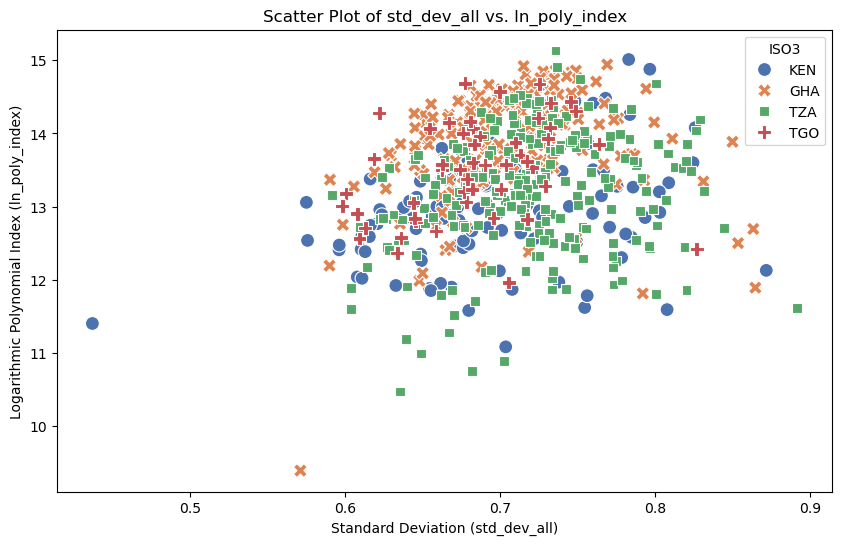

In [31]:
# plt.figure(figsize=(10, 6))
# sns.scatterplot(data=comparison_result, x='std_dev_al', y='ln_poly_index', hue='ISO3', style='ISO3', palette='deep', s=100)

# # Add title and labels
# plt.title('Scatter Plot of std_dev_all vs. ln_poly_index')
# plt.xlabel('Standard Deviation (std_dev_all)')
# plt.ylabel('Logarithmic Polynomial Index (ln_poly_index)')

# # Show the plot
# plt.legend(title='ISO3')
# plt.show()

## Week_8

In [139]:
# sd_results_KEN = gpd.read_file('C:/Users/Admin/Desktop/work for summer intern/KEN_sd_metrics/KEN_sd_index.shp')
# sd_results_GHA = gpd.read_file('C:/Users/Admin/Desktop/work for summer intern/GHA_sd_metrics/GHA_sd_index.shp')
# sd_results_TZA = gpd.read_file('C:/Users/Admin/Desktop/work for summer intern/TZA_sd_metrics/TZA_sd_index.shp')
# sd_results_TGO = gpd.read_file('C:/Users/Admin/Desktop/work for summer intern/TGO_sd_metrics/TGO_sd_index.shp')

combined_final_results_sd = pd.concat([sd_results_KEN, sd_results_GHA, sd_results_TZA, sd_results_TGO], ignore_index=True)

In [142]:
comparison_result = combined_final_results.merge(combined_final_results_sd, on=['agglosName', 'ISO3'], how='left')
comparison_result['ln_poly_index'] = np.log(comparison_result['poly_index'])

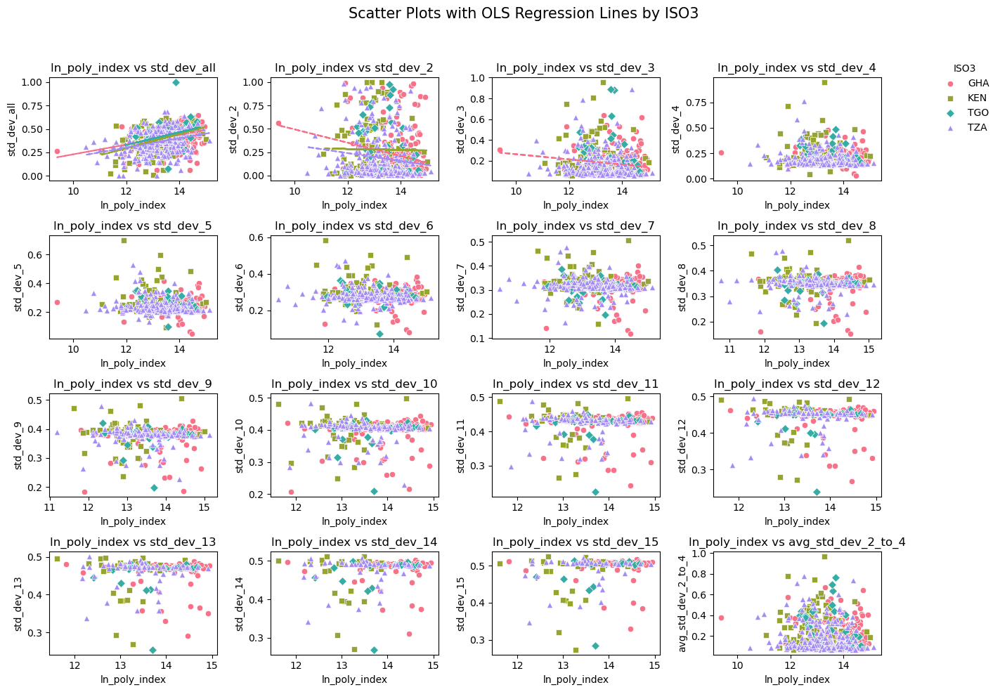

In [146]:
# Define color palette and markers
palette = sns.color_palette("husl", len(comparison_result['ISO3'].unique()))
markers = ['o', 's', 'D', '^', 'v', 'p']

# Plotting the pairplot with the specified layout
fig, axes = plt.subplots(4, 4, figsize=(15, 10))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Define the variables to plot
x_var = 'ln_poly_index'
y_vars = ['std_dev_all', 'std_dev_2', 'std_dev_3', 'std_dev_4', 'std_dev_5', 'std_dev_6', 'std_dev_7', 'std_dev_8', 'std_dev_9', 'std_dev_10', 'std_dev_11', 'std_dev_12', 'std_dev_13', 'std_dev_14', 'std_dev_15', 'avg_std_dev_2_to_4']

# Plot each pair in its respective subplot
for i, y_var in enumerate(y_vars):
    ax = axes[i]
    for j, (ios, group) in enumerate(comparison_result.groupby('ISO3')):
        sns.scatterplot(data=group, x=x_var, y=y_var, ax=ax, label=ios, color=palette[j], marker=markers[j])

        # Fit OLS
        X = sm.add_constant(group[x_var])
        model = sm.OLS(group[y_var], X).fit()
        ax.plot(group[x_var], model.fittedvalues, color=palette[j], linestyle='--')

    ax.set_title(f'{x_var} vs {y_var}')
    ax.legend_.remove()  # Remove the legend from individual subplots

# Add a single legend to the right
handles, labels = ax.get_legend_handles_labels()
fig.legend(handles, labels, loc='center right', title='ISO3', bbox_to_anchor=(0.95, 0.85), frameon=False)

# Set the overall title
fig.suptitle('Scatter Plots with OLS Regression Lines by ISO3', fontsize=15)

plt.tight_layout(rect=[0, 0, 0.85, 0.95])
plt.show()

In [155]:
comparison_result

,poly_index,agglosName,ISO3,geometry_x,std_dev_all,std_dev_2,std_dev_3,std_dev_4,std_dev_5,std_dev_6,std_dev_7,std_dev_8,std_dev_9,std_dev_10,std_dev_11,std_dev_12,std_dev_13,std_dev_14,std_dev_15,avg_std_dev_2_to_4,geometry_y,ln_poly_index
0,600284.24,Athi River,KEN,"POLYGON ((37.00165 -1.43661, 37.00194 -1.43685...",0.13,0.89,0.19,0.13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.40,"POLYGON ((37.00165 -1.43661, 37.00194 -1.43685...",13.31
1,698347.16,Bissil,KEN,"POLYGON ((36.78788 -2.09643, 36.78797 -2.09621...",0.53,0.13,0.16,0.22,0.27,0.31,0.34,0.38,0.40,0.43,0.45,0.47,0.48,0.50,0.51,0.17,"POLYGON ((36.78788 -2.09643, 36.78797 -2.09621...",13.46
2,1944239.12,Bomet,KEN,"MULTIPOLYGON (((35.04227 -0.88750, 35.04395 -0...",0.60,0.27,0.19,0.21,0.25,0.29,0.33,0.36,0.39,0.41,0.43,0.45,0.47,0.49,0.50,0.23,"MULTIPOLYGON (((35.04227 -0.88750, 35.04395 -0...",14.48
3,385063.60,Bondo,KEN,"POLYGON ((34.25142 -0.09458, 34.25073 -0.09382...",0.34,0.02,0.07,0.15,0.21,0.26,0.31,0.34,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.08,"POLYGON ((34.25142 -0.09458, 34.25073 -0.09382...",12.86
4,771960.55,Chuka,KEN,"MULTIPOLYGON (((37.60738 -0.34465, 37.60782 -0...",0.55,0.05,0.10,0.18,0.24,0.29,0.33,0.36,0.39,0.42,0.44,0.46,0.48,0.50,0.51,0.11,"MULTIPOLYGON (((37.60738 -0.34465, 37.60782 -0...",13.56
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
593,728192.76,Togoville,TGO,"POLYGON ((1.47717 6.24243, 1.47747 6.24235, 1....",0.43,0.06,0.10,0.17,0.22,0.27,0.32,0.35,0.38,0.41,0.43,NaN,NaN,NaN,NaN,0.11,"POLYGON ((1.47717 6.24243, 1.47747 6.24235, 1....",13.50
594,467137.64,Tohoun,TGO,"POLYGON ((1.61092 7.00680, 1.61050 7.00796, 1....",0.46,0.09,0.13,0.18,0.24,0.28,0.32,0.36,0.39,0.41,0.44,0.46,NaN,NaN,NaN,0.14,"POLYGON ((1.61092 7.00680, 1.61050 7.00796, 1....",13.05
595,786482.02,Tsevie,TGO,"POLYGON ((1.20681 6.31245, 1.20584 6.31367, 1....",0.07,0.98,0.89,0.22,0.10,0.07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.70,"POLYGON ((1.20681 6.31245, 1.20584 6.31367, 1....",13.58
596,587388.05,Vogan,TGO,"POLYGON ((1.54138 6.32962, 1.54138 6.32973, 1....",0.47,0.06,0.10,0.17,0.23,0.28,0.32,0.35,0.38,0.41,0.43,0.46,0.47,NaN,NaN,0.11,"POLYGON ((1.54138 6.32962, 1.54138 6.32973, 1....",13.28


In [153]:
comparison_result.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 598 entries, 0 to 597
Data columns (total 22 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              --------------  -----   
 0   poly_index          598 non-null    float64 
 1   agglosName          598 non-null    object  
 2   ISO3                598 non-null    object  
 3   geometry_x          598 non-null    geometry
 4   std_dev_all         598 non-null    float64 
 5   std_dev_2           597 non-null    float64 
 6   std_dev_3           592 non-null    float64 
 7   std_dev_4           579 non-null    float64 
 8   std_dev_5           556 non-null    float64 
 9   std_dev_6           524 non-null    float64 
 10  std_dev_7           479 non-null    float64 
 11  std_dev_8           428 non-null    float64 
 12  std_dev_9           378 non-null    float64 
 13  std_dev_10          347 non-null    float64 
 14  std_dev_11          297 non-null    float64 
 15  std_dev_12          262 non-null    floa

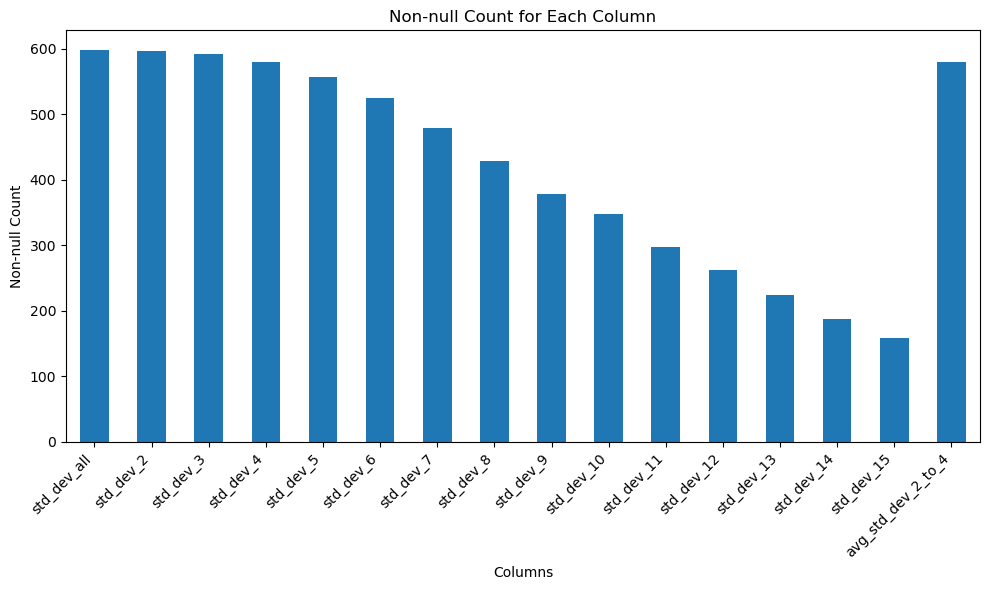

In [152]:
# Count non-null values for the specified columns
columns_of_interest = [
    'std_dev_all', 'std_dev_2', 'std_dev_3', 'std_dev_4', 'std_dev_5', 
    'std_dev_6', 'std_dev_7', 'std_dev_8', 'std_dev_9', 'std_dev_10', 
    'std_dev_11', 'std_dev_12', 'std_dev_13', 'std_dev_14', 'std_dev_15', 
    'avg_std_dev_2_to_4'
]

non_null_counts = comparison_result[columns_of_interest].notnull().sum()

# Plot the non-null counts
plt.figure(figsize=(10, 6))
non_null_counts.plot(kind='bar')
plt.xlabel('Columns')
plt.ylabel('Non-null Count')
plt.title('Non-null Count for Each Column')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

plt.show()

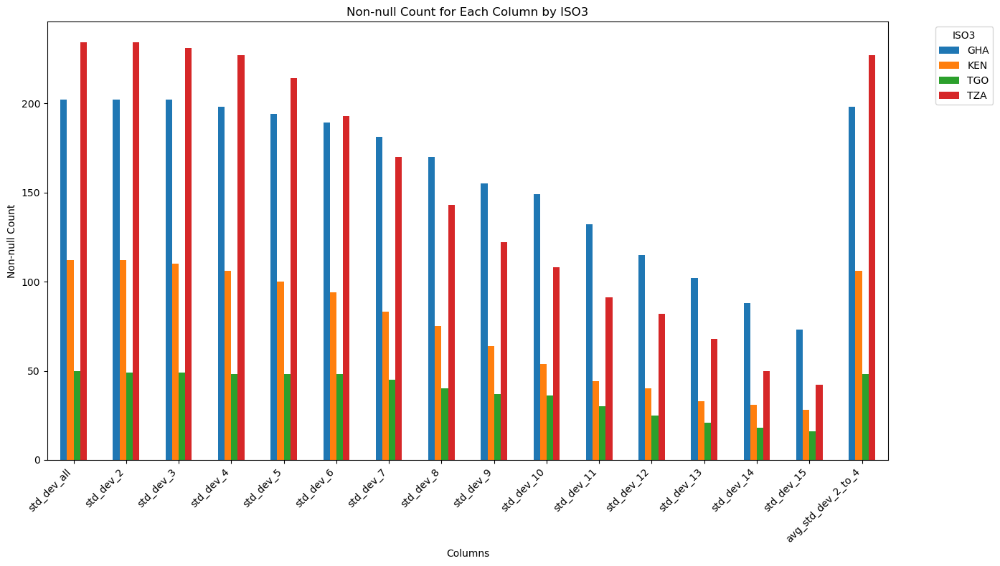

In [154]:
non_null_counts_by_iso3 = comparison_result.groupby('ISO3')[columns_of_interest].apply(lambda x: x.notnull().sum()).T

# Plot the non-null counts by ISO3
fig, ax = plt.subplots(figsize=(14, 8))
non_null_counts_by_iso3.plot(kind='bar', ax=ax)

plt.xlabel('Columns')
plt.ylabel('Non-null Count')
plt.title('Non-null Count for Each Column by ISO3')
plt.xticks(rotation=45, ha='right')
plt.legend(title='ISO3', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

plt.show()

In [160]:
comparison_result_plot = comparison_result.merge(filtered_combined_africa, on=['agglosName', 'ISO3'], how='left')
comparison_result_plot['ln_Pop_2015'] = np.log(comparison_result_plot['Pop2015'])
comparison_result_plot['ln_NBuildings'] = np.log(comparison_result_plot['NBuildings'])

In [171]:
comparison_result_plot[['std_dev_all','avg_std_dev_2_to_4','ln_NBuildings','ln_Pop_2015','Elongation','Sprawl','Green_spac','PM2.5_2020']].describe()

,std_dev_all,avg_std_dev_2_to_4,ln_NBuildings,ln_Pop_2015,Elongation,Sprawl,Green_spac,PM2.5_2020
count,598.00,579.00,534.00,598.00,534.00,534.00,534.00,534.00
mean,0.39,0.20,9.37,10.33,7.75,1.01,0.44,24.22
std,0.13,0.15,1.21,1.07,3.11,0.53,0.22,5.36
min,0.00,0.07,7.61,9.21,3.57,0.38,0.02,14.63
25%,0.31,0.09,8.54,9.56,5.46,0.63,0.28,20.42
50%,0.41,0.14,9.07,10.03,6.82,0.85,0.42,23.40
75%,0.49,0.27,9.80,10.70,9.02,1.16,0.58,27.32
max,1.00,0.97,14.88,15.59,20.00,2.88,0.97,46.74


In [173]:
df_cleaned = comparison_result_plot.dropna(subset=['std_dev_all', 'avg_std_dev_2_to_4', 'ln_NBuildings', 'ln_Pop_2015', 'Elongation', 'Sprawl', 'Green_spac', 'PM2.5_2020'])

In [175]:
df_cleaned[['std_dev_all','avg_std_dev_2_to_4','ln_NBuildings','ln_Pop_2015','Elongation','Sprawl','Green_spac','PM2.5_2020']].describe()

,std_dev_all,avg_std_dev_2_to_4,ln_NBuildings,ln_Pop_2015,Elongation,Sprawl,Green_spac,PM2.5_2020
count,521.00,521.00,521.00,521.00,521.00,521.00,521.00,521.00
mean,0.40,0.19,9.34,10.30,7.69,1.01,0.44,24.21
std,0.12,0.14,1.18,1.04,3.09,0.53,0.22,5.31
min,0.05,0.07,7.61,9.21,3.57,0.38,0.02,14.63
25%,0.31,0.09,8.54,9.56,5.44,0.63,0.28,20.42
50%,0.41,0.13,9.05,10.02,6.78,0.84,0.42,23.36
75%,0.49,0.24,9.75,10.66,8.99,1.16,0.58,27.32
max,0.68,0.77,14.88,15.59,20.00,2.88,0.97,44.14


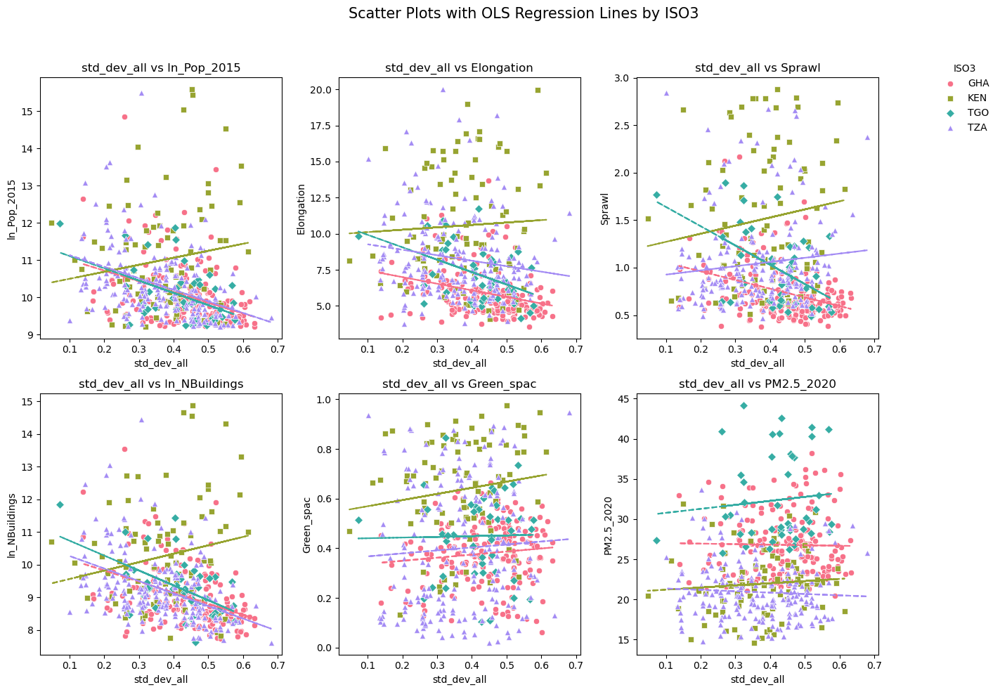

In [176]:
# Define color palette and markers
palette = sns.color_palette("husl", len(df_cleaned['ISO3'].unique()))
markers = ['o', 's', 'D', '^', 'v', 'p']

# Plotting the pairplot with the specified layout
fig, axes = plt.subplots(2, 3, figsize=(15, 10))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Define the variables to plot
x_var = 'std_dev_all'
y_vars = ['ln_Pop_2015', 'Elongation', 'Sprawl', 'ln_NBuildings', 'Green_spac', 'PM2.5_2020']

# Plot each pair in its respective subplot
for i, y_var in enumerate(y_vars):
    ax = axes[i]
    for j, (ios, group) in enumerate(df_cleaned.groupby('ISO3')):
        sns.scatterplot(data=group, x=x_var, y=y_var, ax=ax, label=ios, color=palette[j], marker=markers[j])

        # Fit OLS
        X = sm.add_constant(group[x_var])
        model = sm.OLS(group[y_var], X).fit()
        ax.plot(group[x_var], model.fittedvalues, color=palette[j], linestyle='--')

    ax.set_title(f'{x_var} vs {y_var}')
    ax.legend_.remove()  # Remove the legend from individual subplots

# Add a single legend to the right
handles, labels = ax.get_legend_handles_labels()
fig.legend(handles, labels, loc='center right', title='ISO3', bbox_to_anchor=(0.95, 0.85), frameon=False)

# Set the overall title
fig.suptitle('Scatter Plots with OLS Regression Lines by ISO3', fontsize=15)

plt.tight_layout(rect=[0, 0, 0.85, 0.95])
plt.show()

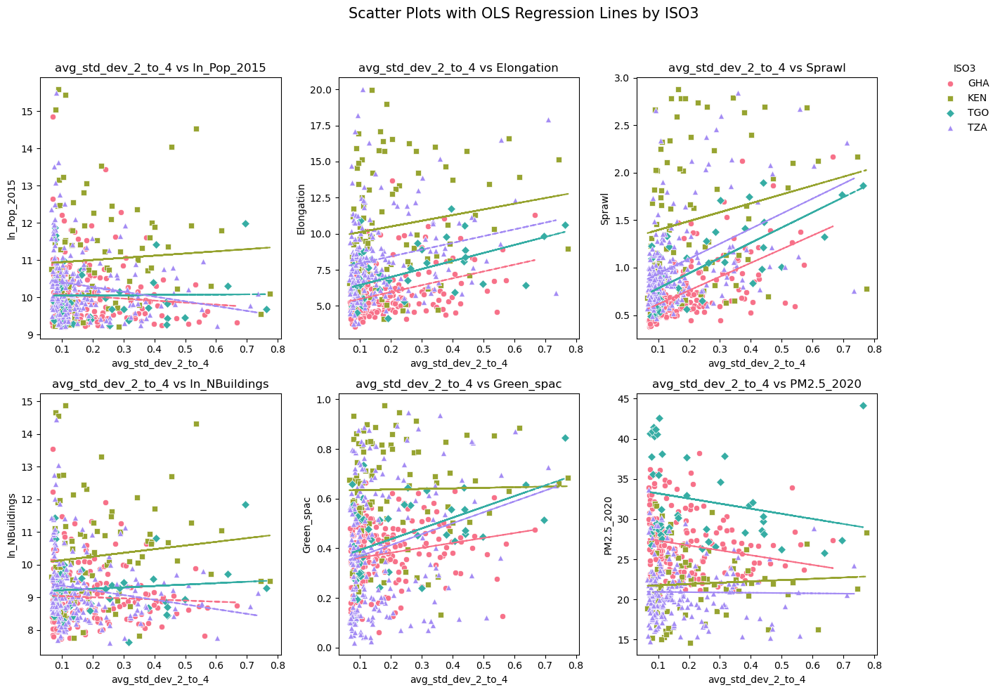

In [177]:
# Define color palette and markers
palette = sns.color_palette("husl", len(df_cleaned['ISO3'].unique()))
markers = ['o', 's', 'D', '^', 'v', 'p']

# Plotting the pairplot with the specified layout
fig, axes = plt.subplots(2, 3, figsize=(15, 10))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Define the variables to plot
x_var = 'avg_std_dev_2_to_4'
y_vars = ['ln_Pop_2015', 'Elongation', 'Sprawl', 'ln_NBuildings', 'Green_spac', 'PM2.5_2020']

# Plot each pair in its respective subplot
for i, y_var in enumerate(y_vars):
    ax = axes[i]
    for j, (ios, group) in enumerate(df_cleaned.groupby('ISO3')):
        sns.scatterplot(data=group, x=x_var, y=y_var, ax=ax, label=ios, color=palette[j], marker=markers[j])

        # Fit OLS
        X = sm.add_constant(group[x_var])
        model = sm.OLS(group[y_var], X).fit()
        ax.plot(group[x_var], model.fittedvalues, color=palette[j], linestyle='--')

    ax.set_title(f'{x_var} vs {y_var}')
    ax.legend_.remove()  # Remove the legend from individual subplots

# Add a single legend to the right
handles, labels = ax.get_legend_handles_labels()
fig.legend(handles, labels, loc='center right', title='ISO3', bbox_to_anchor=(0.95, 0.85), frameon=False)

# Set the overall title
fig.suptitle('Scatter Plots with OLS Regression Lines by ISO3', fontsize=15)

plt.tight_layout(rect=[0, 0, 0.85, 0.95])
plt.show()